# Importing Libraries

In [0]:
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from tensorflow.keras import optimizers, regularizers
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, Dropout
from sklearn.preprocessing import MinMaxScaler

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Importing Data Set

In [0]:
dataset = pd.read_csv('/content/drive/My Drive/Specialization/Projects/Recurrent Neural Networks/M5 - Data/sales_train_validation.csv')

In [0]:
dataset.shape

(30490, 1919)

In [0]:
dataset.head()

,id,item_id,dept_id,cat_id,store_id,state_id,d_1,d_2,d_3,d_4,d_5,d_6,d_7,d_8,d_9,d_10,d_11,d_12,d_13,d_14,d_15,d_16,d_17,d_18,d_19,d_20,d_21,d_22,d_23,d_24,d_25,d_26,d_27,d_28,d_29,d_30,d_31,d_32,d_33,d_34,...,d_1874,d_1875,d_1876,d_1877,d_1878,d_1879,d_1880,d_1881,d_1882,d_1883,d_1884,d_1885,d_1886,d_1887,d_1888,d_1889,d_1890,d_1891,d_1892,d_1893,d_1894,d_1895,d_1896,d_1897,d_1898,d_1899,d_1900,d_1901,d_1902,d_1903,d_1904,d_1905,d_1906,d_1907,d_1908,d_1909,d_1910,d_1911,d_1912,d_1913
0,HOBBIES_1_001_CA_1_validation,HOBBIES_1_001,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,1,1,3,1,3,1,2,2,0,1,1,1,1,0,0,0,0,0,1,0,4,2,3,0,1,2,0,0,0,1,1,3,0,1,1,1,3,0,1,1
1,HOBBIES_1_002_CA_1_validation,HOBBIES_1_002,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
2,HOBBIES_1_003_CA_1_validation,HOBBIES_1_003,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,1,2,2,1,2,1,1,1,0,1,1,1
3,HOBBIES_1_004_CA_1_validation,HOBBIES_1_004,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,1,3,4,2,1,4,1,3,5,0,6,6,0,0,0,0,3,1,2,1,3,1,0,2,5,4,2,0,3,0,1,0,5,4,1,0,1,3,7,2
4,HOBBIES_1_005_CA_1_validation,HOBBIES_1_005,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,1,0,3,2,2,2,3,1,0,0,0,0,1,0,4,4,0,1,4,0,1,0,1,0,1,1,2,0,1,1,2,1,1,0,1,1,2,2,2,4


In [0]:
dataset.loc[:,'d_1':].shape

(30490, 1913)

# In this Notebook I'll try to crate N LSTM models to predict a Food product from one store.


In [0]:
dataset.groupby(['state_id','cat_id']).first()

id  ... d_1913
state_id cat_id                                      ...       
CA       FOODS          FOODS_1_001_CA_1_validation  ...      0
         HOBBIES      HOBBIES_1_001_CA_1_validation  ...      1
         HOUSEHOLD  HOUSEHOLD_1_001_CA_1_validation  ...      1
TX       FOODS          FOODS_1_001_TX_1_validation  ...      0
         HOBBIES      HOBBIES_1_001_TX_1_validation  ...      2
         HOUSEHOLD  HOUSEHOLD_1_001_TX_1_validation  ...      0
WI       FOODS          FOODS_1_001_WI_1_validation  ...      1
         HOBBIES      HOBBIES_1_001_WI_1_validation  ...      1
         HOUSEHOLD  HOUSEHOLD_1_001_WI_1_validation  ...      0

[9 rows x 1917 columns]

In [0]:
group = dataset.groupby(['state_id','cat_id']).first()
df_food =  group.loc[('WI','FOODS'),'d_1':]
del group

# Spliting Data

In [0]:
train_limit = int(round((df_food.shape[0])*0.7,0))
val_limit = int(round((df_food.shape[0])*0.85,0))

df_food_train = df_food[:train_limit]
df_food_val = df_food[train_limit:val_limit]
df_food_test = df_food[val_limit:]

print(df_food_test.shape)

(287,)


# Normalizing Data


In [0]:
df_food_train = df_food_train.values.reshape(-1,1)
df_food_val = df_food_val.values.reshape(-1,1)
df_food_test = df_food_test.values.reshape(-1,1)

print(df_food_train.shape)
print(df_food_val.shape)
print(df_food_test.shape)

(1339, 1)
(287, 1)
(287, 1)


In [0]:
scaler_food = MinMaxScaler(feature_range=(0,1))
df_food_train = scaler_food.fit_transform(df_food_train)
df_food_val = scaler_food.transform(df_food_val)
df_food_test = scaler_food.transform(df_food_test)

# Regressor

- # The competition determines that the model predict 28 days in the future, so we need to scale the regressor and the outputs for this prerequisite.

- # The step time for each LTMS can be different, so lets start with the Hobbies data



In [0]:
def Regressor(future_steps,time_steps,n_features,df_train,df_val,df_test):
  # future_steps: how many days in the furure to predict 
  # time_steps: number of samples the LSTM model will use for predict 28 days in the future
  # n_features: number of features (LSTM input) 

  #################### TRAIN #################################################
  # Defining the number of samples for the train data
  n_samples = df_train.shape[0]
  x_train = []
  y_train = []

  # shaping data to have the number of time_steps in the x_train ans the 28 future values in the y_train 
  for i in range(time_steps,n_samples - time_steps): 
    x_train.append(df_train[i - time_steps : i, 0])
    y_train.append(df_train[i : i+future_steps,0])

  x_train,y_train = np.array(x_train),np.array(y_train) # transforming in array
  # LSTM need 3D tensor as input 
  x_train = np.reshape(x_train,(x_train.shape[0],x_train.shape[1],n_features))  

  ##################### VALIDATION ###############################################

  # to predict the first 28 values of the validation data, LSTM need time_steps values. 
  # to make this possible I'm using the last 60 values that came before the validation data.
  df_val = np.concatenate((df_train[-time_steps:],df_val))

  n_samples = df_val.shape[0]
  x_val = []
  y_val = []

  for i in range(time_steps,n_samples - time_steps):
    x_val.append(df_val[i - time_steps : i, 0])
    y_val.append(df_val[i : i+future_steps,0])

  x_val,y_val = np.array(x_val),np.array(y_val)
  x_val = np.reshape(x_val,(x_val.shape[0],x_val.shape[1],n_features))

  ####################### TEST ################################################
  # the same methodologie implemented in training and validation data are here in the test data

  df_test = np.concatenate((df_val[-time_steps:],df_test))
  n_samples = df_test.shape[0]
  x_test = []
  y_test = []

  for i in range(time_steps,n_samples - time_steps):
    x_test.append(df_test[i - time_steps : i, 0])
    y_test.append(df_test[i : i+future_steps,0])

  x_test,y_test = np.array(x_test),np.array(y_test)
  x_test = np.reshape(x_test,(x_test.shape[0],x_test.shape[1],n_features))
  
  return x_train,x_test,x_val,y_train,y_val,y_test

In [0]:
time_steps = 60
future_steps = 28
n_features = 1
x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = time_steps,n_features = n_features,df_train = df_food_train,df_val = df_food_val,df_test = df_food_test)

# LSTM (Hobbies)

## First try

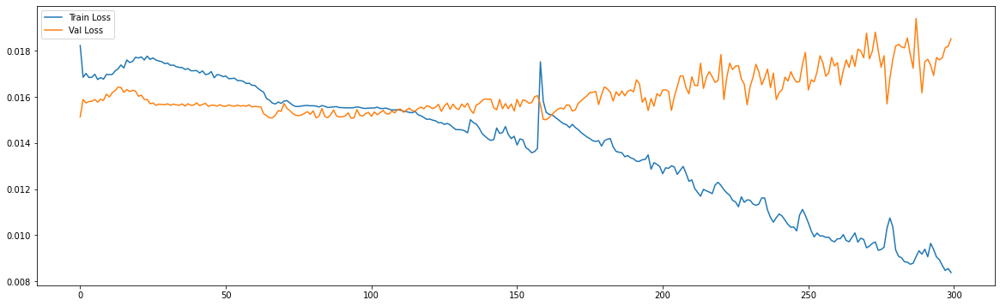

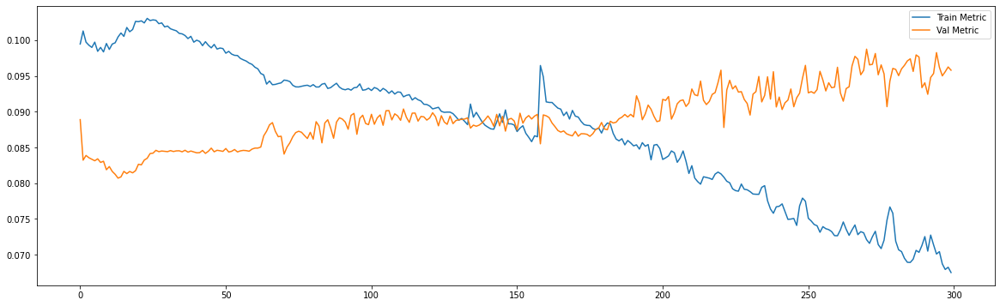



39/39 [==============================] - 0s 3ms/step - loss: 0.0093 - mae: 0.0695
loss and metric train data [0.00925059337168932, 0.06948351860046387]
8/8 [==============================] - 0s 3ms/step - loss: 0.0185 - mae: 0.0958
loss and metric val data [0.018525054678320885, 0.09579873085021973]
8/8 [==============================] - 0s 3ms/step - loss: 0.0146 - mae: 0.0843
loss and metric test data [0.014590805396437645, 0.08432743698358536]


In [0]:
# The LSTM architecture

regressor = Sequential()
regressor.add(LSTM(units=50, return_sequences=False, input_shape=(time_steps, n_features))) # return_sequences=False next layer is not LSTM
regressor.add(Dense(units=28))

#Compiling the LSTM
adam = optimizers.Adam(lr = 0.01, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
regressor.compile(optimizer = adam, loss = 'mse', metrics=['mae'])

#Fitting to traning set
history = regressor.fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 300, batch_size=32, verbose = 0, shuffle= False)

plt.figure(figsize=(20,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['Train Loss', 'Val Loss'])

plt.figure(figsize=(20,6))
plt.plot(history.history['mae'])
plt.plot(history.history['val_mae'])
plt.legend(['Train Metric', 'Val Metric'])
plt.show()

print('\n')
print('loss and metric train data',regressor.evaluate(x_train,y_train))
print('loss and metric val data',regressor.evaluate(x_val,y_val))
print('loss and metric test data',regressor.evaluate(x_test,y_test))

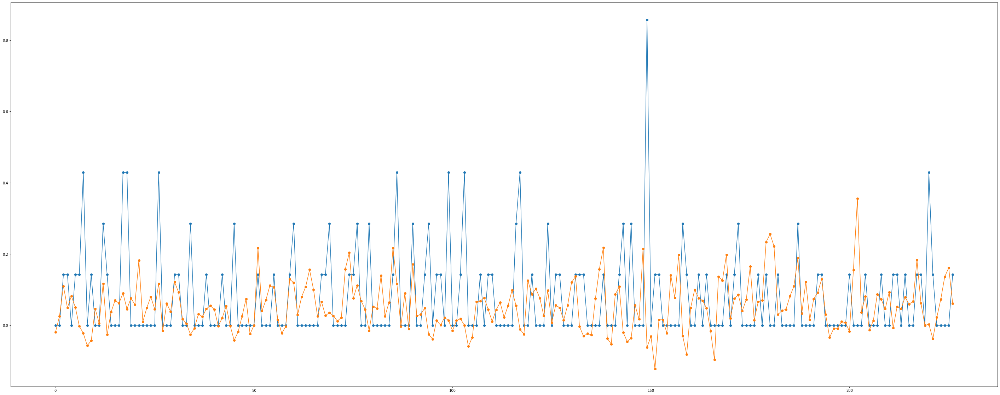

In [0]:
y_val_pred = regressor.predict(x_val)
plt.figure(figsize=(50,20))
plt.plot(y_val[:,0],marker='o')
plt.plot(y_val_pred[:,0],marker='o')
plt.show()

### Dropout

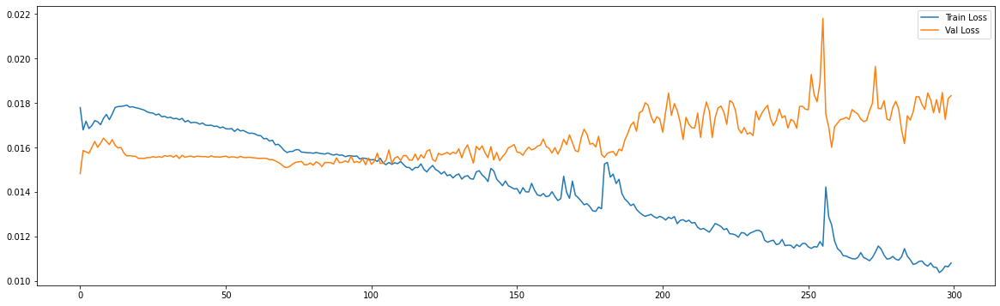

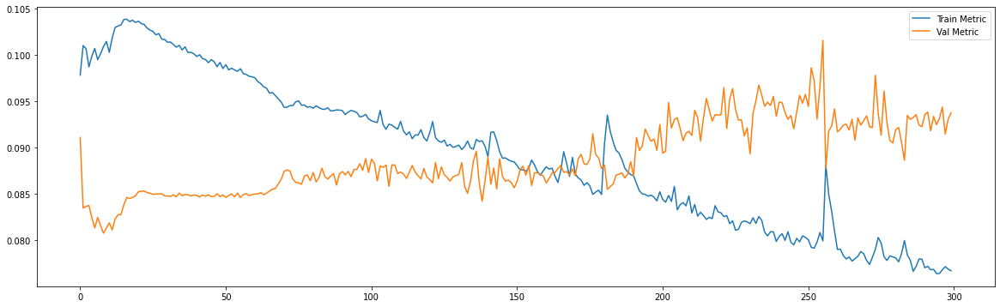



39/39 [==============================] - 0s 6ms/step - loss: 0.0110 - mae: 0.0739
loss and metric train data [0.0109751271083951, 0.07386992126703262]
8/8 [==============================] - 0s 5ms/step - loss: 0.0183 - mae: 0.0938
loss and metric val data [0.018324853852391243, 0.09375736862421036]
8/8 [==============================] - 0s 5ms/step - loss: 0.0125 - mae: 0.0790
loss and metric test data [0.012527236714959145, 0.07902709394693375]


In [0]:
# The LSTM architecture
regressor = Sequential()
regressor.add(LSTM(units=50, return_sequences=False, input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
regressor.add(Dropout(0.2))
regressor.add(Dense(units=28))

#Compiling the LSTM
adam = optimizers.Adam(lr = 0.01, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
regressor.compile(optimizer = adam, loss = 'mse', metrics=['mae'])

#Fitting to traning set
history = regressor.fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 300, batch_size=32, verbose = 0, shuffle= False)

plt.figure(figsize=(20,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['Train Loss', 'Val Loss'])

plt.figure(figsize=(20,6))
plt.plot(history.history['mae'])
plt.plot(history.history['val_mae'])
plt.legend(['Train Metric', 'Val Metric'])
plt.show()

print('\n')
print('loss and metric train data',regressor.evaluate(x_train,y_train))
print('loss and metric val data',regressor.evaluate(x_val,y_val))
print('loss and metric test data',regressor.evaluate(x_test,y_test))

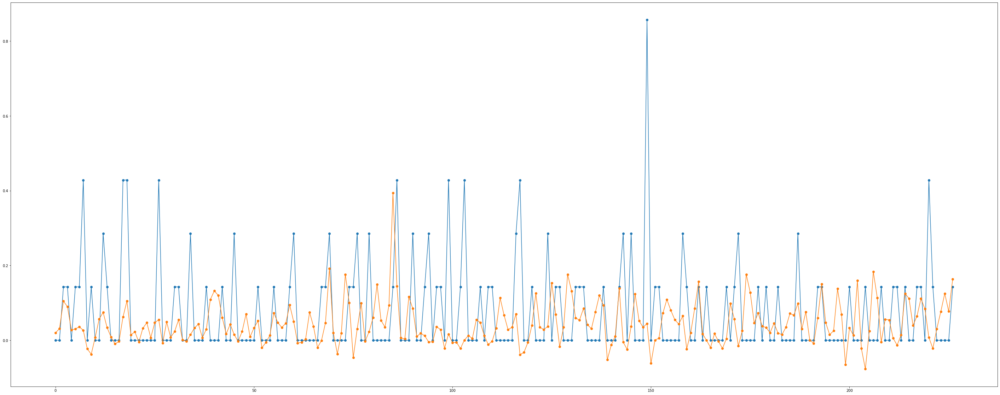

In [0]:
y_val_pred = regressor.predict(x_val)
plt.figure(figsize=(50,20))
plt.plot(y_val[:,0],marker='o')
plt.plot(y_val_pred[:,0],marker='o')
plt.show()

### Increasing Dropout

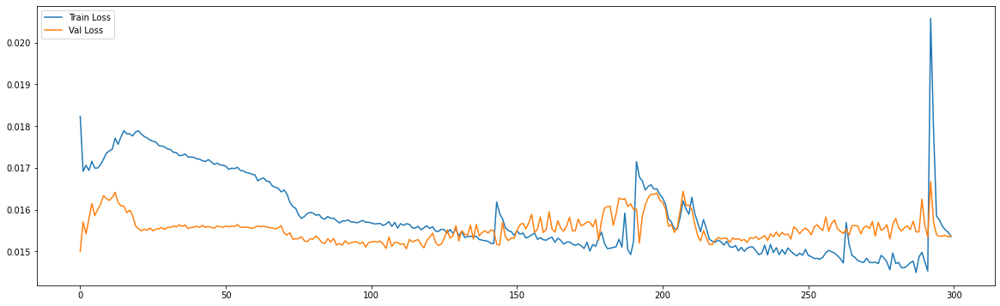

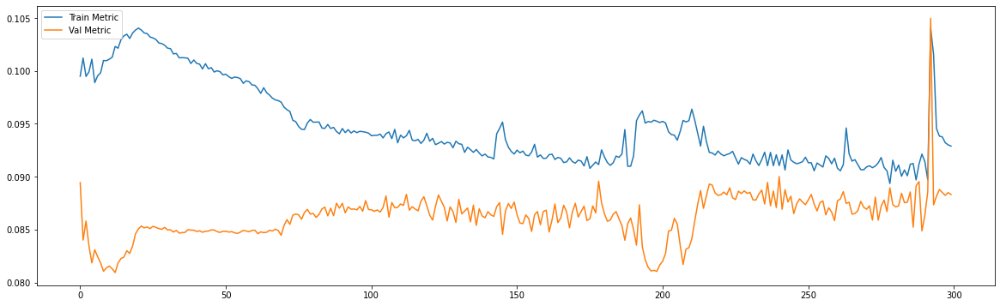



39/39 [==============================] - 0s 6ms/step - loss: 0.0155 - mae: 0.0861
loss and metric train data [0.015503003261983395, 0.08611197024583817]
8/8 [==============================] - 0s 5ms/step - loss: 0.0154 - mae: 0.0883
loss and metric val data [0.01537875272333622, 0.0883193090558052]
8/8 [==============================] - 0s 5ms/step - loss: 0.0109 - mae: 0.0746
loss and metric test data [0.010926605202257633, 0.0745825245976448]


In [0]:
# The LSTM architecture
regressor = Sequential()
regressor.add(LSTM(units=50, return_sequences=False, input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
regressor.add(Dropout(0.4))
regressor.add(Dense(units=28))

#Compiling the LSTM
adam = optimizers.Adam(lr = 0.01, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
regressor.compile(optimizer = adam, loss = 'mse', metrics=['mae'])

#Fitting to traning set
history = regressor.fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 300, batch_size=32, verbose = 0, shuffle= False)

plt.figure(figsize=(20,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['Train Loss', 'Val Loss'])

plt.figure(figsize=(20,6))
plt.plot(history.history['mae'])
plt.plot(history.history['val_mae'])
plt.legend(['Train Metric', 'Val Metric'])
plt.show()

print('\n')
print('loss and metric train data',regressor.evaluate(x_train,y_train))
print('loss and metric val data',regressor.evaluate(x_val,y_val))
print('loss and metric test data',regressor.evaluate(x_test,y_test))

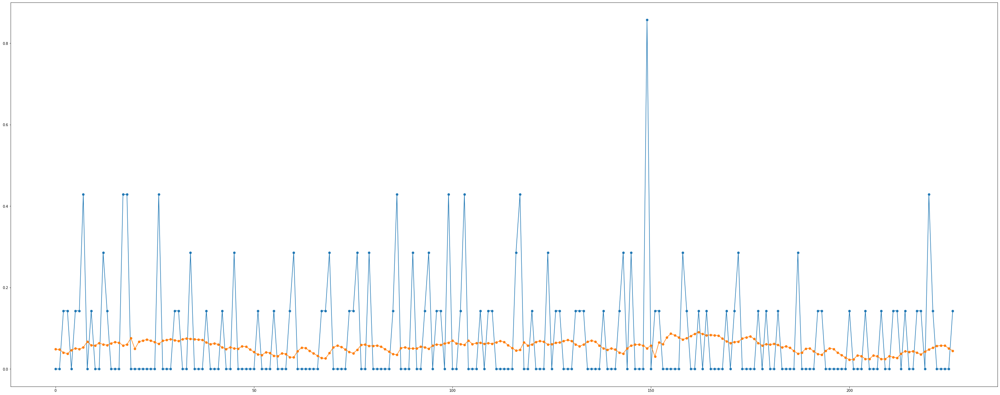

In [0]:
y_val_pred = regressor.predict(x_val)
plt.figure(figsize=(50,20))
plt.plot(y_val[:,0],marker='o')
plt.plot(y_val_pred[:,0],marker='o')
plt.show()

### L2 regilarization with dropout

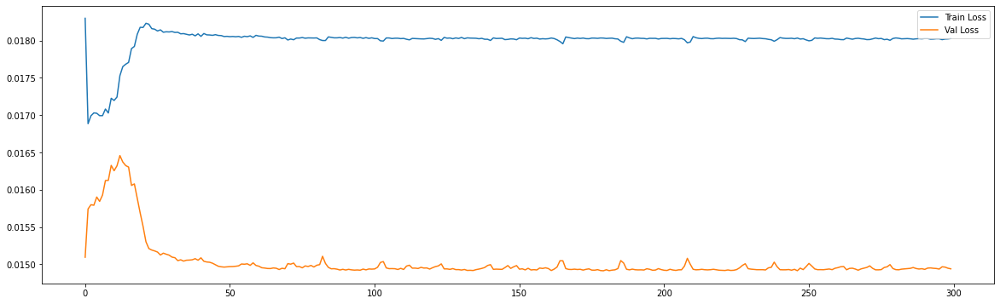

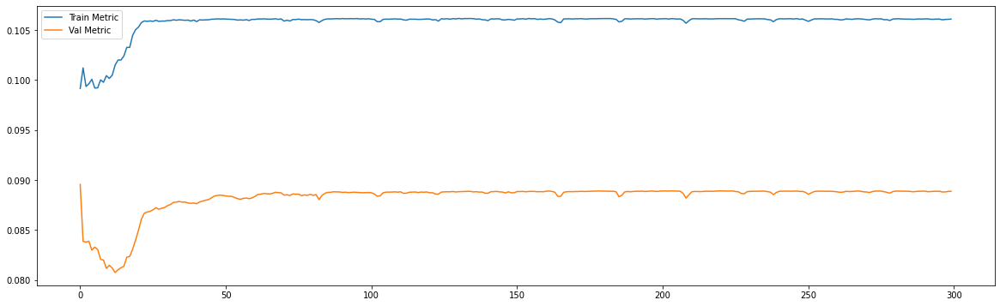



39/39 [==============================] - 0s 6ms/step - loss: 0.0173 - mae: 0.0966
loss and metric train data [0.017337189987301826, 0.09656085073947906]
8/8 [==============================] - 0s 5ms/step - loss: 0.0149 - mae: 0.0889
loss and metric val data [0.014940510503947735, 0.0888901948928833]
8/8 [==============================] - 0s 5ms/step - loss: 0.0105 - mae: 0.0810
loss and metric test data [0.010526145808398724, 0.08098049461841583]


In [0]:
# The LSTM architecture
regressor = Sequential()
regressor.add(LSTM(units=50, return_sequences=False,kernel_regularizer=regularizers.l2(0.0001), input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
regressor.add(Dropout(0.2))
regressor.add(Dense(units=28))

#Compiling the LSTM
adam = optimizers.Adam(lr = 0.01, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
regressor.compile(optimizer = adam, loss = 'mse', metrics=['mae'])

#Fitting to traning set
history = regressor.fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 300, batch_size=32, verbose = 0, shuffle= False)

plt.figure(figsize=(20,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['Train Loss', 'Val Loss'])

plt.figure(figsize=(20,6))
plt.plot(history.history['mae'])
plt.plot(history.history['val_mae'])
plt.legend(['Train Metric', 'Val Metric'])
plt.show()

print('\n')
print('loss and metric train data',regressor.evaluate(x_train,y_train))
print('loss and metric val data',regressor.evaluate(x_val,y_val))
print('loss and metric test data',regressor.evaluate(x_test,y_test))

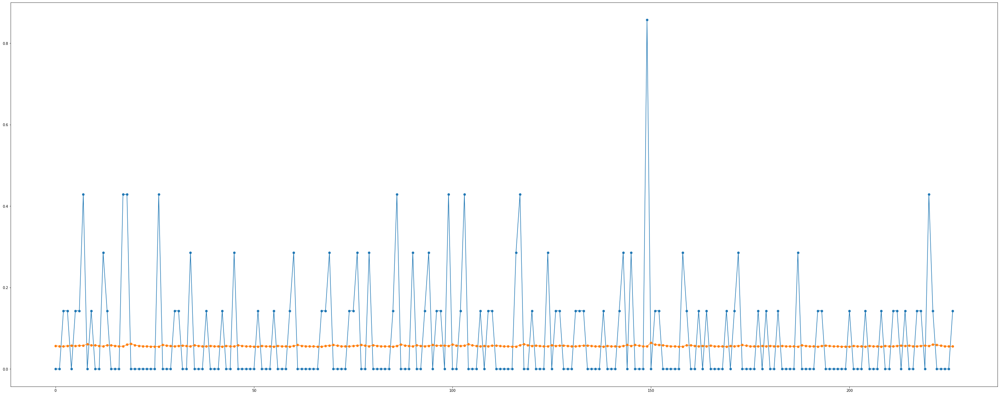

In [0]:
y_val_pred = regressor.predict(x_val)
plt.figure(figsize=(50,20))
plt.plot(y_val[:,0],marker='o')
plt.plot(y_val_pred[:,0],marker='o')
plt.show()

## Simplifying the model

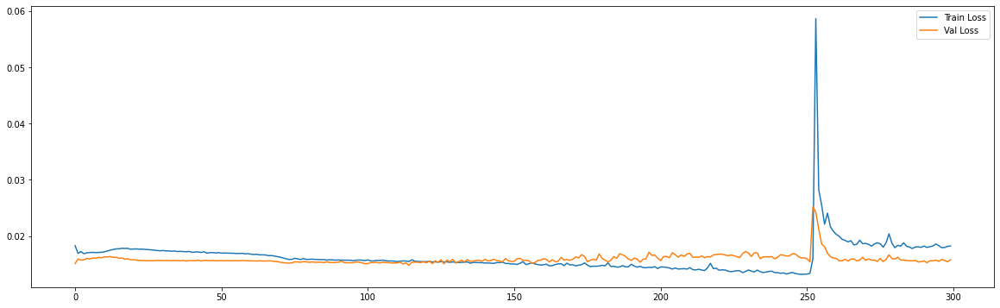

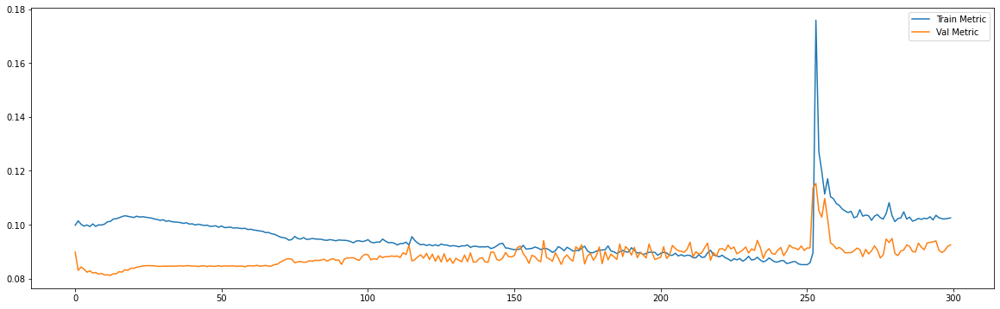



39/39 [==============================] - 0s 6ms/step - loss: 0.0183 - mae: 0.1021
loss and metric train data [0.0183482114225626, 0.10211453586816788]
8/8 [==============================] - 0s 5ms/step - loss: 0.0158 - mae: 0.0925
loss and metric val data [0.015778923407197, 0.09249251335859299]
8/8 [==============================] - 0s 5ms/step - loss: 0.0120 - mae: 0.0869
loss and metric test data [0.011962125077843666, 0.0868549570441246]


In [0]:
# The LSTM architecture
regressor = Sequential()
regressor.add(LSTM(units=40, return_sequences=False, input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
regressor.add(Dropout(0.2))
regressor.add(Dense(units=28))

#Compiling the LSTM
adam = optimizers.Adam(lr = 0.01, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
regressor.compile(optimizer = adam, loss = 'mse', metrics=['mae'])

#Fitting to traning set
history = regressor.fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 300, batch_size=32, verbose = 0, shuffle= False)

plt.figure(figsize=(20,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['Train Loss', 'Val Loss'])

plt.figure(figsize=(20,6))
plt.plot(history.history['mae'])
plt.plot(history.history['val_mae'])
plt.legend(['Train Metric', 'Val Metric'])
plt.show()

print('\n')
print('loss and metric train data',regressor.evaluate(x_train,y_train))
print('loss and metric val data',regressor.evaluate(x_val,y_val))
print('loss and metric test data',regressor.evaluate(x_test,y_test))

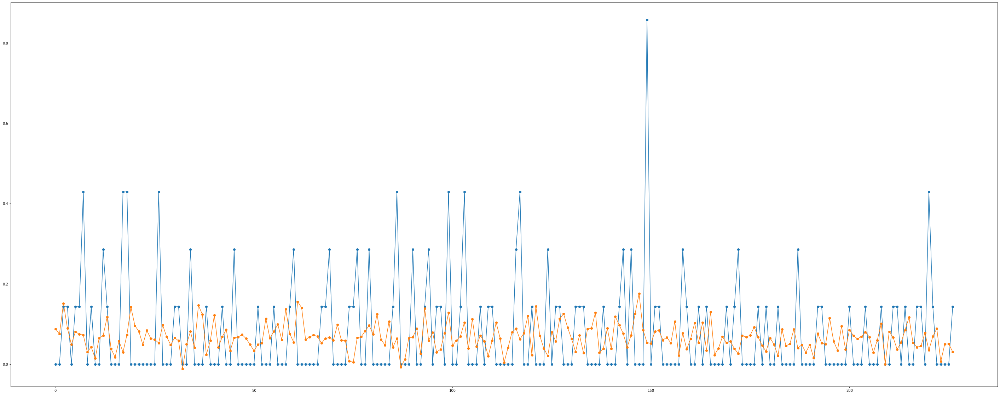

In [0]:
y_val_pred = regressor.predict(x_val)
plt.figure(figsize=(50,20))
plt.plot(y_val[:,0],marker='o')
plt.plot(y_val_pred[:,0],marker='o')
plt.show()

### Increasing the dropout

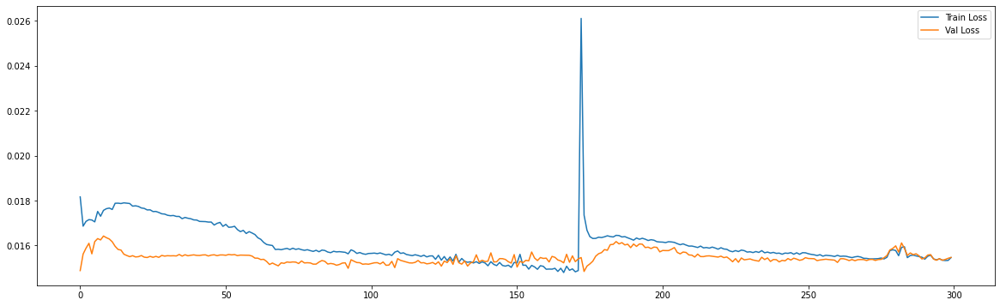

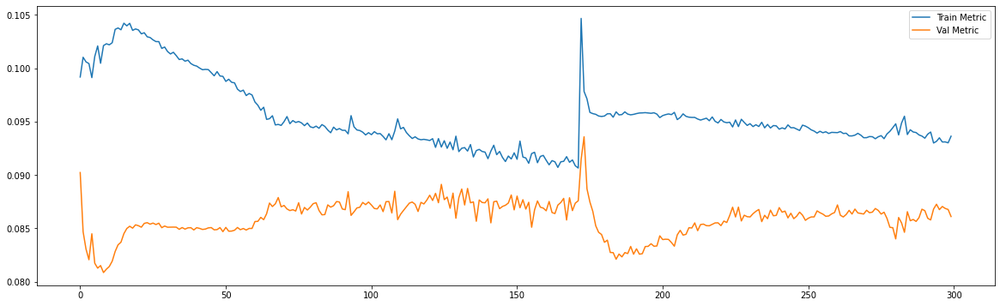



39/39 [==============================] - 0s 5ms/step - loss: 0.0153 - mae: 0.0891
loss and metric train data [0.015282109379768372, 0.0890686959028244]
8/8 [==============================] - 0s 5ms/step - loss: 0.0155 - mae: 0.0861
loss and metric val data [0.015471805818378925, 0.0860992968082428]
8/8 [==============================] - 0s 5ms/step - loss: 0.0109 - mae: 0.0763
loss and metric test data [0.010867218486964703, 0.07630681991577148]


In [0]:
# The LSTM architecture
regressor = Sequential()
regressor.add(LSTM(units=40, return_sequences=False, input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
regressor.add(Dropout(0.4))
regressor.add(Dense(units=28))

#Compiling the LSTM
adam = optimizers.Adam(lr = 0.01, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
regressor.compile(optimizer = adam, loss = 'mse', metrics=['mae'])

#Fitting to traning set
history = regressor.fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 300, batch_size=32, verbose = 0, shuffle= False)

plt.figure(figsize=(20,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['Train Loss', 'Val Loss'])

plt.figure(figsize=(20,6))
plt.plot(history.history['mae'])
plt.plot(history.history['val_mae'])
plt.legend(['Train Metric', 'Val Metric'])
plt.show()

print('\n')
print('loss and metric train data',regressor.evaluate(x_train,y_train))
print('loss and metric val data',regressor.evaluate(x_val,y_val))
print('loss and metric test data',regressor.evaluate(x_test,y_test))

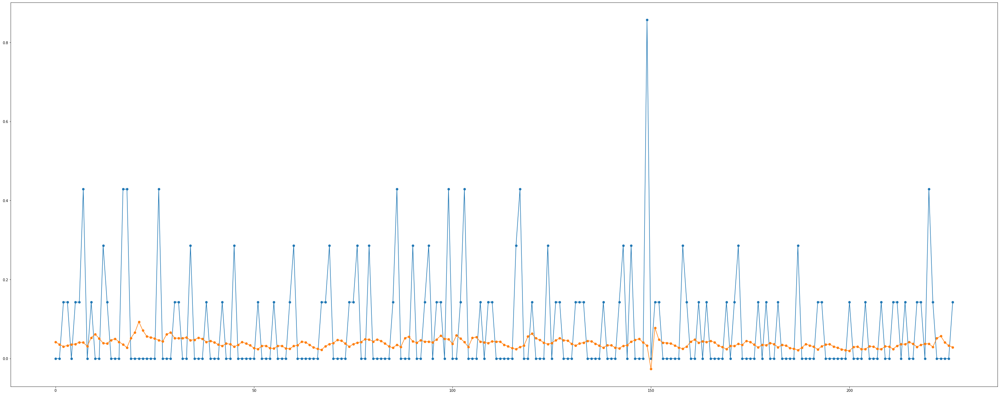

In [0]:
y_val_pred = regressor.predict(x_val)
plt.figure(figsize=(50,20))
plt.plot(y_val[:,0],marker='o')
plt.plot(y_val_pred[:,0],marker='o')
plt.show()

## Last chance... 

Let's try to decrease de leraning rate, with differents numbers of neurons, topologies, time_steps ans batch sizes

============================model:0===========================
39/39 [==============================] - 0s 2ms/step - loss: 0.0140 - mae: 0.0869
loss and metric train data [0.014046262949705124, 0.08689998090267181]
8/8 [==============================] - 0s 2ms/step - loss: 0.0148 - mae: 0.0907
loss and metric val data [0.014816655777394772, 0.09074965119361877]
8/8 [==============================] - 0s 2ms/step - loss: 0.0109 - mae: 0.0805
loss and metric test data [0.01091650128364563, 0.0804629996418953]


'neurons': 20, 'dropout': 0.0, 'time_steps': 50, 'batch_size':32, 'learning_rate':0.001, 'hidden_layers':1




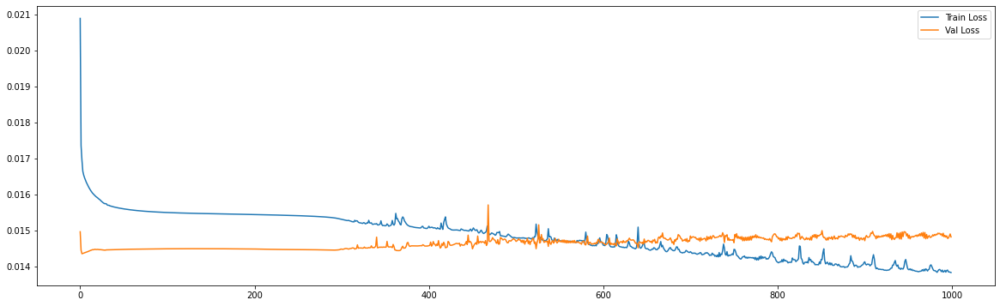

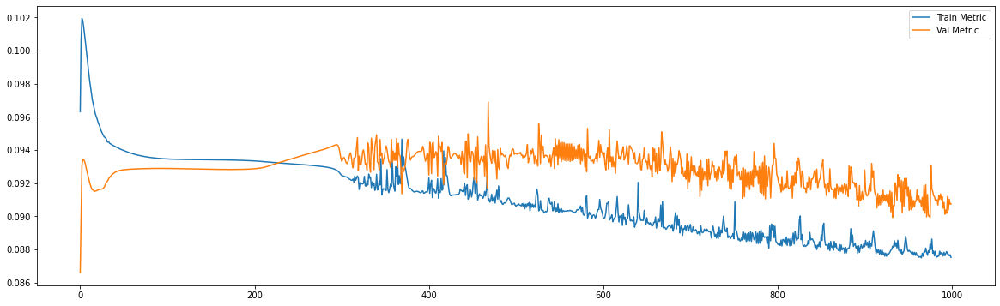

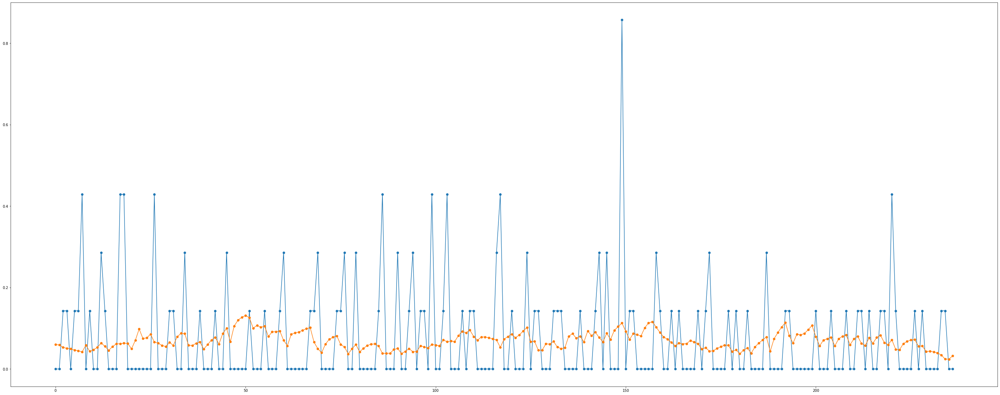

============================model:1===========================
39/39 [==============================] - 0s 4ms/step - loss: 0.0118 - mae: 0.0798
loss and metric train data [0.011804223991930485, 0.07980223000049591]
8/8 [==============================] - 0s 3ms/step - loss: 0.0160 - mae: 0.0933
loss and metric val data [0.01595284417271614, 0.09334208816289902]
8/8 [==============================] - 0s 3ms/step - loss: 0.0130 - mae: 0.0865
loss and metric test data [0.013039403595030308, 0.08650454133749008]


'neurons': 20, 'dropout': 0.0, 'time_steps': 50, 'batch_size':32, 'hidden_layers':2




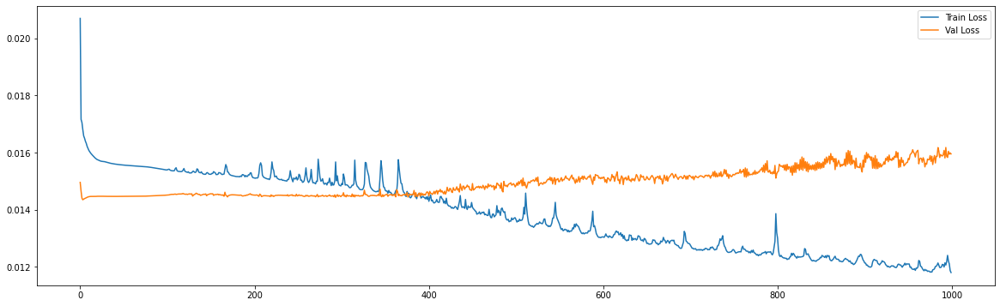

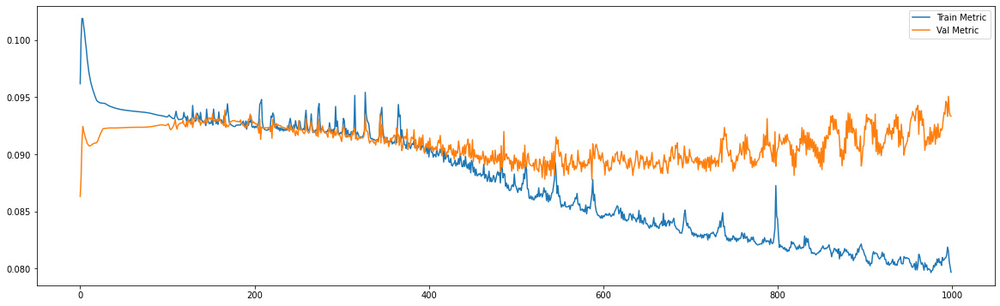

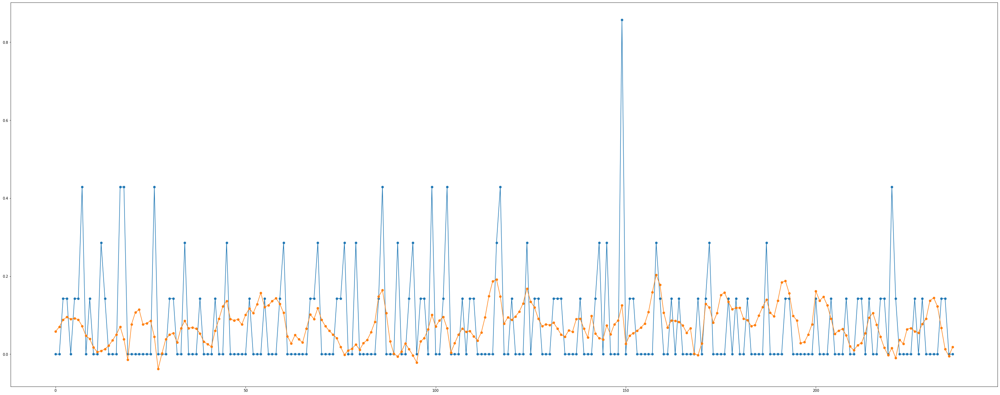

============================model:2===========================
39/39 [==============================] - 0s 3ms/step - loss: 0.0155 - mae: 0.0934
loss and metric train data [0.015453069470822811, 0.09336476027965546]
8/8 [==============================] - 0s 2ms/step - loss: 0.0145 - mae: 0.0934
loss and metric val data [0.014457467012107372, 0.09338051080703735]
8/8 [==============================] - 0s 2ms/step - loss: 0.0107 - mae: 0.0834
loss and metric test data [0.010665928944945335, 0.08335693180561066]


'neurons': 20, 'dropout': 0.0, 'time_steps': 50, 'batch_size':32, 'learning_rate':0.0001, 'hidden_layers':1




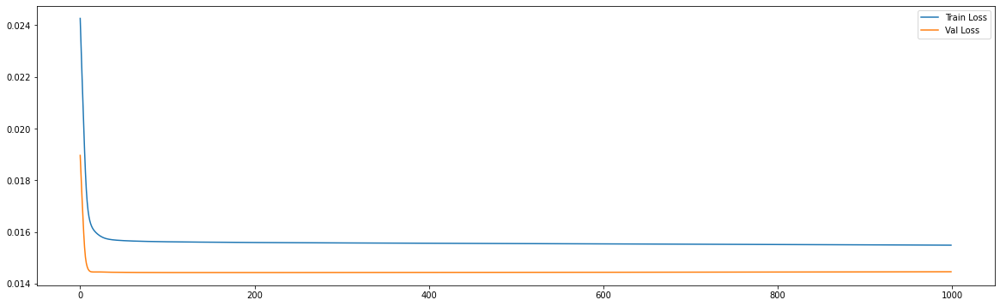

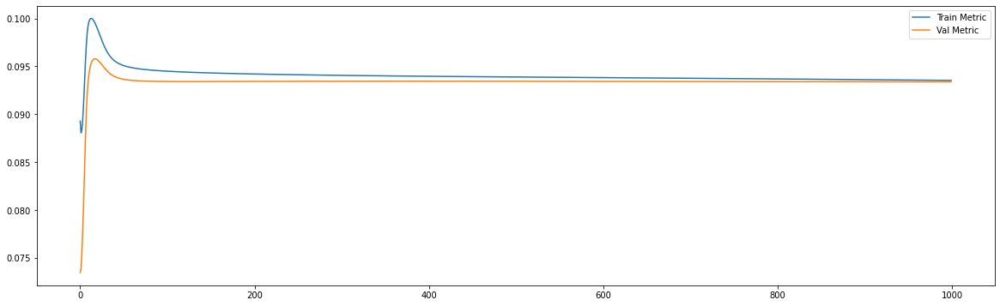

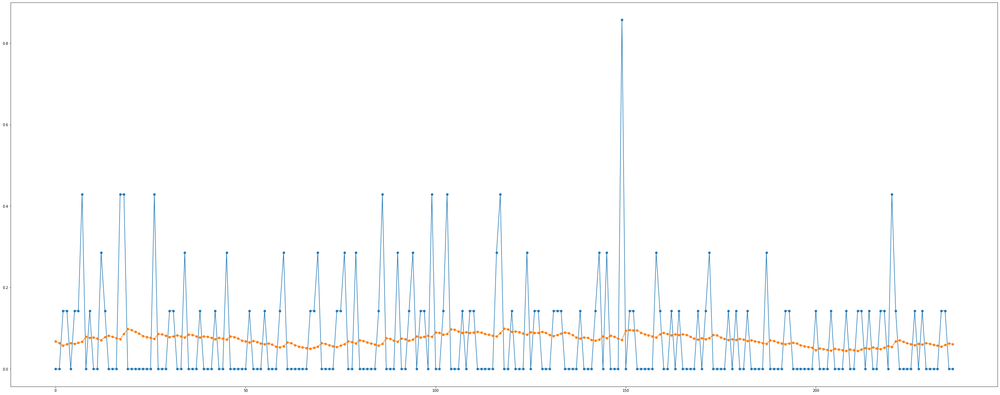

============================model:3===========================
39/39 [==============================] - 0s 3ms/step - loss: 0.0154 - mae: 0.0930
loss and metric train data [0.01539880782365799, 0.09301447868347168]
8/8 [==============================] - 0s 3ms/step - loss: 0.0145 - mae: 0.0930
loss and metric val data [0.014459154568612576, 0.09301506727933884]
8/8 [==============================] - 0s 3ms/step - loss: 0.0107 - mae: 0.0833
loss and metric test data [0.010664111003279686, 0.08332674205303192]


'neurons': 20, 'dropout': 0.0, 'time_steps': 50, 'batch_size':32, 'hidden_layers':2




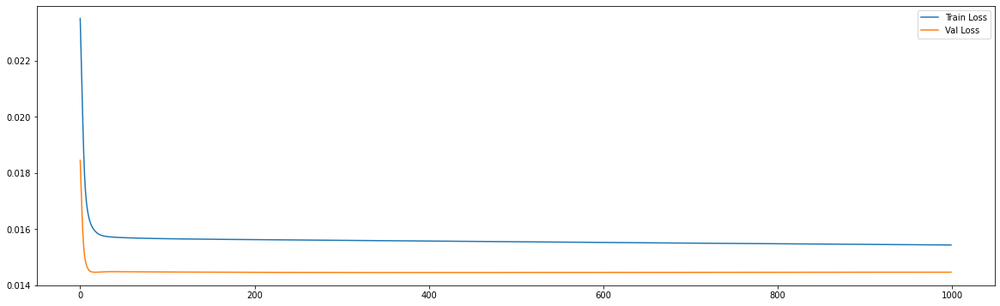

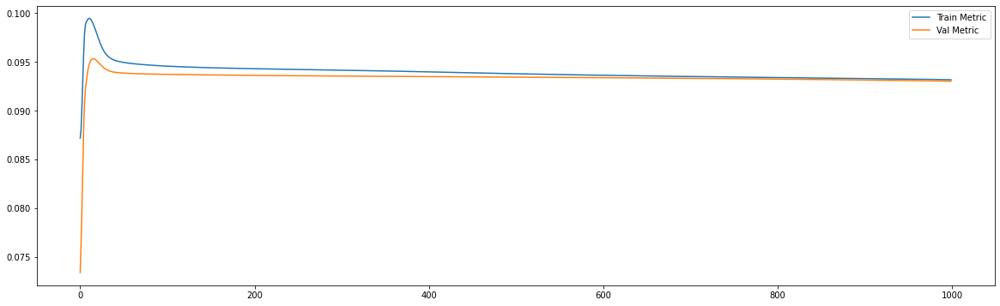

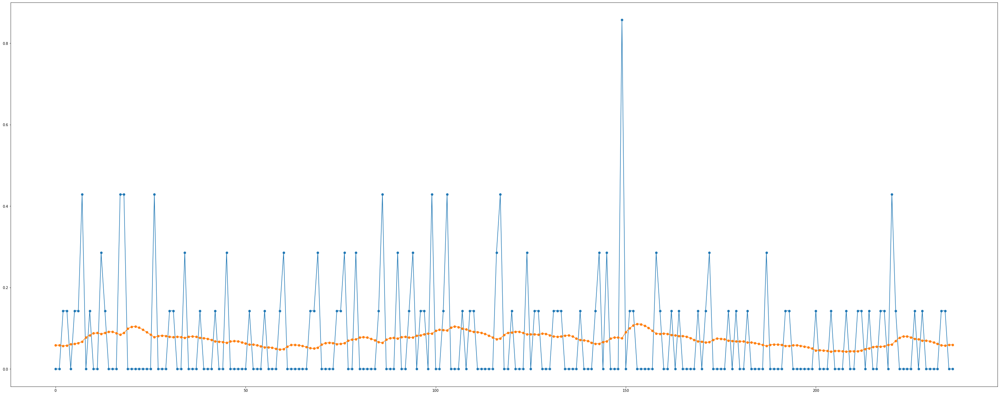

============================model:4===========================
39/39 [==============================] - 0s 3ms/step - loss: 0.0147 - mae: 0.0895
loss and metric train data [0.014703265391290188, 0.08947442471981049]
8/8 [==============================] - 0s 3ms/step - loss: 0.0146 - mae: 0.0922
loss and metric val data [0.014592975378036499, 0.09215185046195984]
8/8 [==============================] - 0s 2ms/step - loss: 0.0106 - mae: 0.0808
loss and metric test data [0.01059334073215723, 0.08081287890672684]


'neurons': 20, 'dropout': 0.0, 'time_steps': 50, 'batch_size':50, 'learning_rate':0.001, 'hidden_layers':1




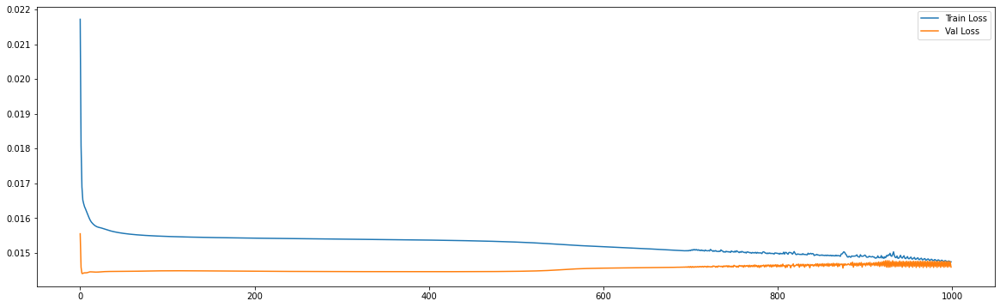

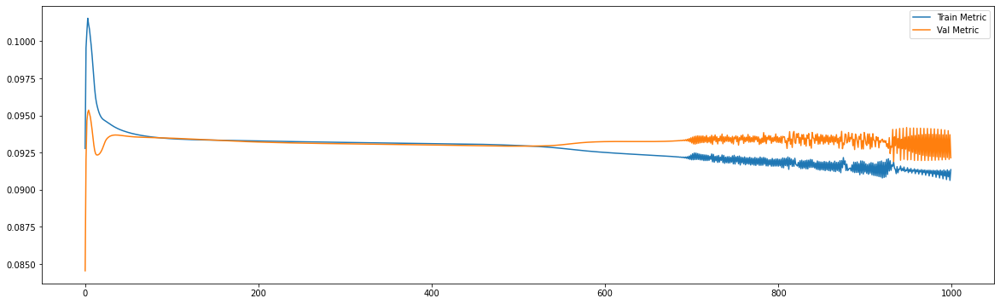

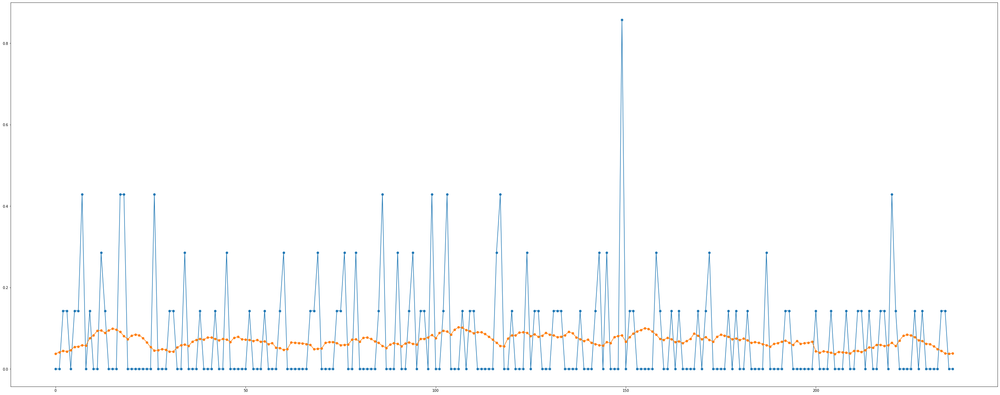

============================model:5===========================
39/39 [==============================] - 0s 3ms/step - loss: 0.0125 - mae: 0.0828
loss and metric train data [0.012524743564426899, 0.0827830508351326]
8/8 [==============================] - 0s 4ms/step - loss: 0.0158 - mae: 0.0936
loss and metric val data [0.015838807448744774, 0.09364340454339981]
8/8 [==============================] - 0s 3ms/step - loss: 0.0125 - mae: 0.0827
loss and metric test data [0.012478814460337162, 0.0827309638261795]


'neurons': 20, 'dropout': 0.0, 'time_steps': 50, 'batch_size':50, 'hidden_layers':2




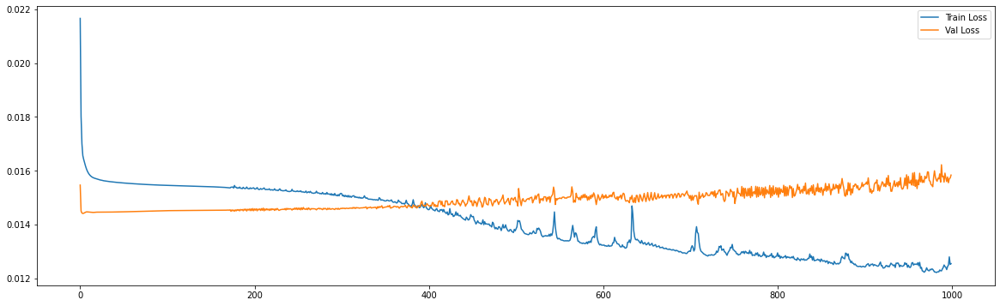

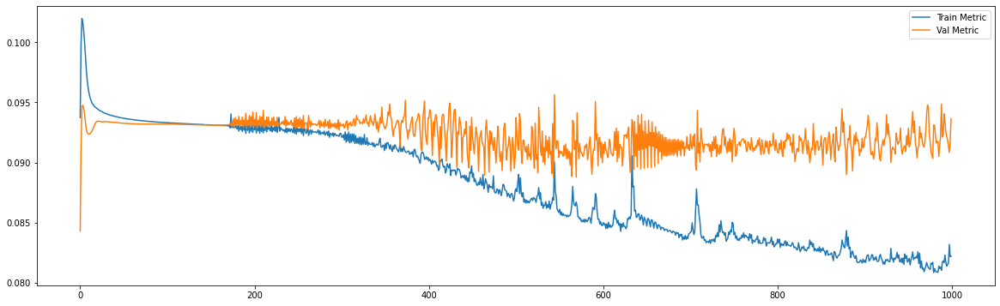

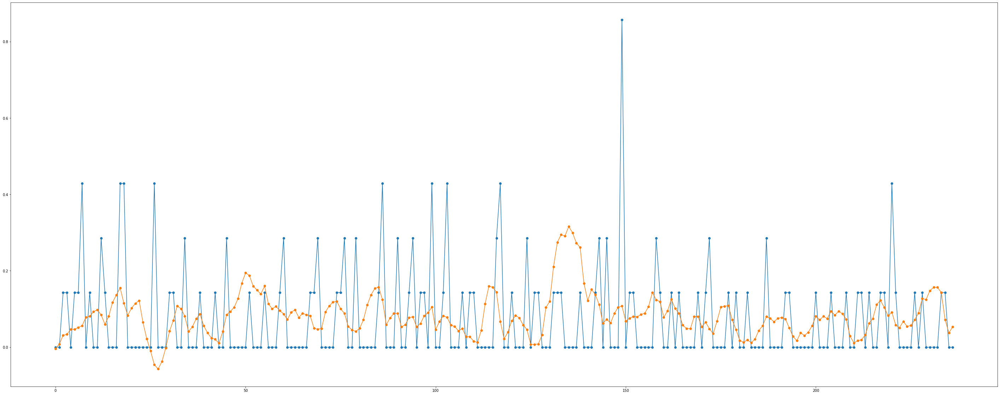

============================model:6===========================
39/39 [==============================] - 0s 2ms/step - loss: 0.0154 - mae: 0.0933
loss and metric train data [0.015402929857373238, 0.09327345341444016]
8/8 [==============================] - 0s 4ms/step - loss: 0.0145 - mae: 0.0936
loss and metric val data [0.014470435678958893, 0.09363210201263428]
8/8 [==============================] - 0s 2ms/step - loss: 0.0107 - mae: 0.0836
loss and metric test data [0.010690954513847828, 0.08359931409358978]


'neurons': 20, 'dropout': 0.0, 'time_steps': 50, 'batch_size':50, 'learning_rate':0.0001, 'hidden_layers':1




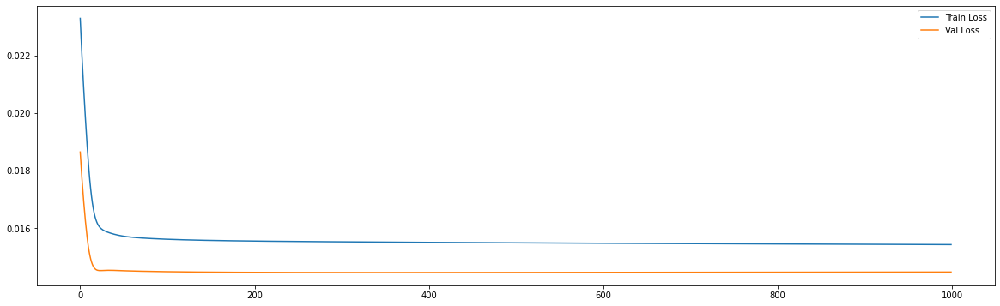

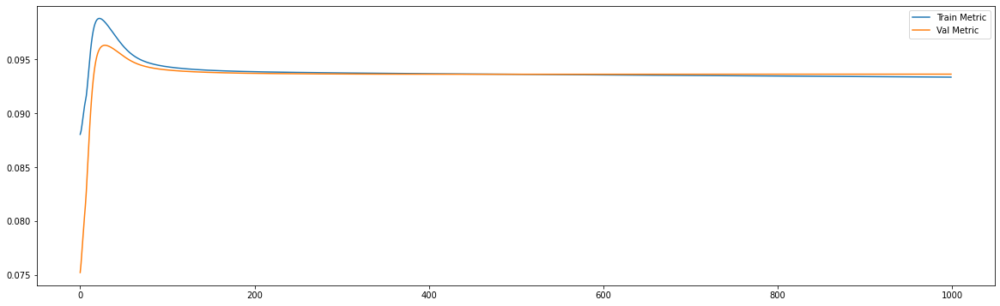

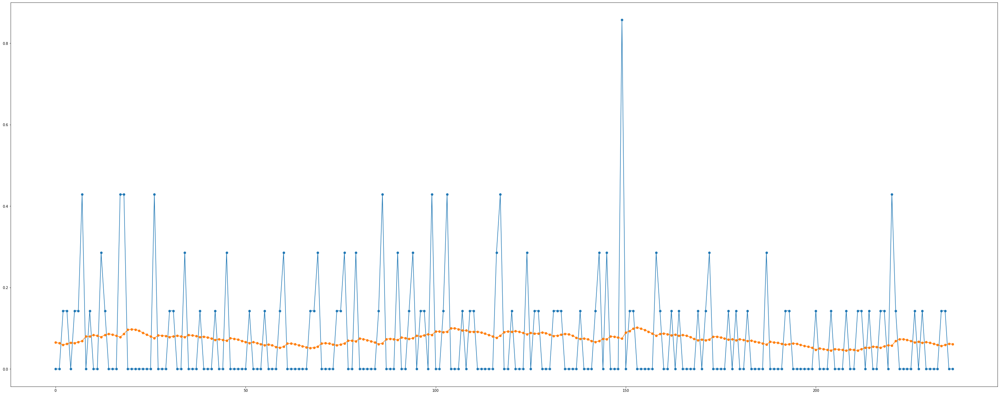

============================model:7===========================
39/39 [==============================] - 0s 4ms/step - loss: 0.0154 - mae: 0.0931
loss and metric train data [0.015397540293633938, 0.09306993335485458]
8/8 [==============================] - 0s 3ms/step - loss: 0.0145 - mae: 0.0936
loss and metric val data [0.01447849627584219, 0.09364171326160431]
8/8 [==============================] - 0s 3ms/step - loss: 0.0107 - mae: 0.0838
loss and metric test data [0.010711908340454102, 0.08377454429864883]


'neurons': 20, 'dropout': 0.0, 'time_steps': 50, 'batch_size':50, 'hidden_layers':2




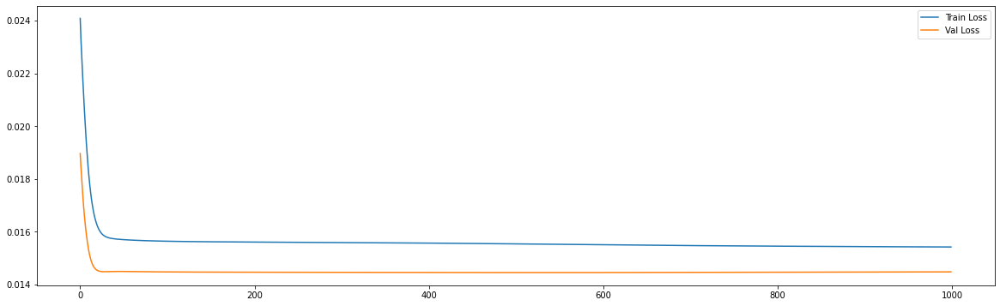

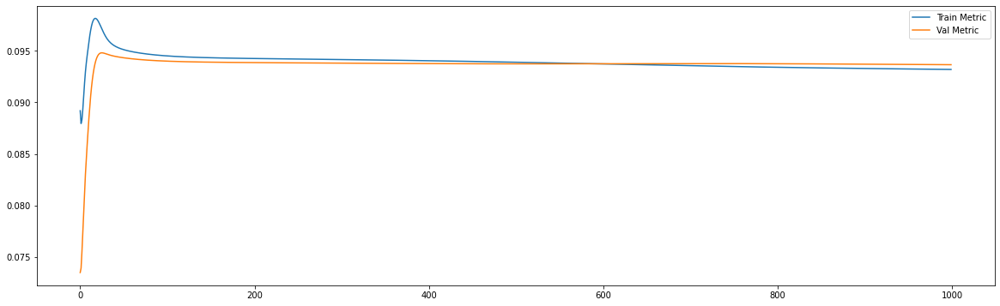

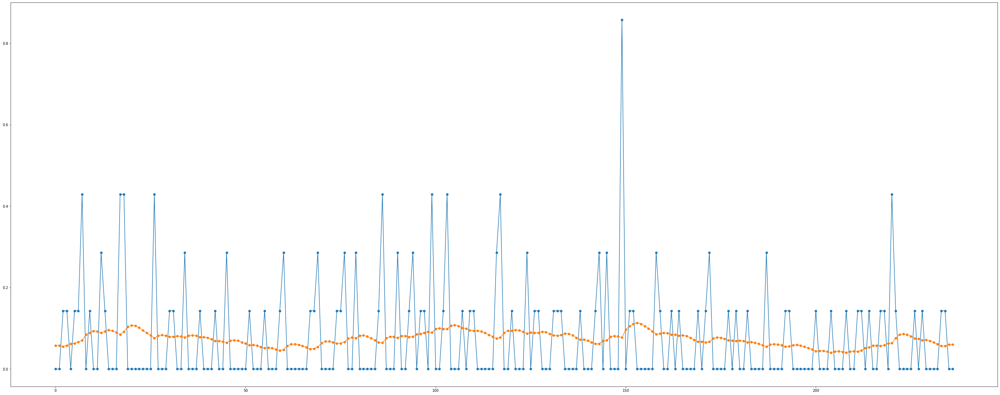

============================model:8===========================
39/39 [==============================] - 0s 2ms/step - loss: 0.0144 - mae: 0.0895
loss and metric train data [0.014429094269871712, 0.08947394043207169]
8/8 [==============================] - 0s 2ms/step - loss: 0.0146 - mae: 0.0926
loss and metric val data [0.014558084309101105, 0.09257754683494568]
8/8 [==============================] - 0s 2ms/step - loss: 0.0106 - mae: 0.0831
loss and metric test data [0.01059812679886818, 0.08307448029518127]


'neurons': 20, 'dropout': 0.0, 'time_steps': 50, 'batch_size':60, 'learning_rate':0.001, 'hidden_layers':1




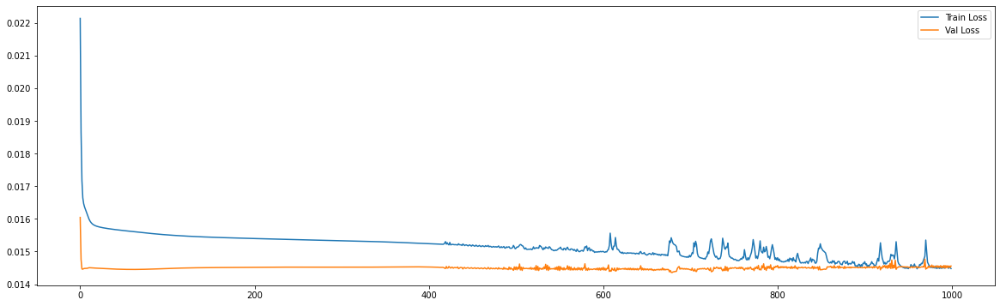

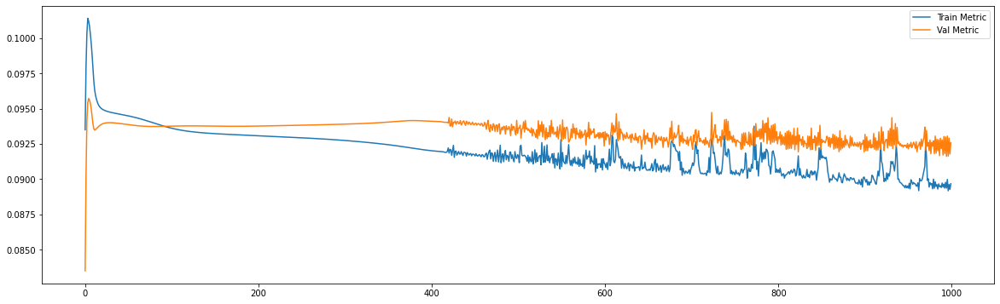

In [0]:
future_steps = 28
n_features = 1

neurons_list = [20,30,40,50]
dropout_list = [0.0,0.2]
time_steps_list = [50,60,84,100]
bach_list = [32,50,60,84,100]
lr_list = [0.001,0.0001]
models = {}
i=0
for neurons in neurons_list:
  for dropout in dropout_list:
    for time_steps in time_steps_list:
      for batch in bach_list:
        for lr in lr_list:
          x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = time_steps,n_features = n_features,df_train = df_food_train,df_val = df_food_val,df_test = df_food_test)

          models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':batch, 'learning_rate':lr}
          models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'learning_rate':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,batch,lr,1)

          # The LSTM architecture
          models[i]['model'] = Sequential()
          models[i]['model'].add(LSTM(units=neurons, return_sequences=False,input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
          models[i]['model'].add(Dropout(dropout))
          models[i]['model'].add(Dense(units=28))

          #Compiling the LSTM
          adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
          models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

          #Fitting to traning set
          history = models[i]['model'].fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 1000, batch_size=batch, verbose = 0, shuffle= False)

          print('============================model:{}==========================='.format(i))

          
          print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
          print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
          print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
          print('\n')

          print(models[i]['resumo'])
          print('\n')

          plt.figure(figsize=(20,6))
          plt.plot(history.history['loss'])
          plt.plot(history.history['val_loss'])
          plt.legend(['Train Loss', 'Val Loss'])

          plt.figure(figsize=(20,6))
          plt.plot(history.history['mae'])
          plt.plot(history.history['val_mae'])
          plt.legend(['Train Metric', 'Val Metric'])
          plt.show()

          y_val_pred = models[i]['model'].predict(x_val)
          plt.figure(figsize=(50,20))
          plt.plot(y_val[:,0],marker='o')
          plt.plot(y_val_pred[:,0],marker='o')
          plt.show()
          i+=1


          models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':batch}
          models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,batch,2)

          # The LSTM architecture
          models[i]['model'] = Sequential()
          models[i]['model'].add(LSTM(units=neurons, return_sequences=True,input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
          models[i]['model'].add(Dropout(dropout))
          models[i]['model'].add(LSTM(units=neurons, return_sequences=False))
          models[i]['model'].add(Dropout(dropout))
          models[i]['model'].add(Dense(units=28))

          #Compiling the LSTM
          adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
          models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

          #Fitting to traning set
          history = models[i]['model'].fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 1000, batch_size=batch, verbose = 0, shuffle= False)

          print('============================model:{}==========================='.format(i))

          
          print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
          print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
          print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
          print('\n')

          print(models[i]['resumo'])
          print('\n')

          plt.figure(figsize=(20,6))
          plt.plot(history.history['loss'])
          plt.plot(history.history['val_loss'])
          plt.legend(['Train Loss', 'Val Loss'])

          plt.figure(figsize=(20,6))
          plt.plot(history.history['mae'])
          plt.plot(history.history['val_mae'])
          plt.legend(['Train Metric', 'Val Metric'])
          plt.show()

          y_val_pred = models[i]['model'].predict(x_val)
          plt.figure(figsize=(50,20))
          plt.plot(y_val[:,0],marker='o')
          plt.plot(y_val_pred[:,0],marker='o')
          plt.show()

          i+=1

# Changing pre-processing

In the attempts above, doesn't matter how much I increase the regularization 
methods the network doesn't generalise.

---

Now I'll try to make an outlier treatment to improve generalization. 

In [0]:
dataset = pd.read_csv('/content/drive/My Drive/Specialization/Projects/Recurrent Neural Networks/M5 - Data/sales_train_validation.csv')

In [0]:
group = dataset.groupby(['state_id','cat_id']).first()
df_food =  group.loc[('WI','FOODS'),'d_1':]
del group

train_limit = int(round((df_food.shape[0])*0.7,0))
val_limit = int(round((df_food.shape[0])*0.85,0))

df_food_train = df_food[:train_limit]
df_food_val = df_food[train_limit:val_limit]
df_food_test = df_food[val_limit:]

print(df_food_test.shape)

(287,)


## To detect outliers lets see the quantiles of 0.8, 0.9 and 0.95 

--- 

The values doesn't fluctuate to much at the distibution, let's impose a maximum value of 2.

In [0]:
print(df_food_train.quantile(q = 0.8))
print(df_food_train.quantile(q = 0.9))
print(df_food_train.quantile(q = 0.95))

1.0
2.0
2.0


In [0]:
df_food_train[df_food_train > df_food_train.quantile(q = 0.9)] = int(df_food_train.quantile(q = 0.9))

## Normalizing

In [0]:
df_food_train = df_food_train.values.reshape(-1,1)
df_food_val = df_food_val.values.reshape(-1,1)
df_food_test = df_food_test.values.reshape(-1,1)

scaler_food = MinMaxScaler(feature_range=(0,1))
df_food_train = scaler_food.fit_transform(df_food_train)
df_food_val = scaler_food.transform(df_food_val)
df_food_test = scaler_food.transform(df_food_test)

## Regressor

with the most promissing model, 

============================model:0===========================


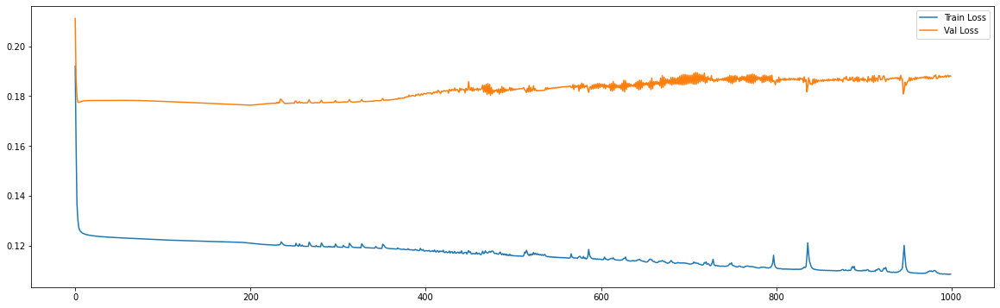

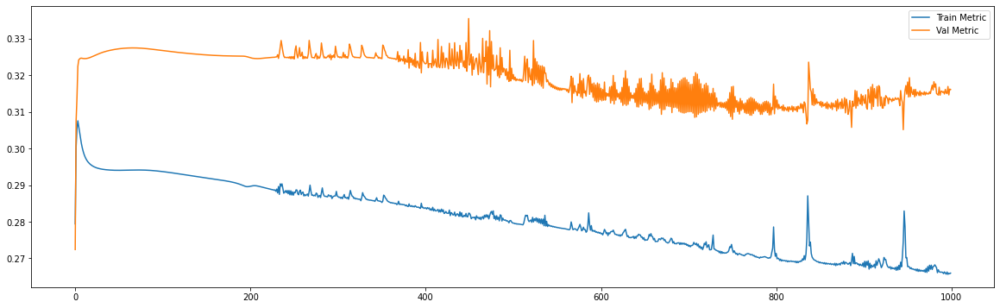

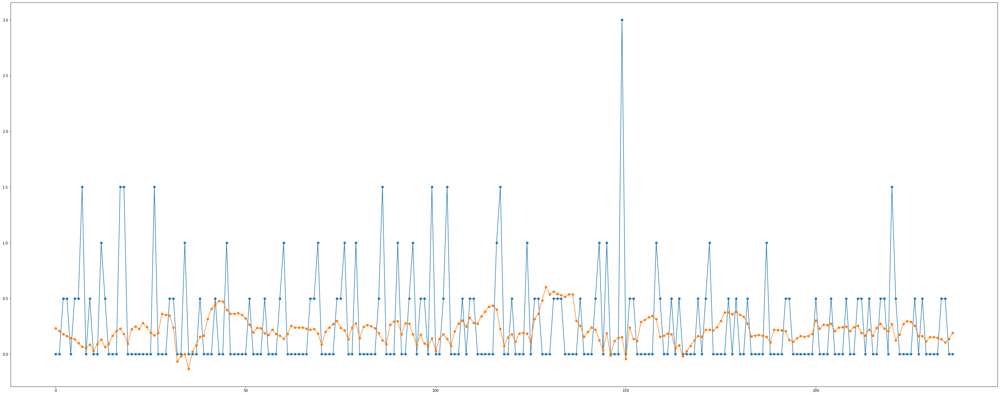

============================model:1===========================


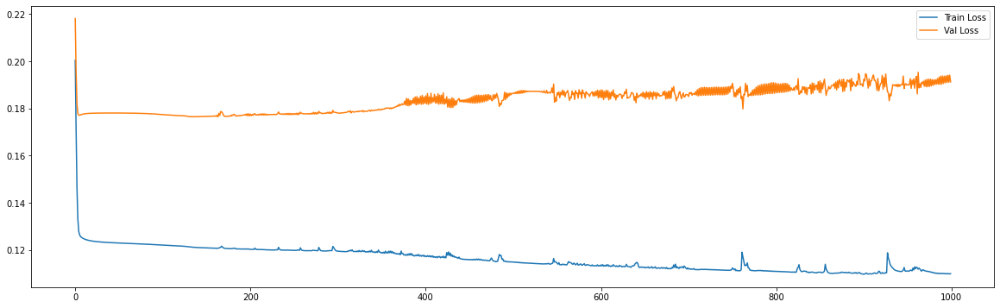

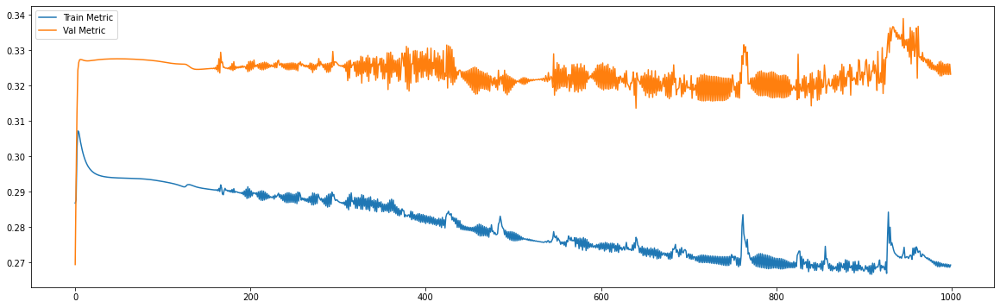

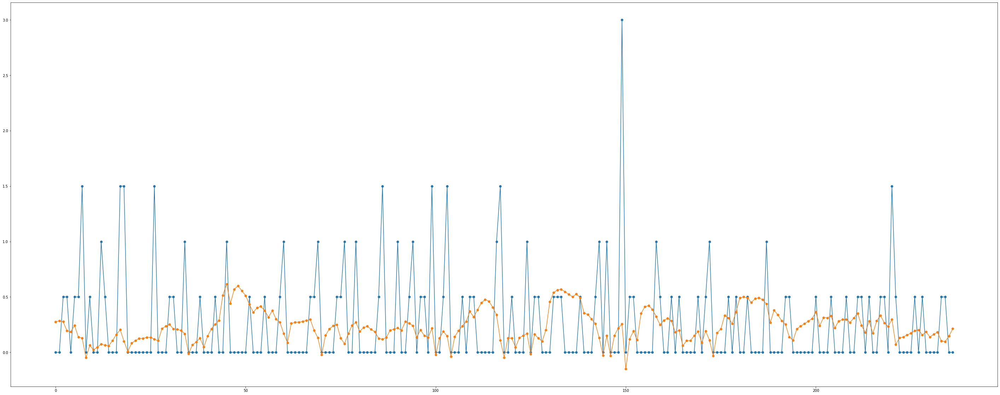

============================model:2===========================


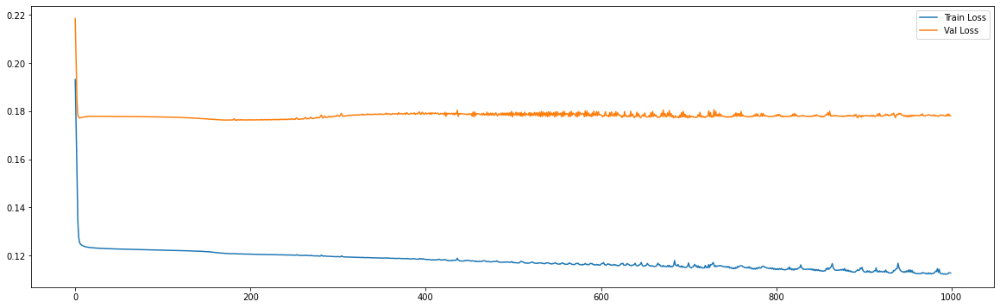

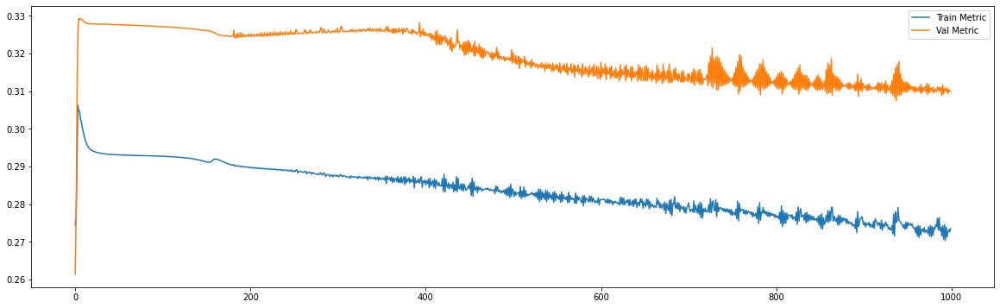

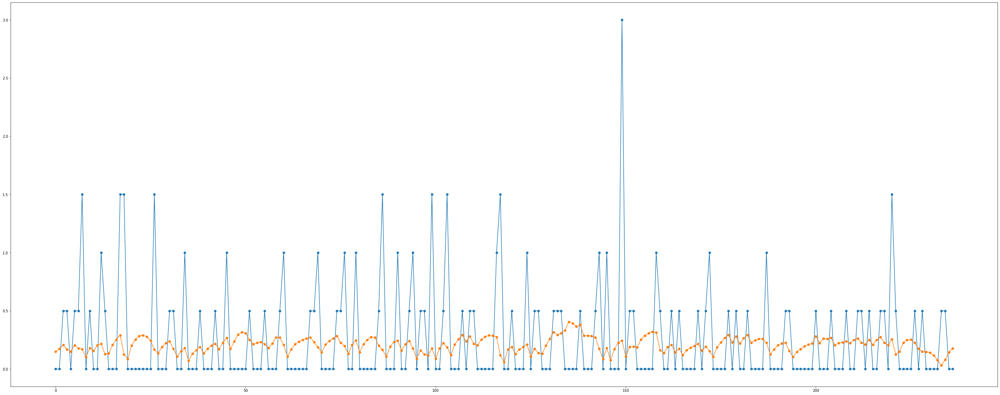

============================model:3===========================


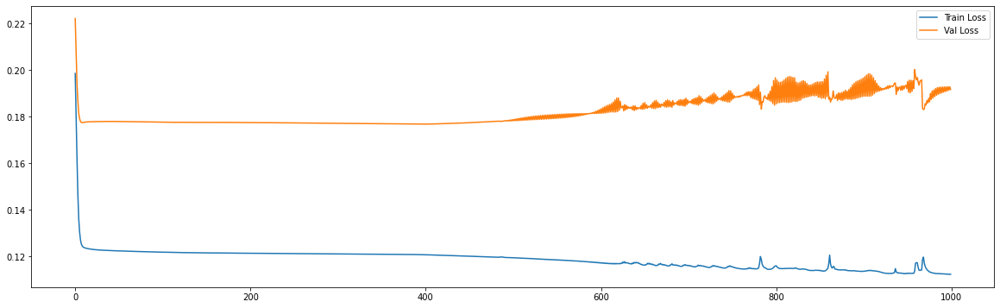

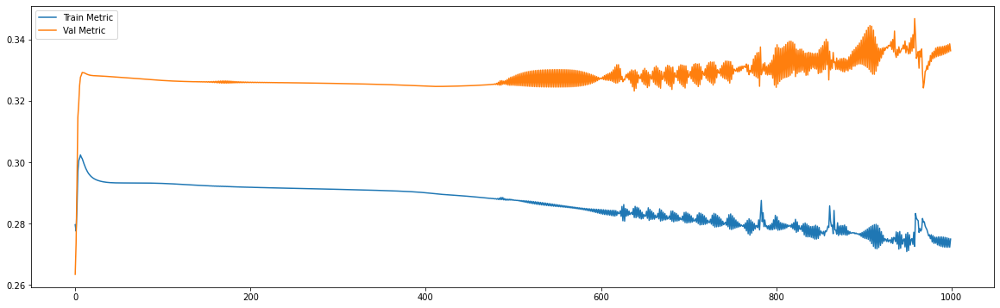

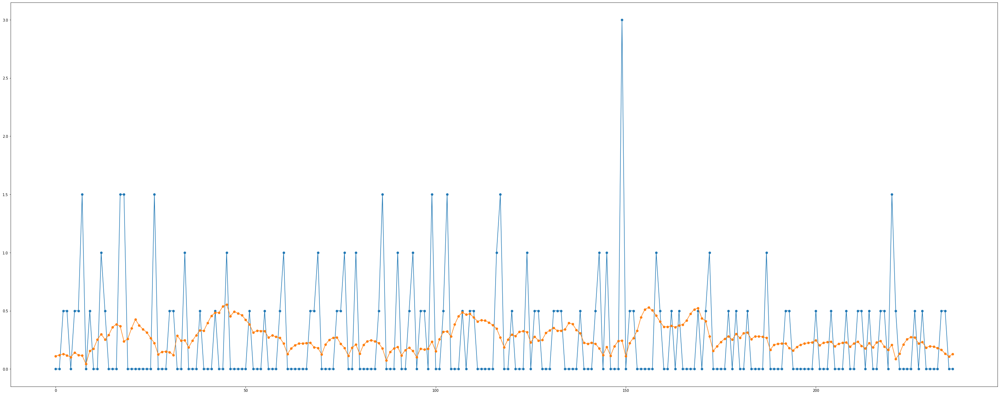

============================model:4===========================


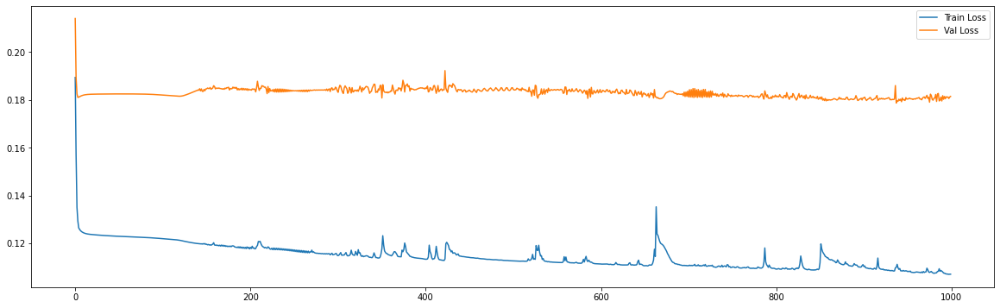

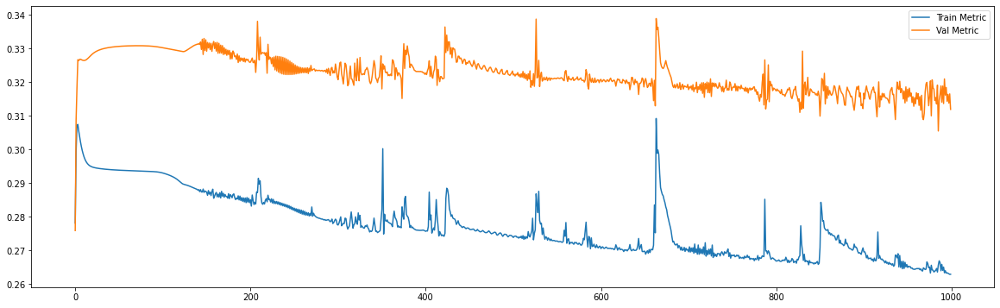

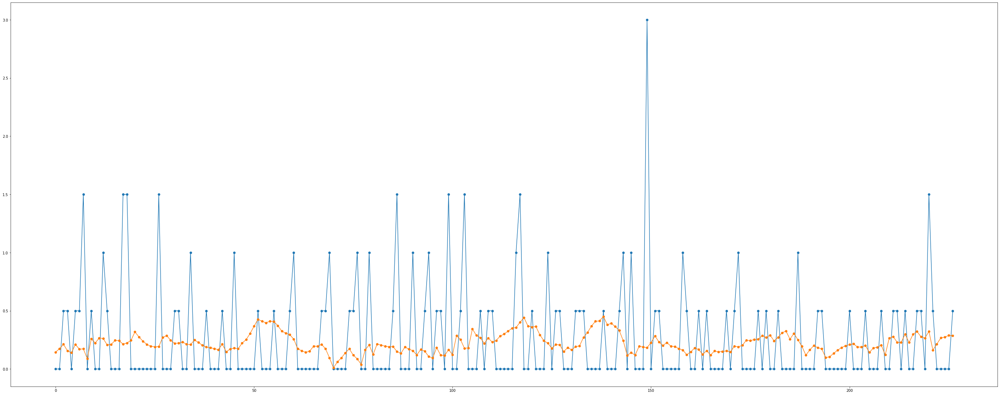

============================model:5===========================


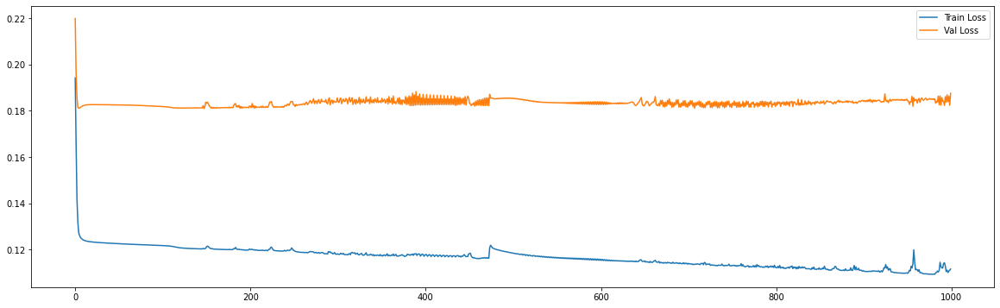

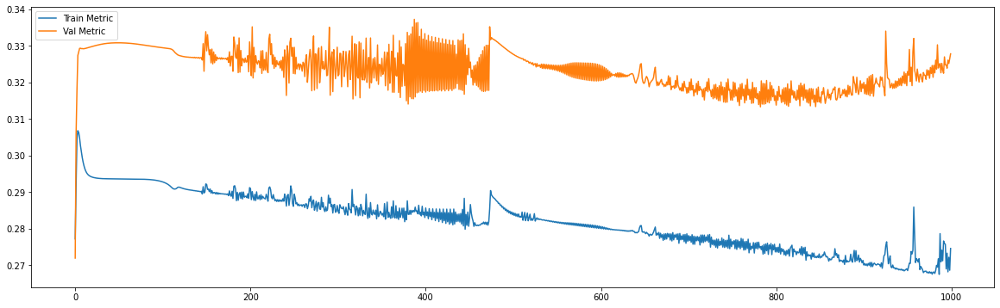

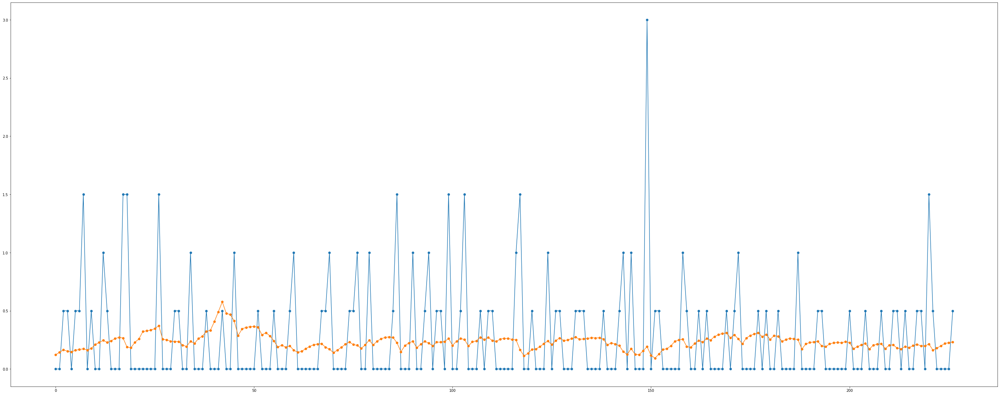

============================model:6===========================


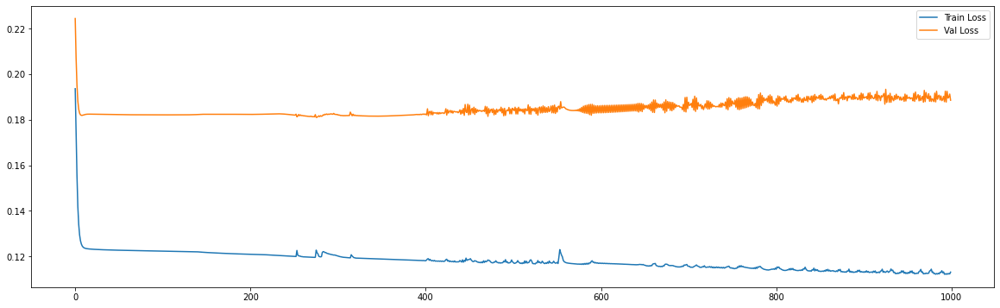

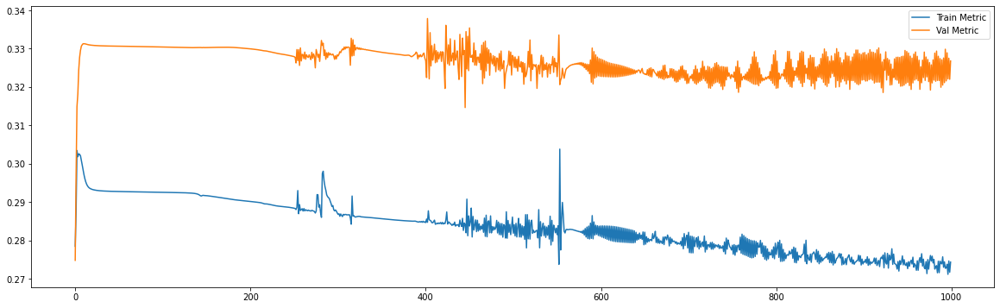

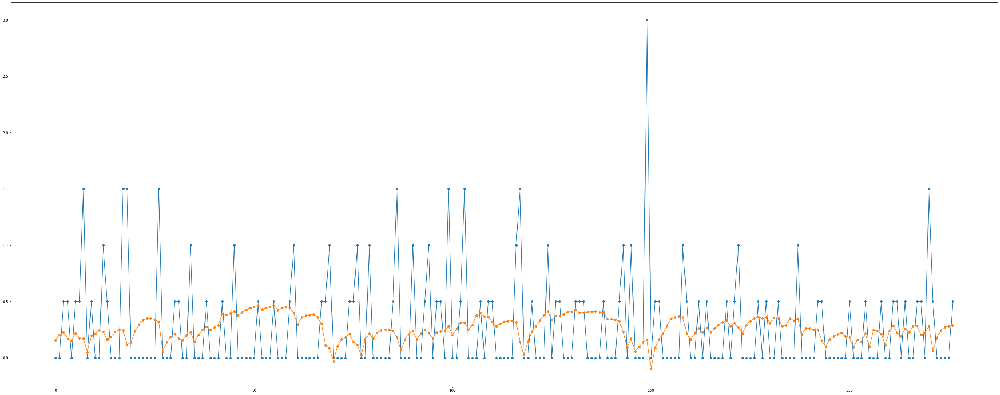

============================model:7===========================


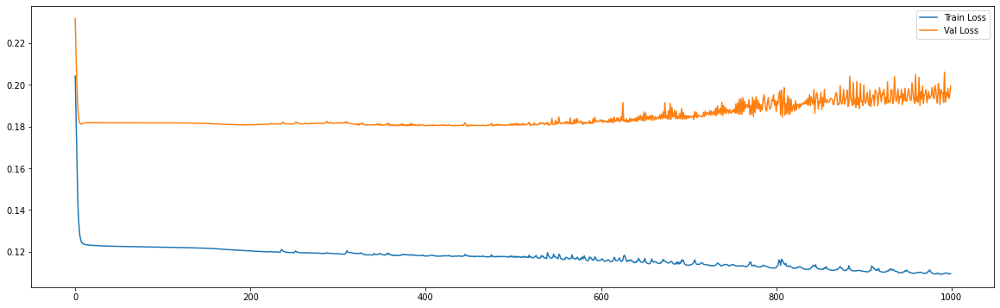

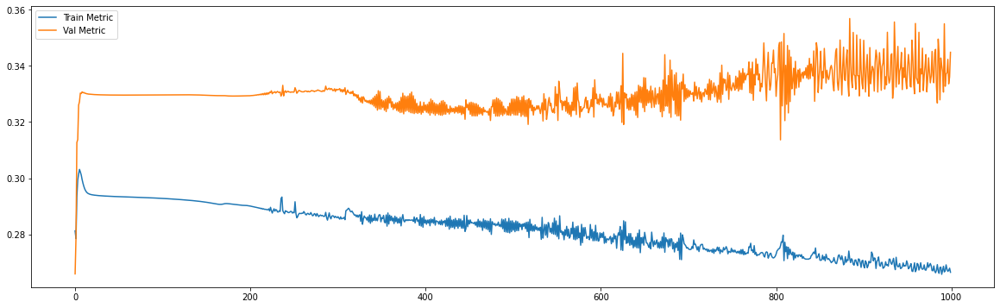

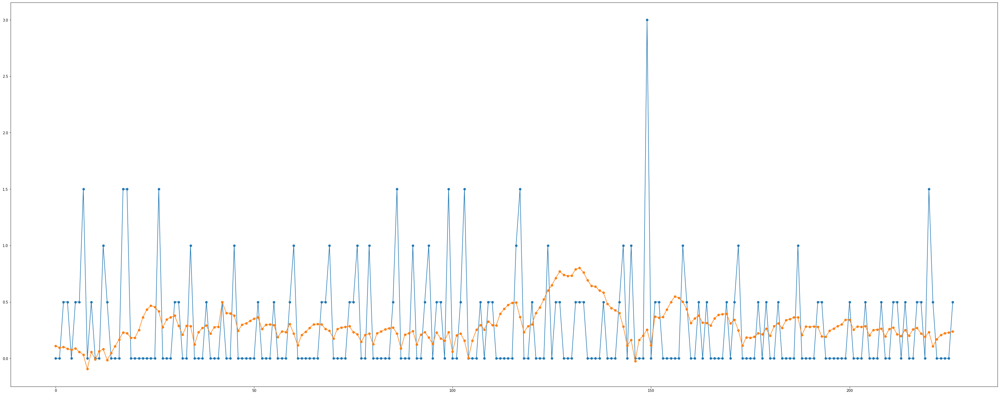

============================model:8===========================


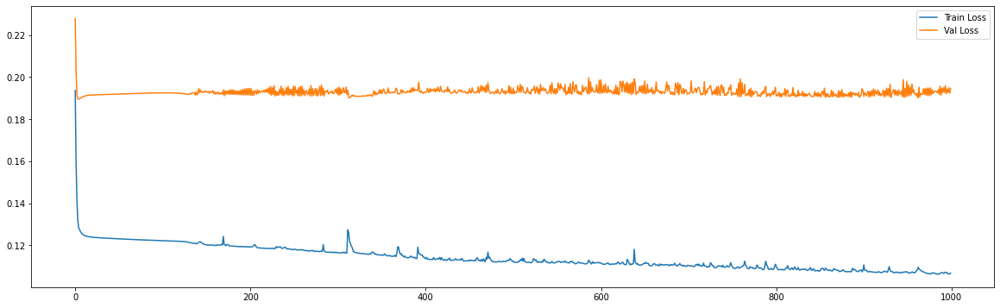

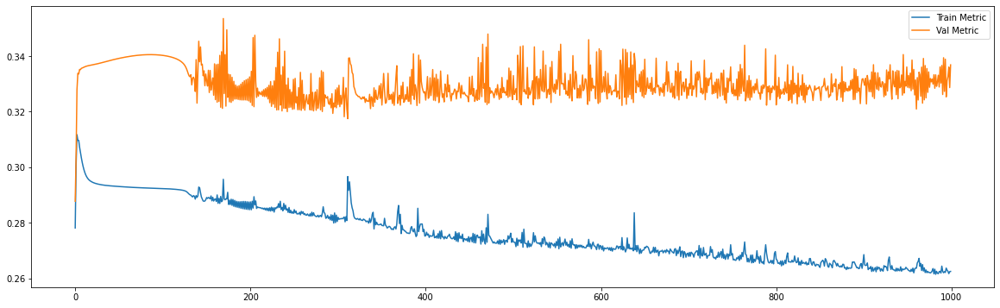

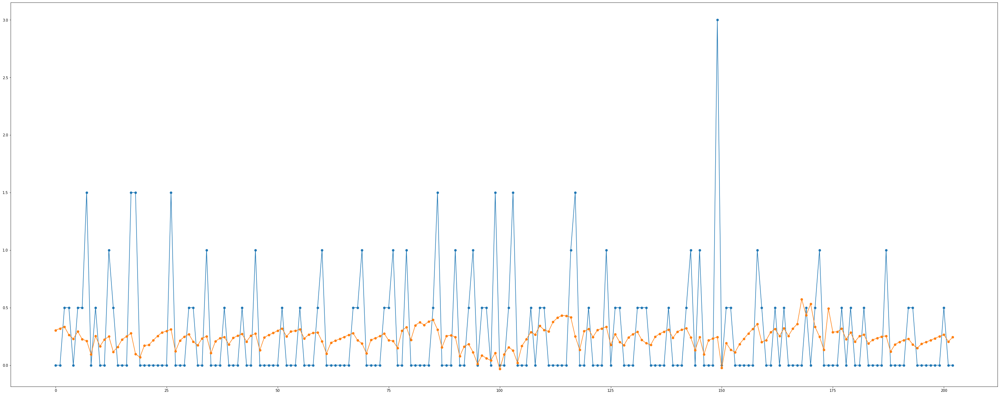

============================model:9===========================


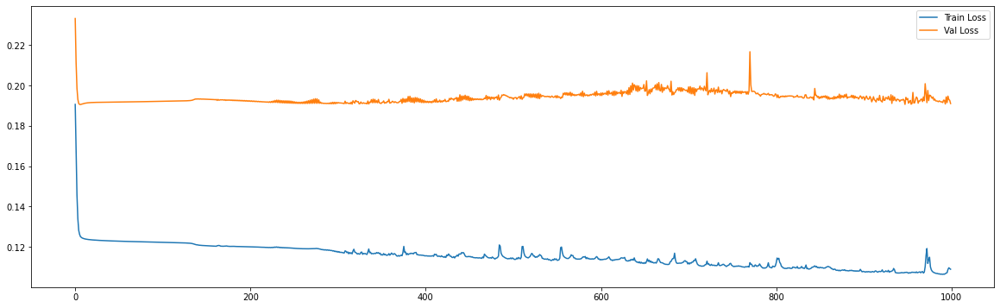

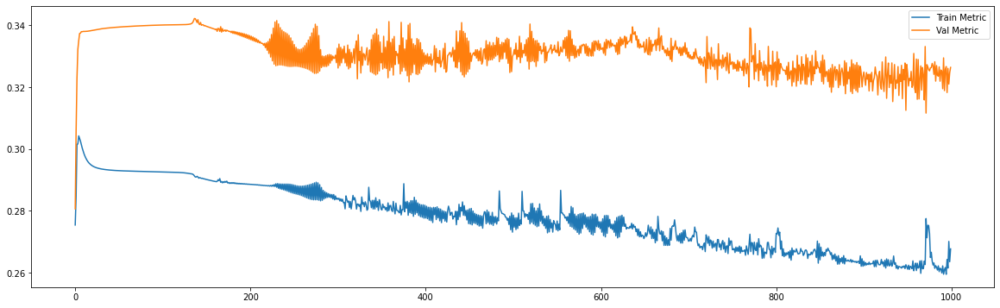

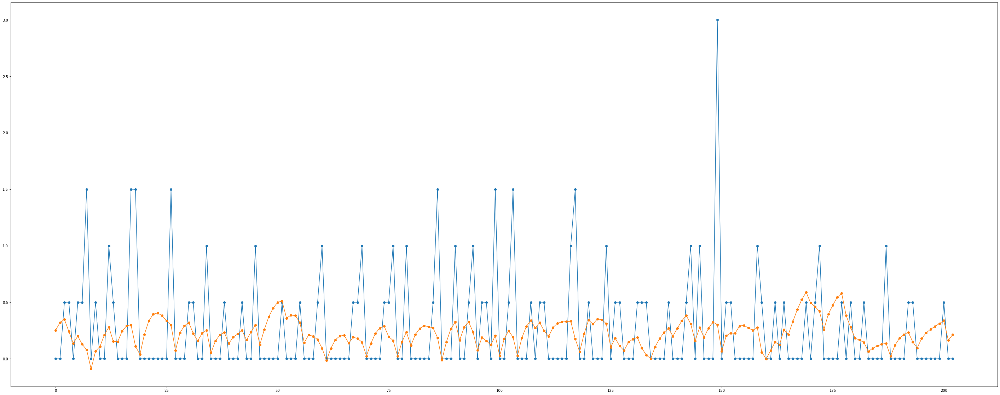

============================model:10===========================


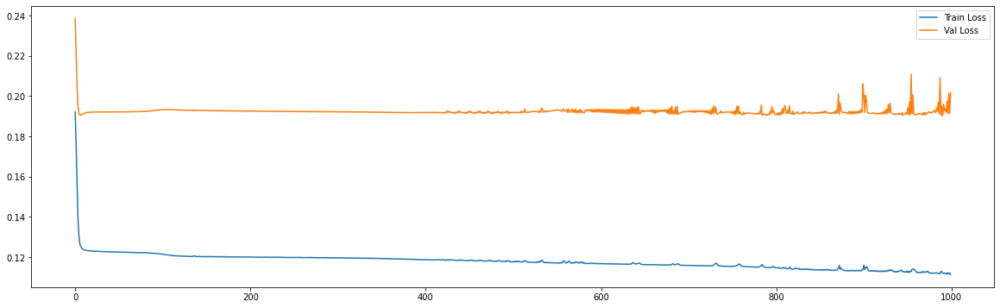

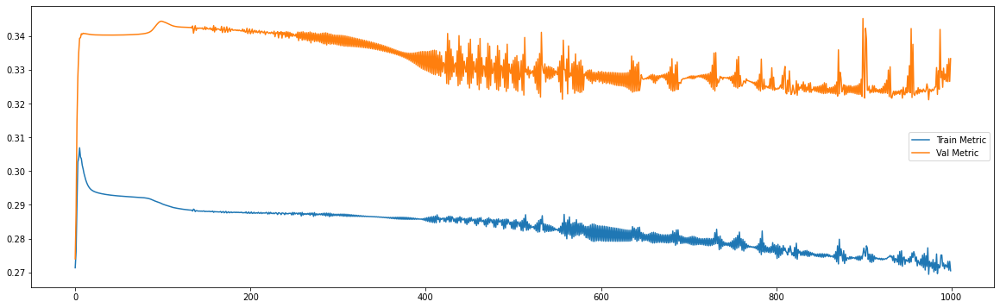

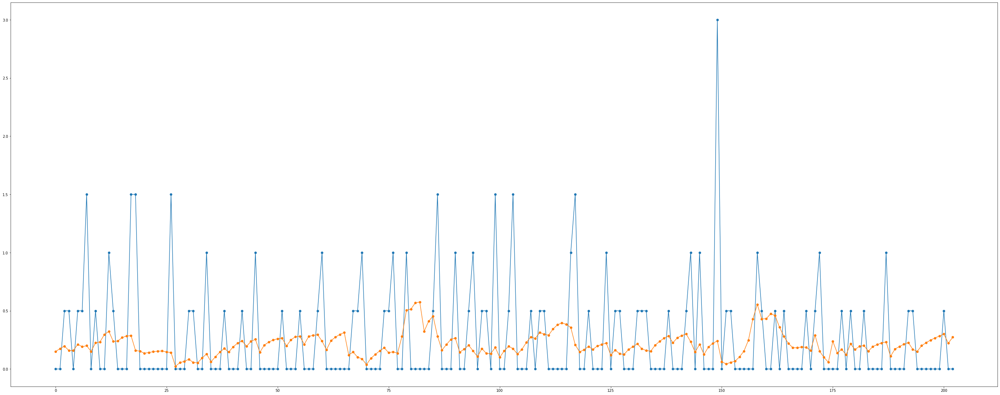

============================model:11===========================


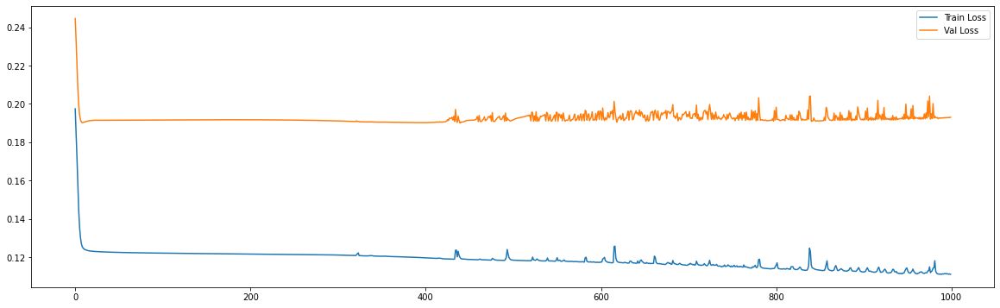

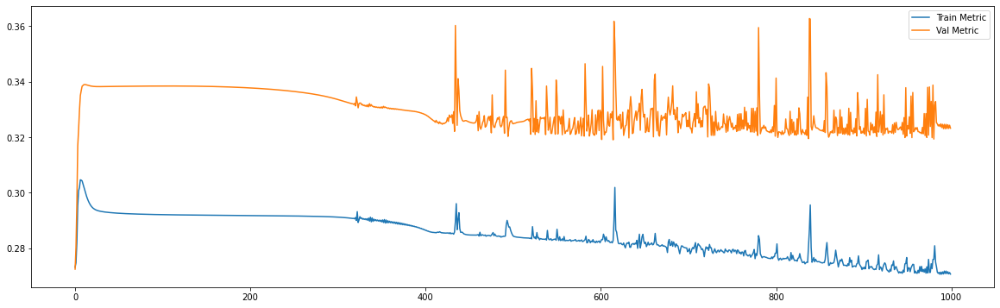

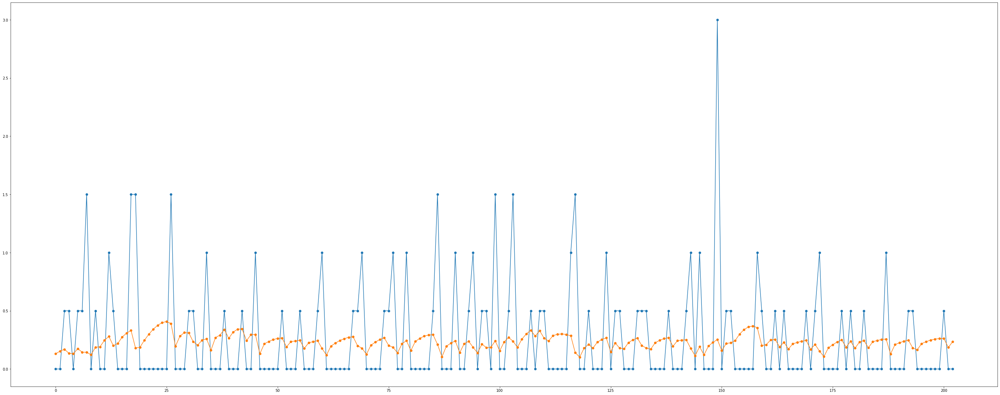

============================model:12===========================


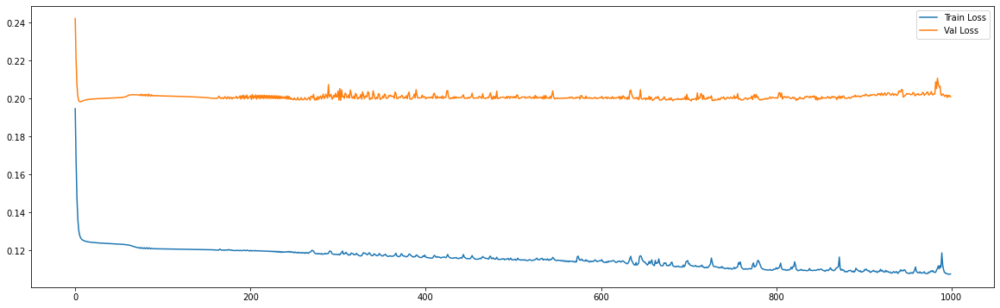

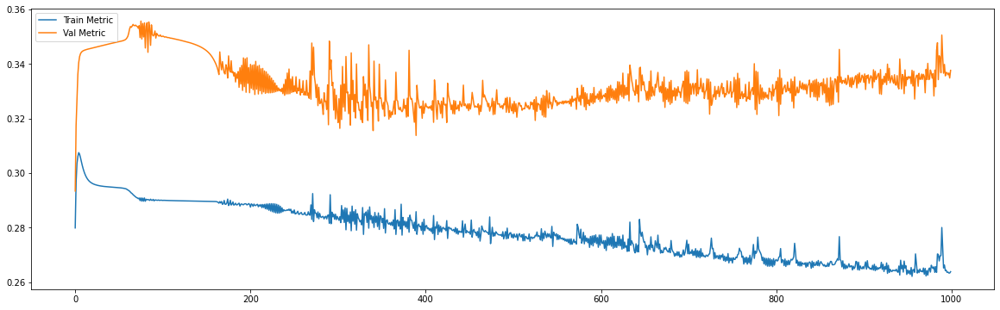

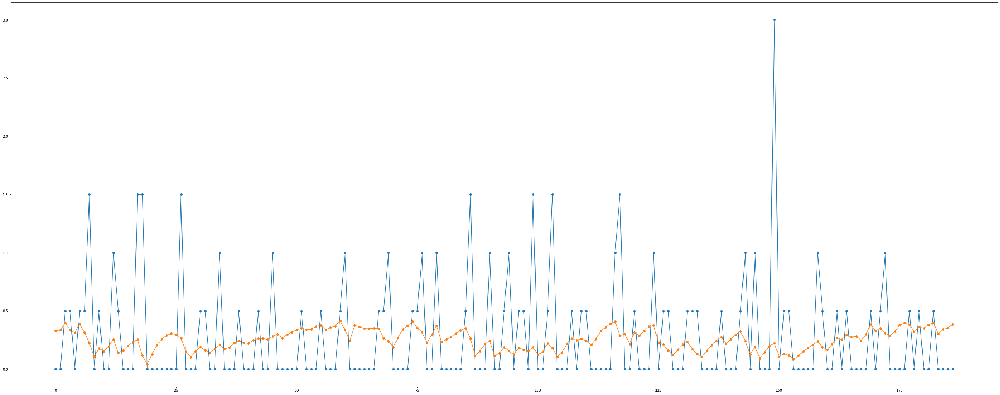

============================model:13===========================


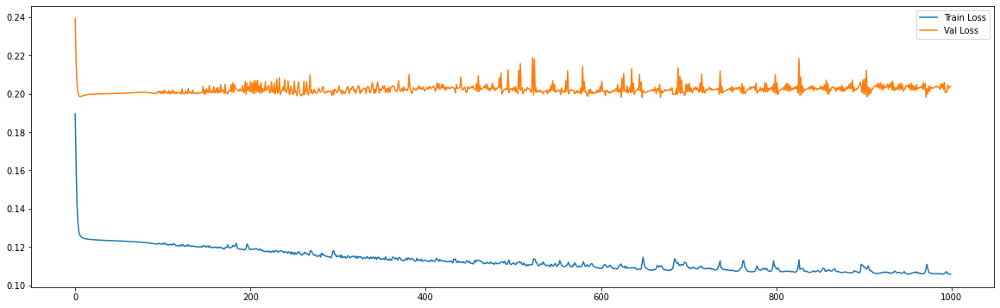

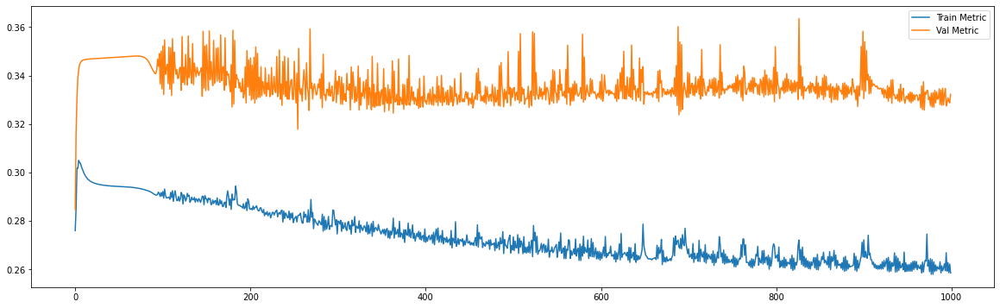

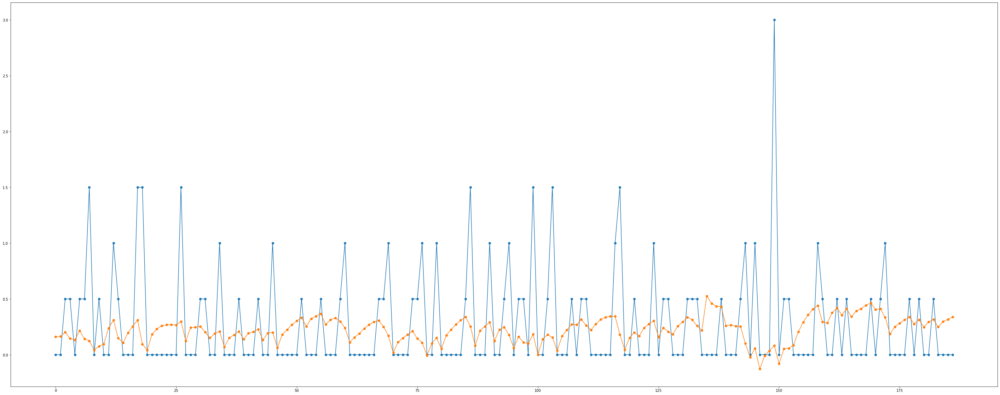

============================model:14===========================


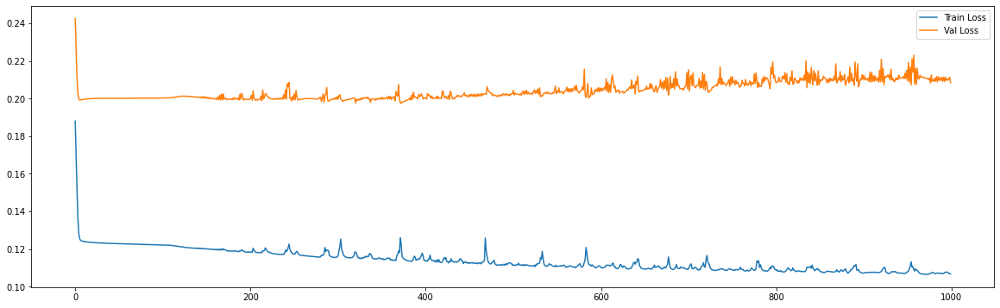

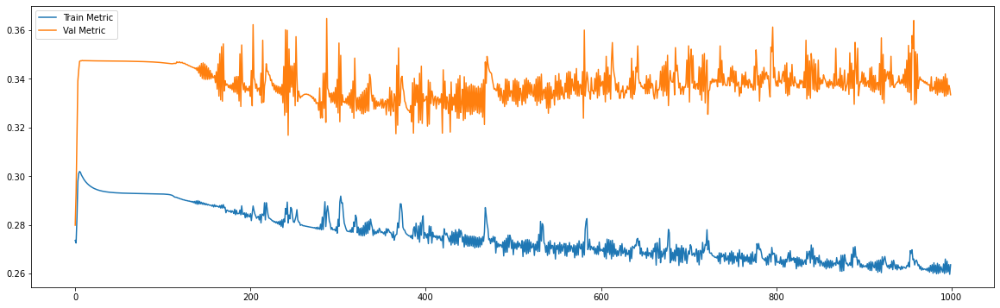

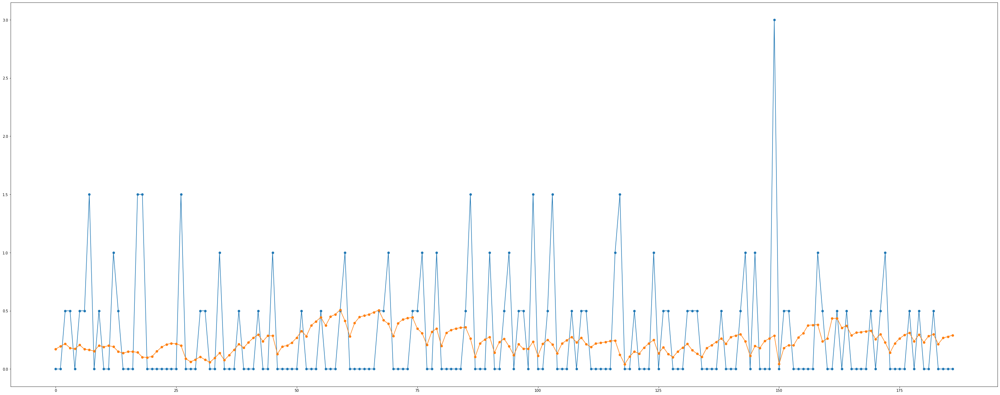

============================model:15===========================


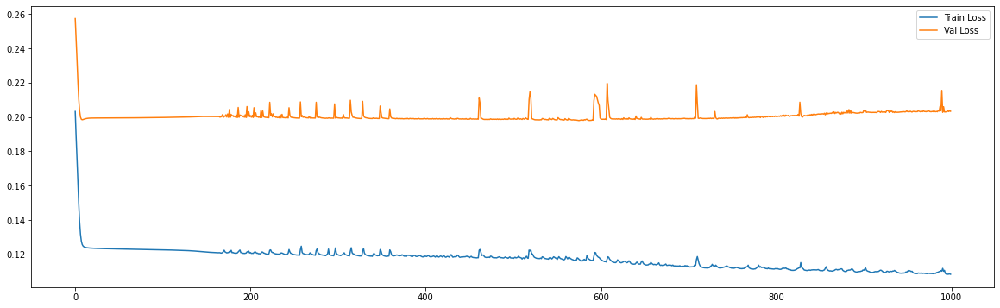

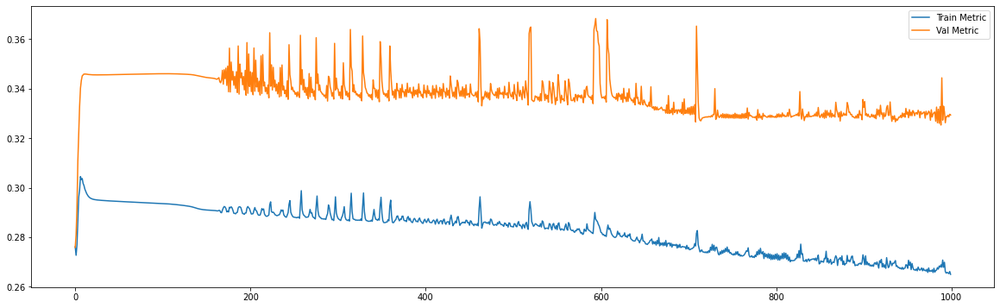

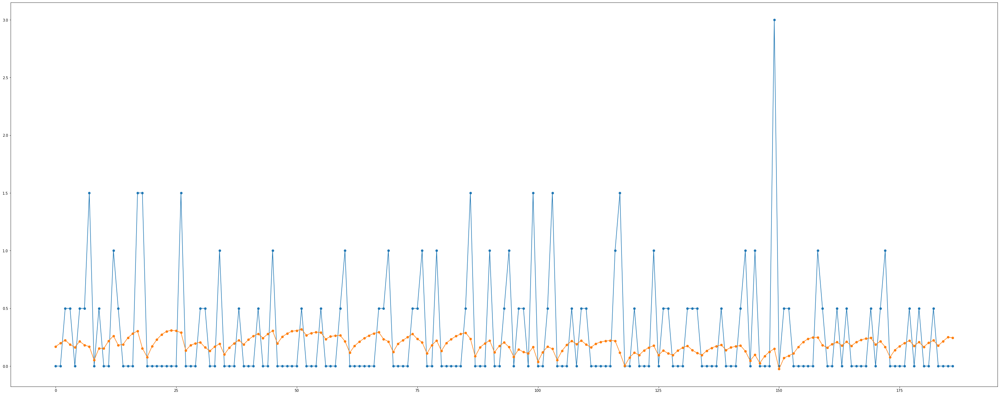

============================model:16===========================


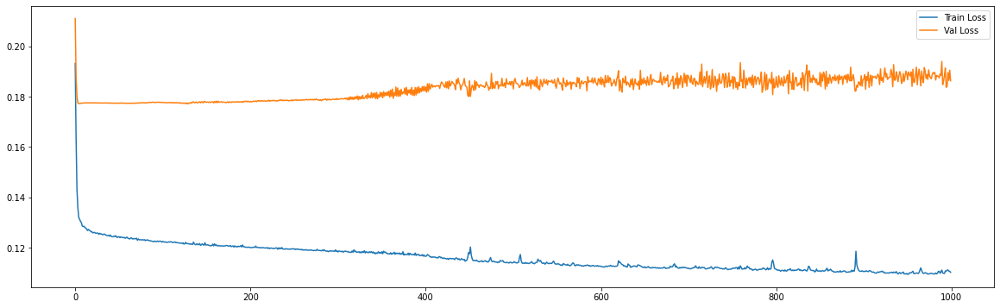

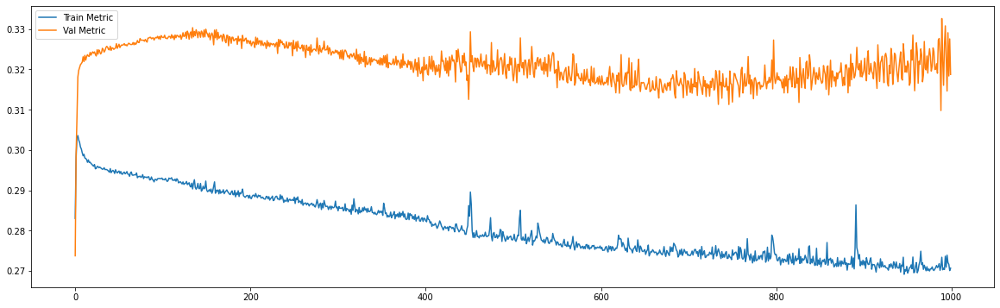

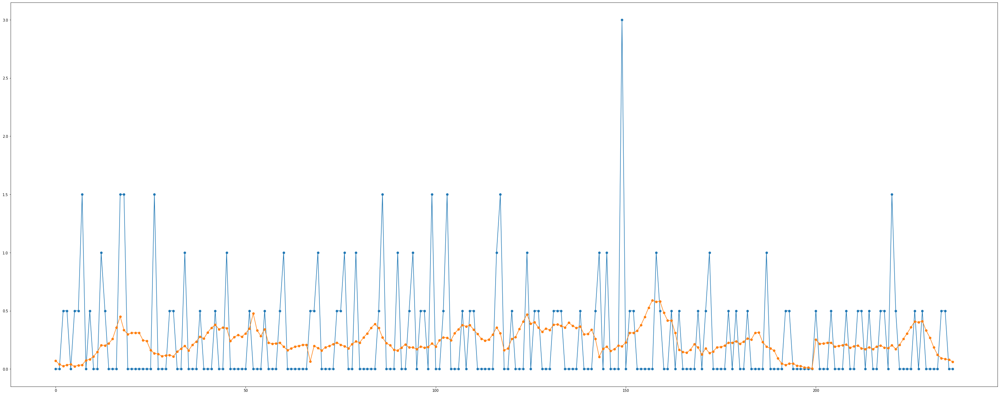

============================model:17===========================


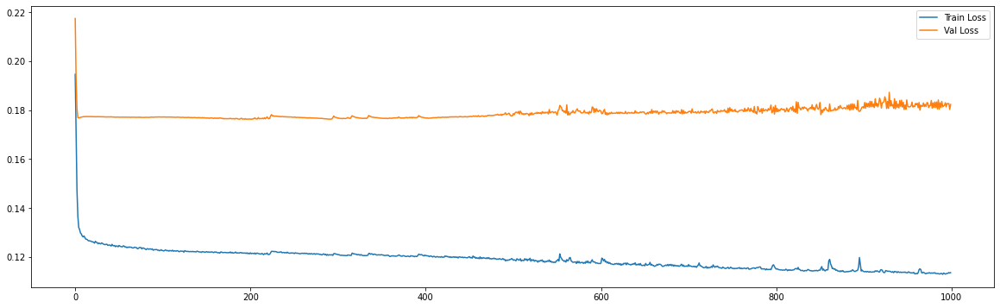

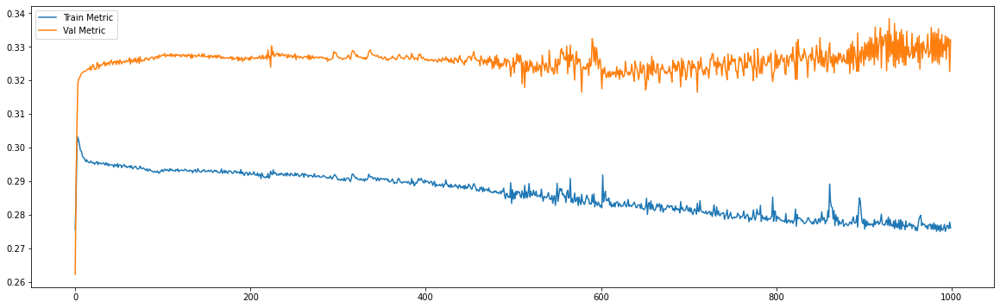

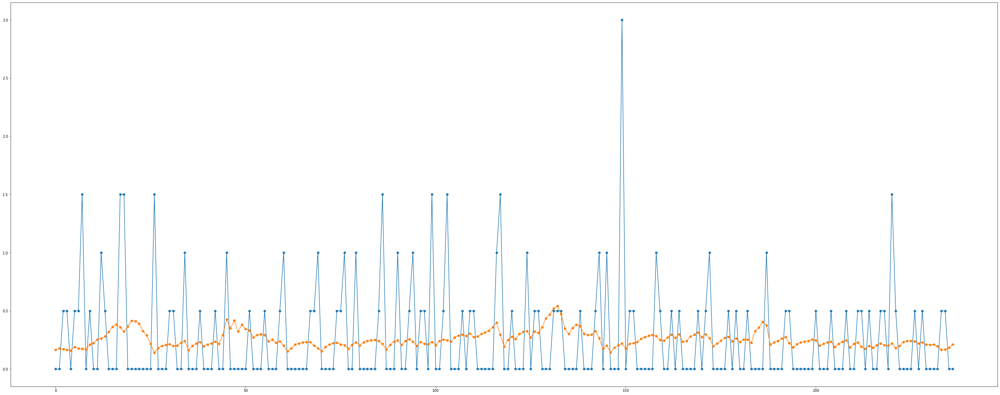

============================model:18===========================


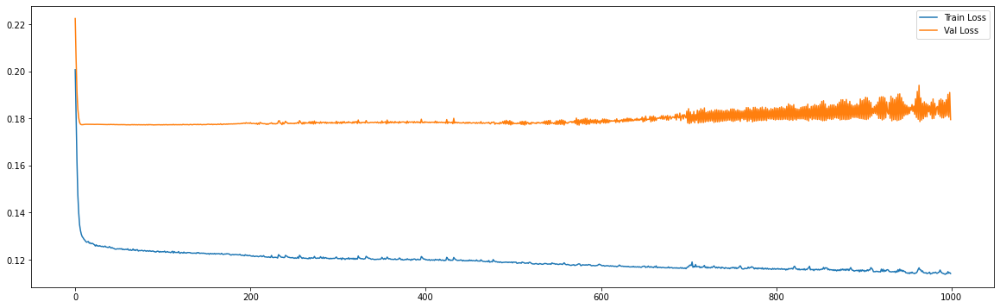

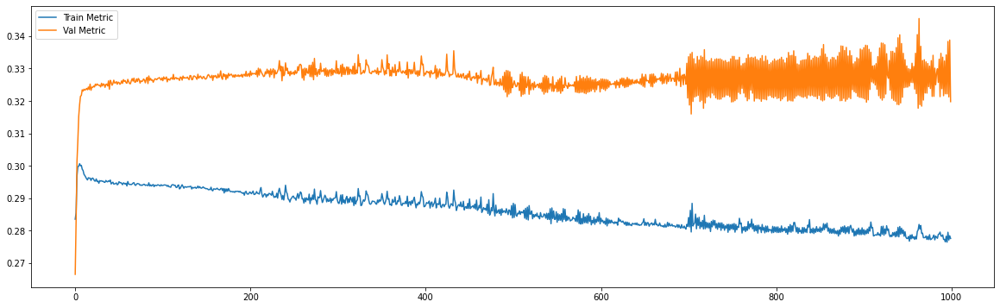

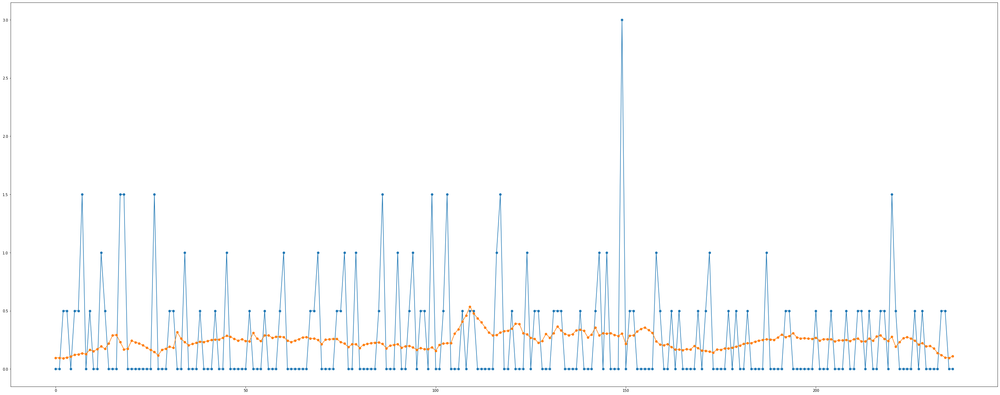

============================model:19===========================


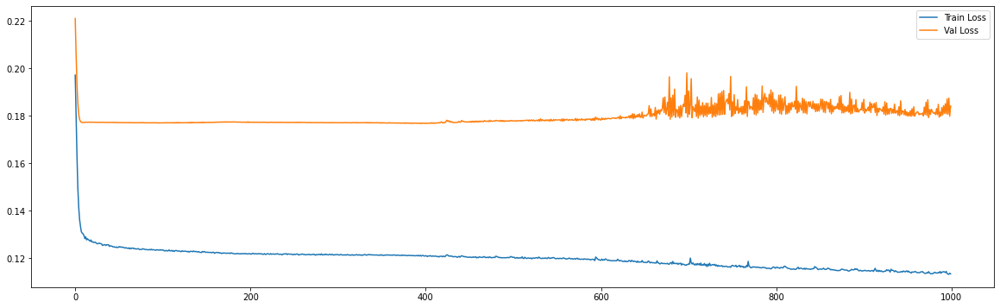

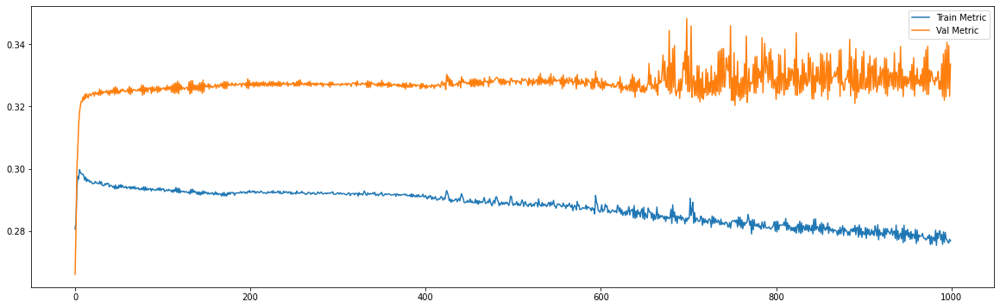

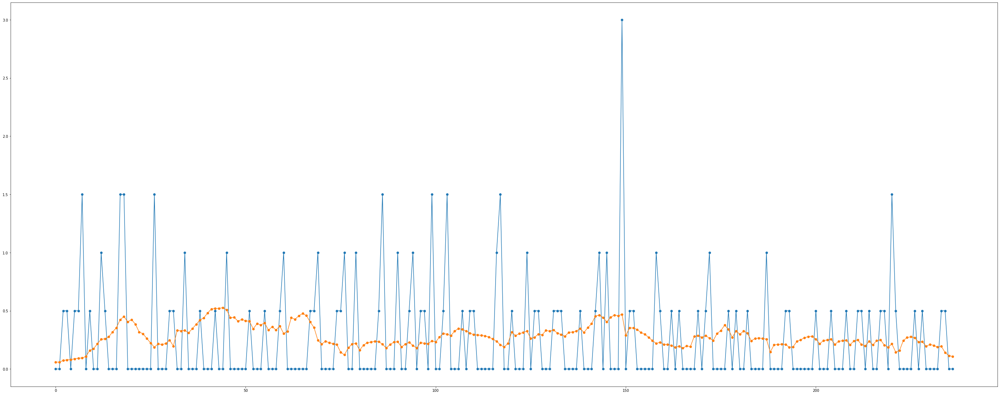

============================model:20===========================


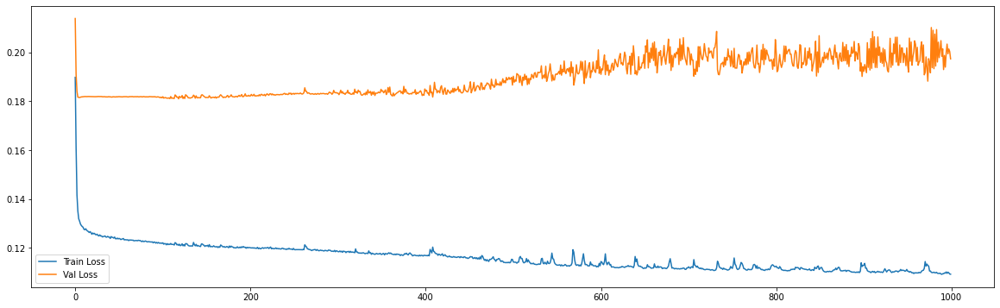

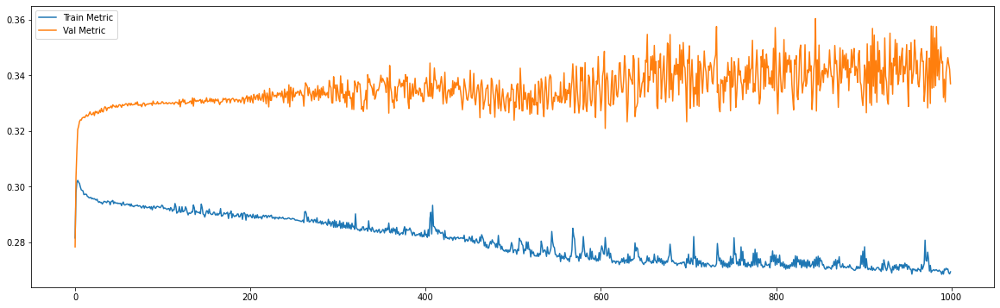

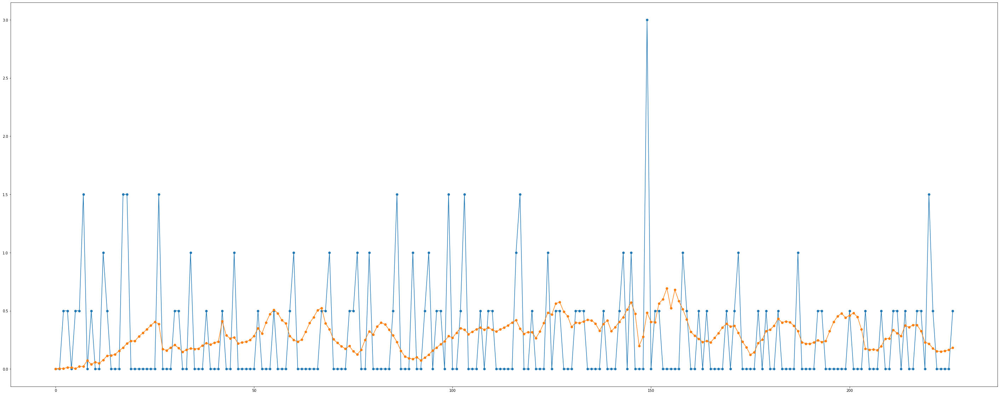

============================model:21===========================


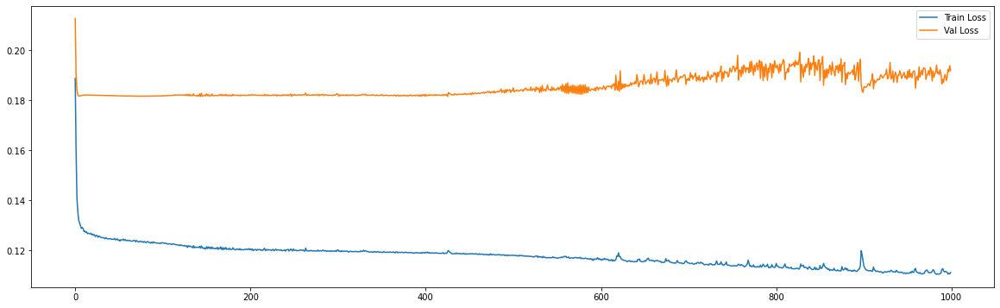

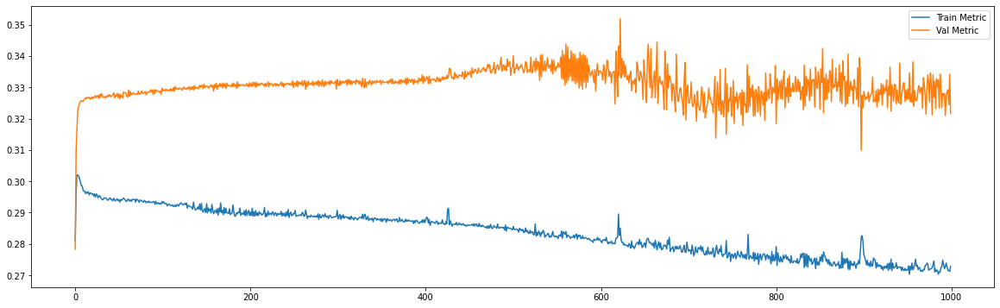

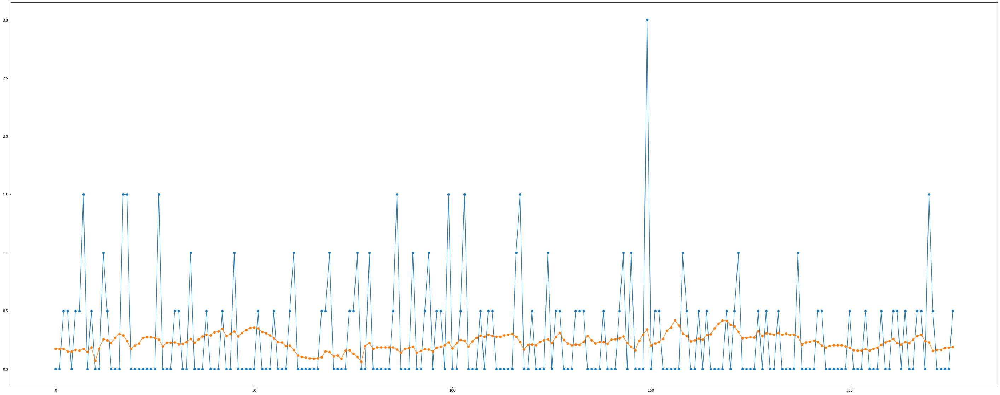

============================model:22===========================


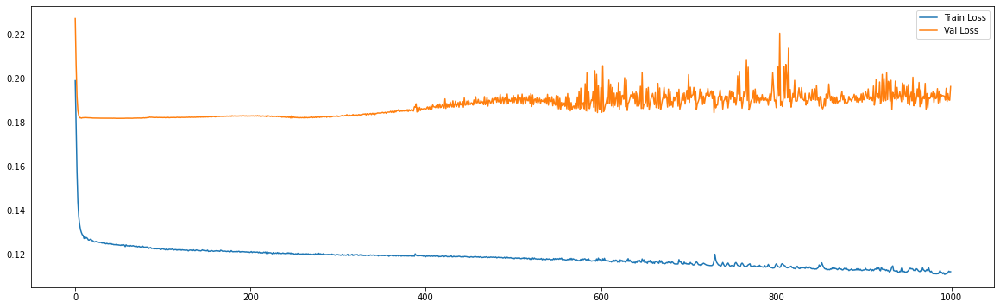

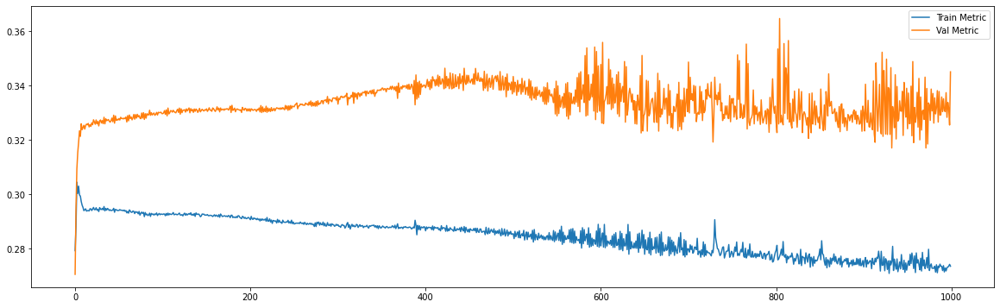

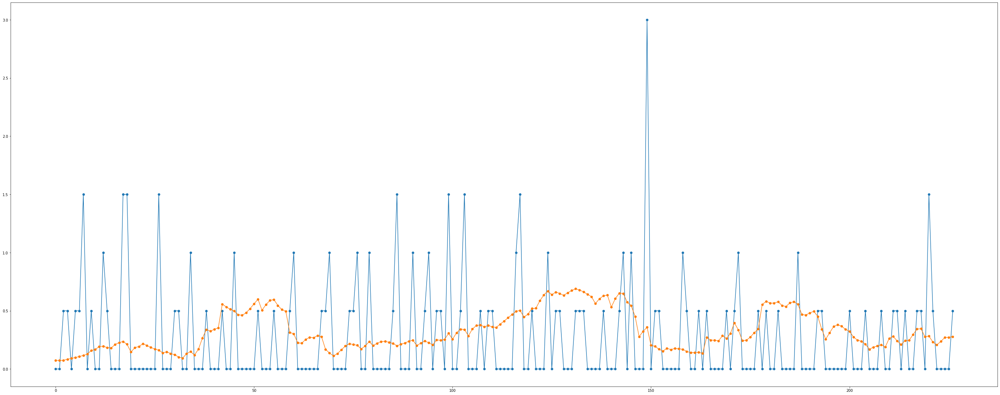

============================model:23===========================


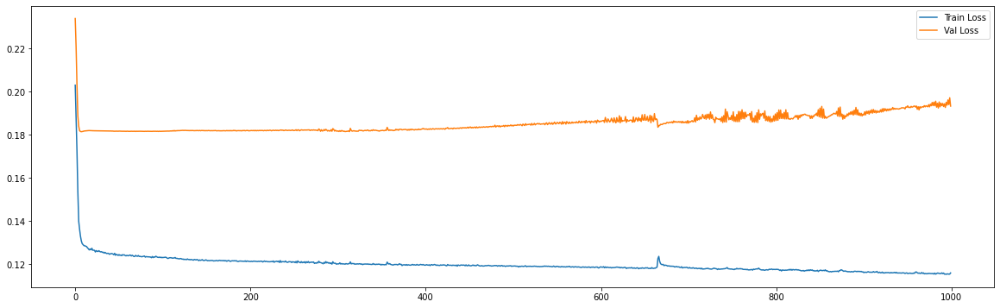

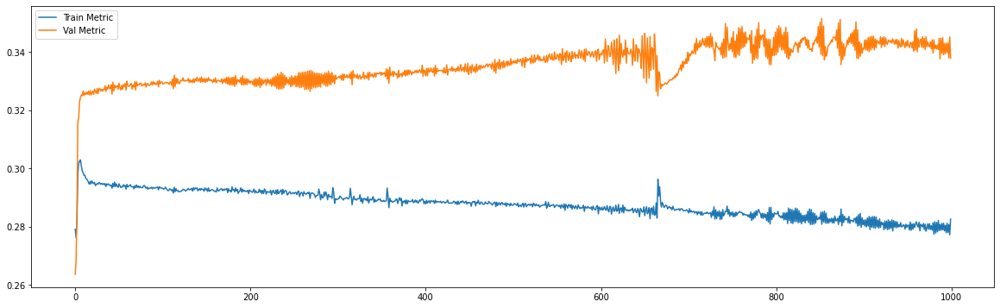

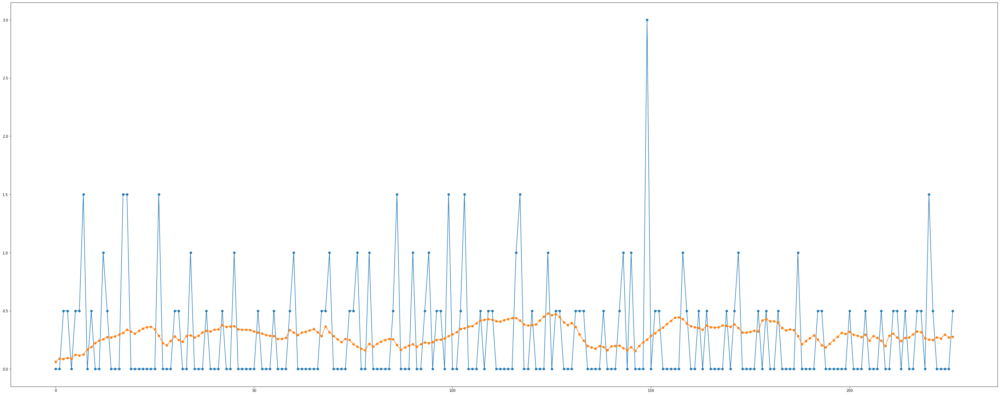

============================model:24===========================


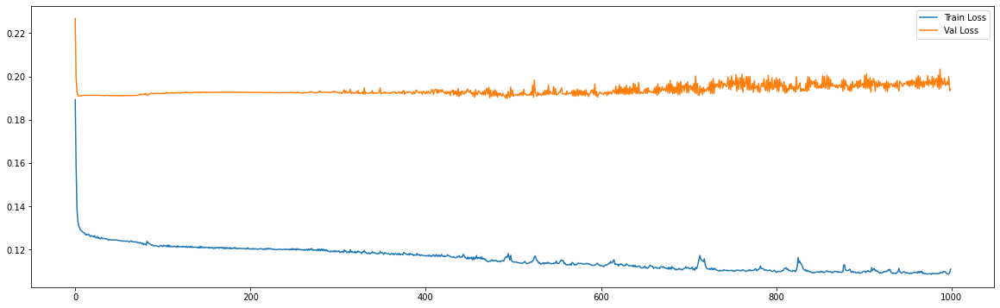

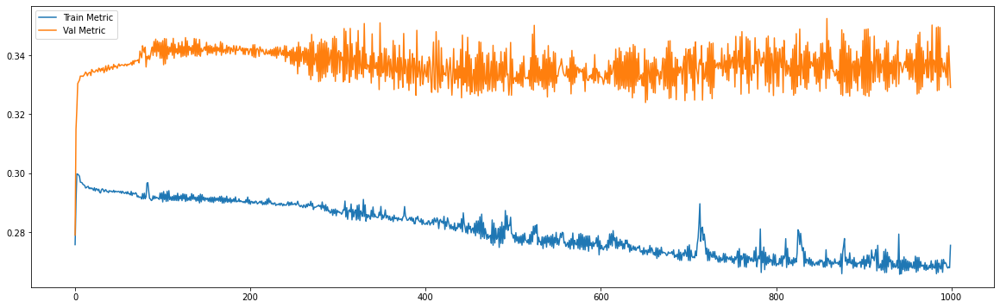

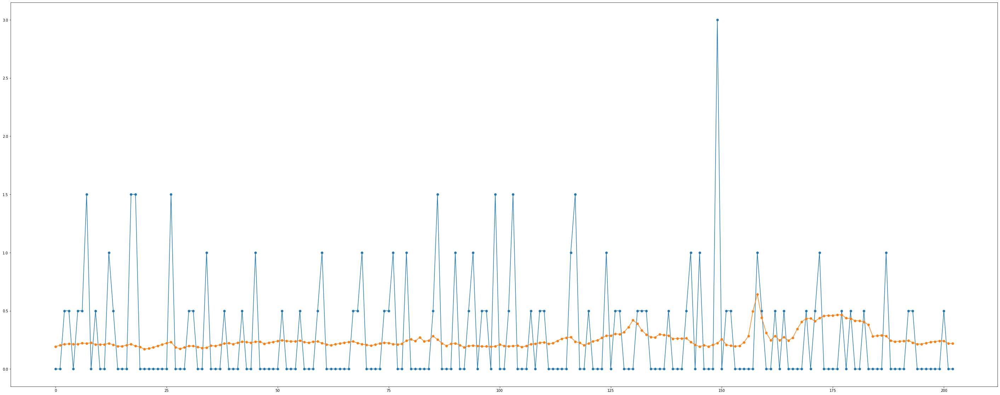

============================model:25===========================


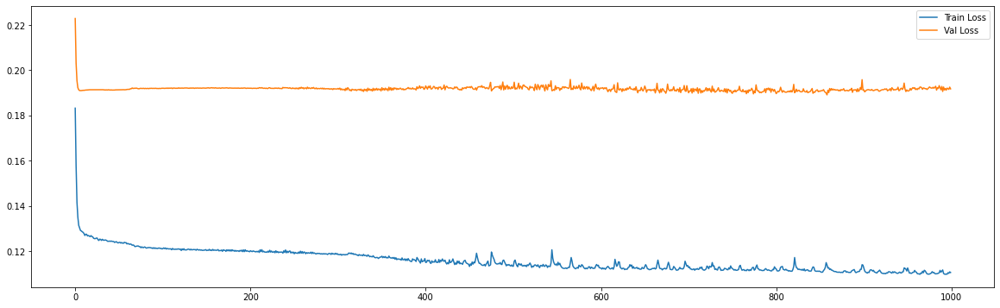

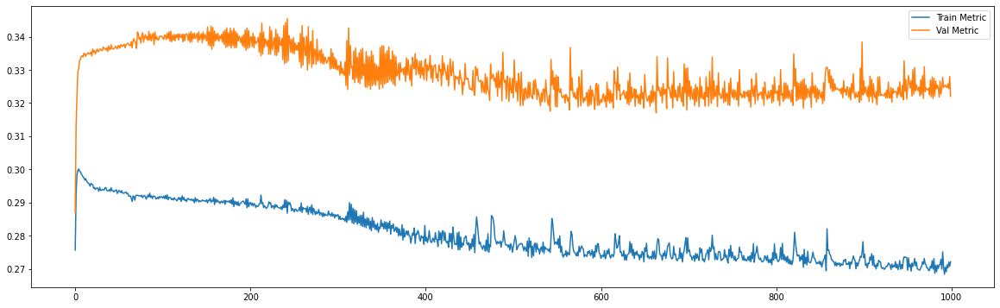

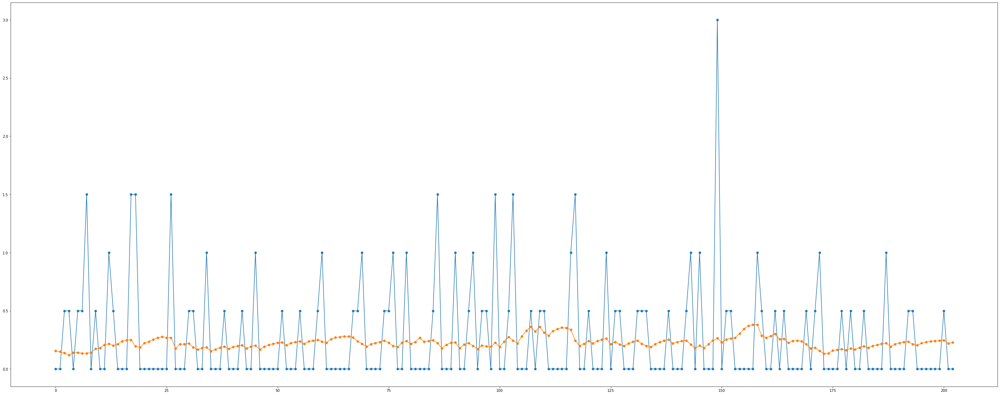

============================model:26===========================


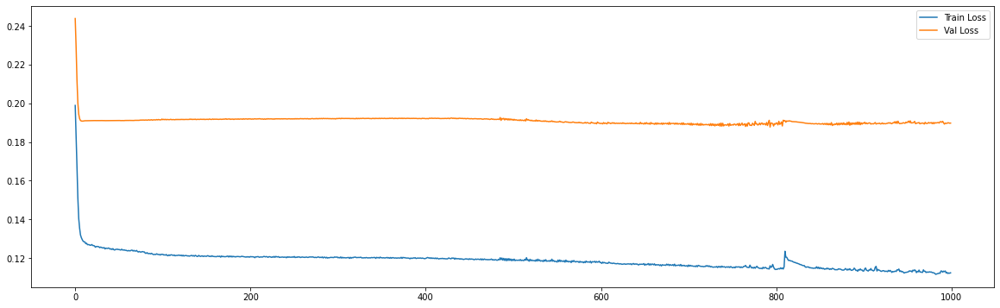

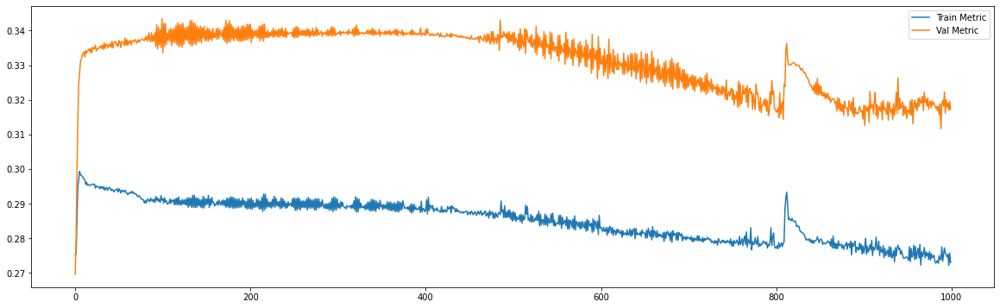

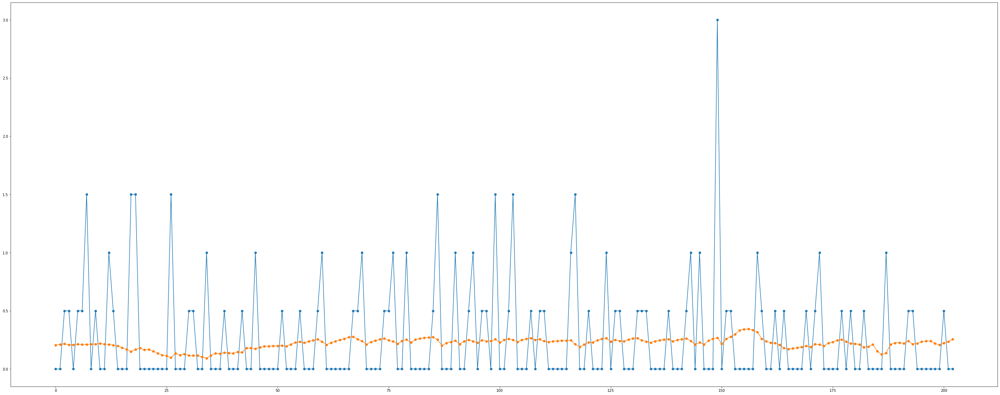

============================model:27===========================


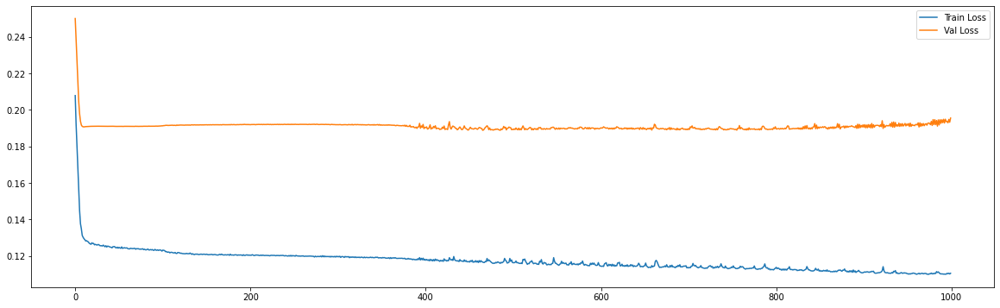

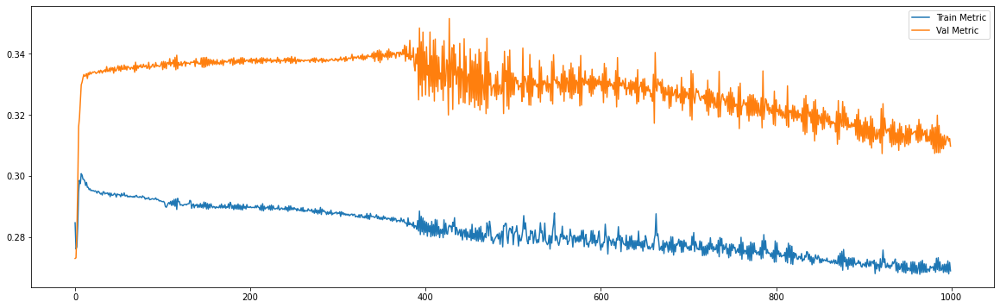

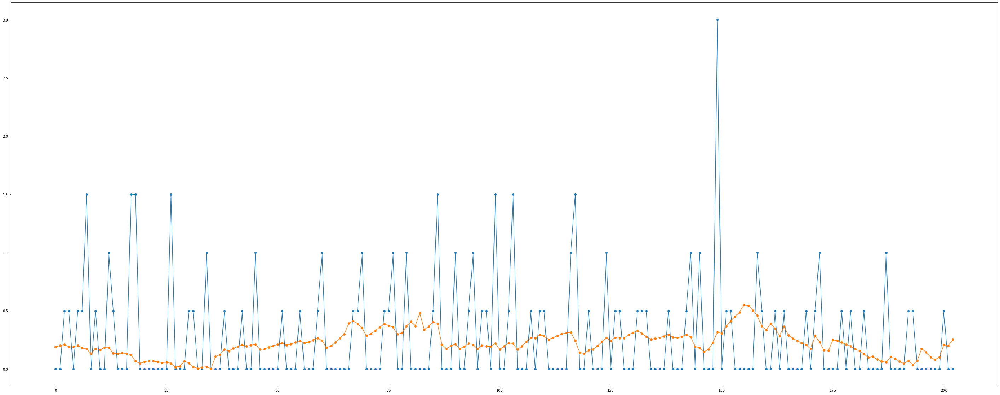

============================model:28===========================


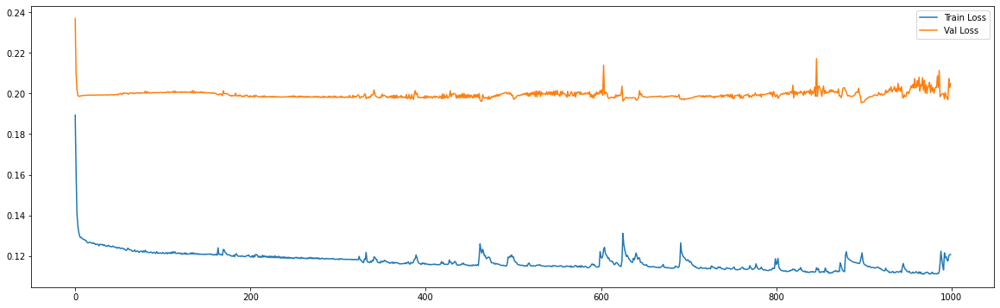

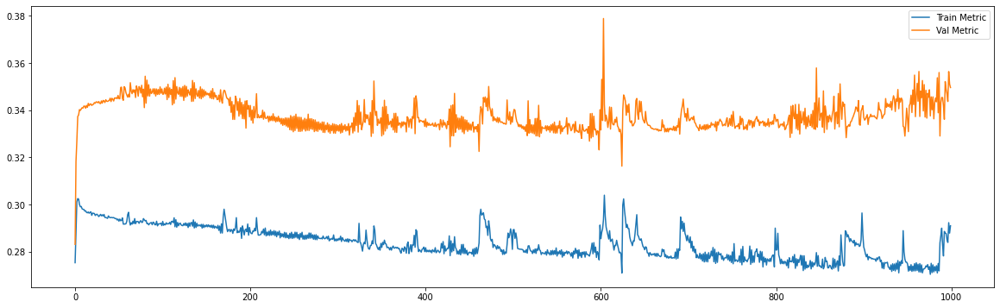

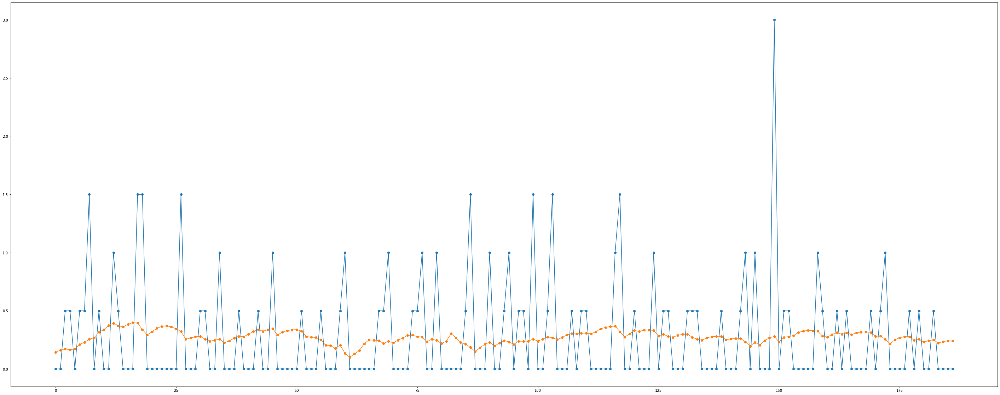

============================model:29===========================


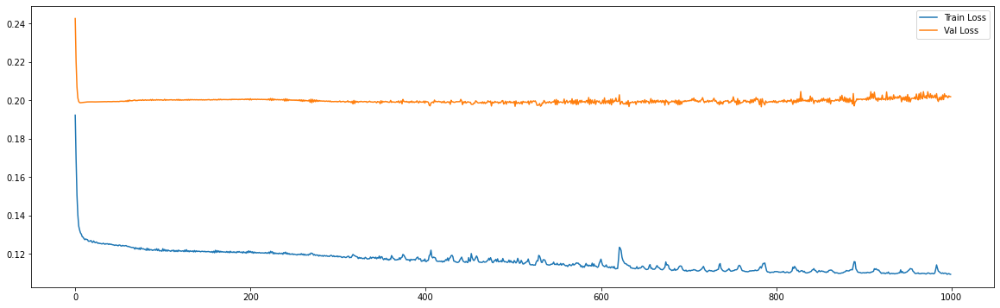

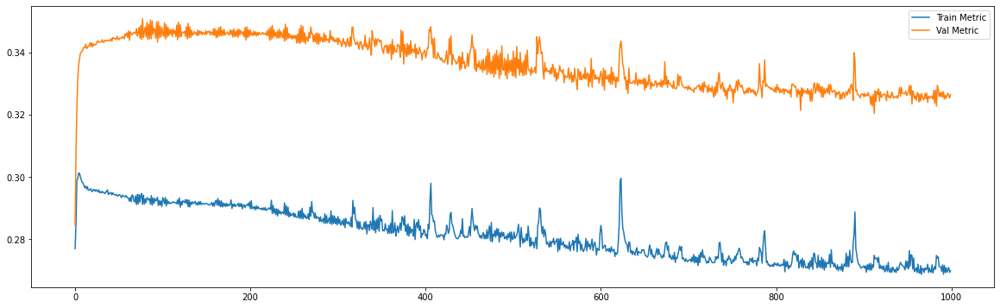

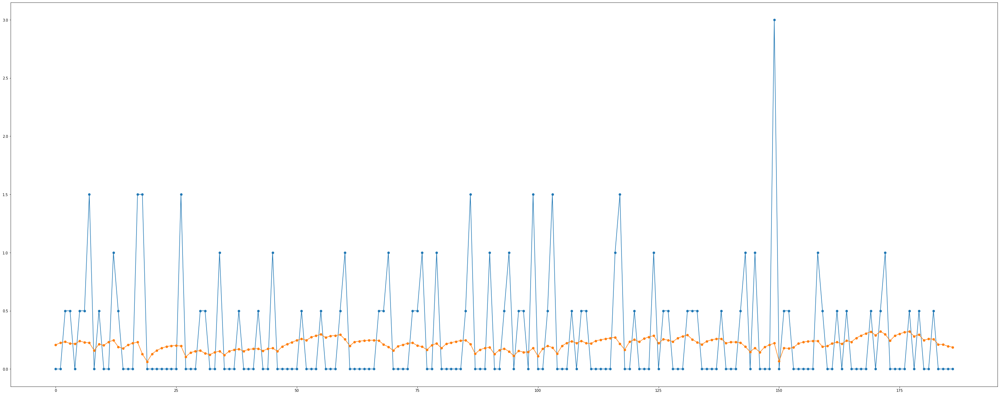

============================model:30===========================


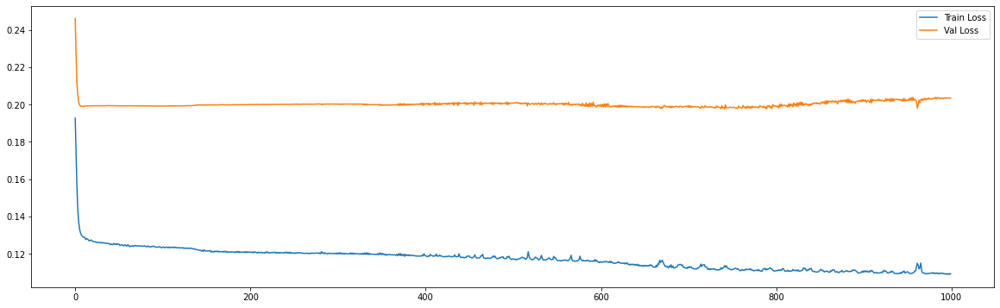

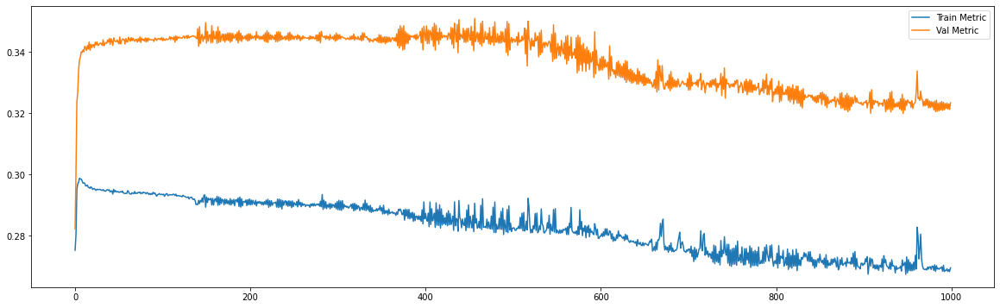

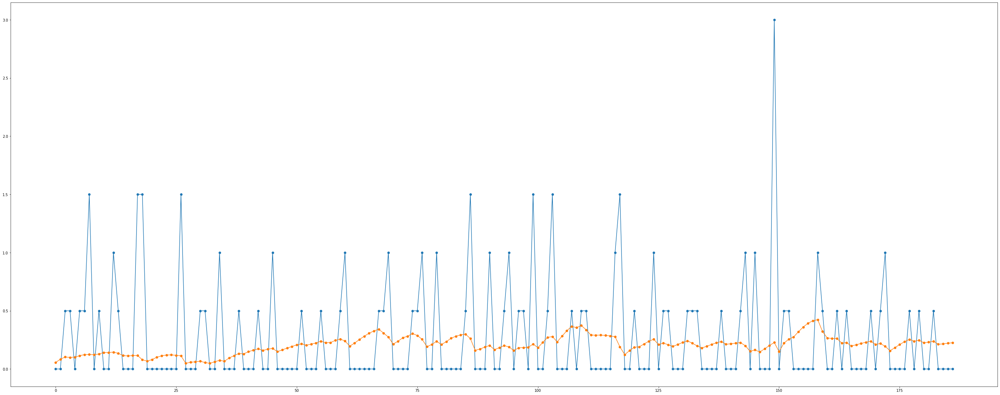

============================model:31===========================


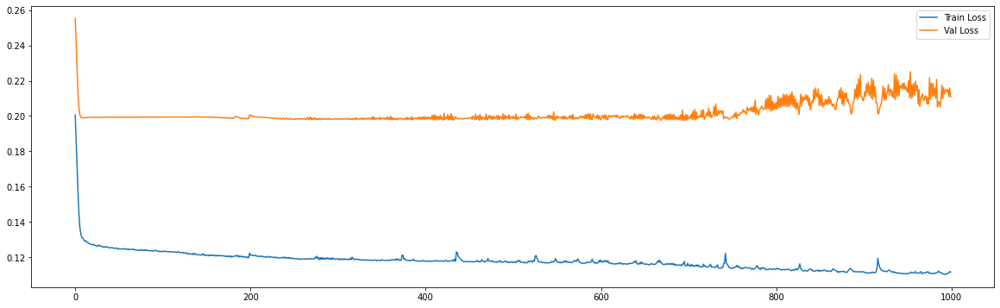

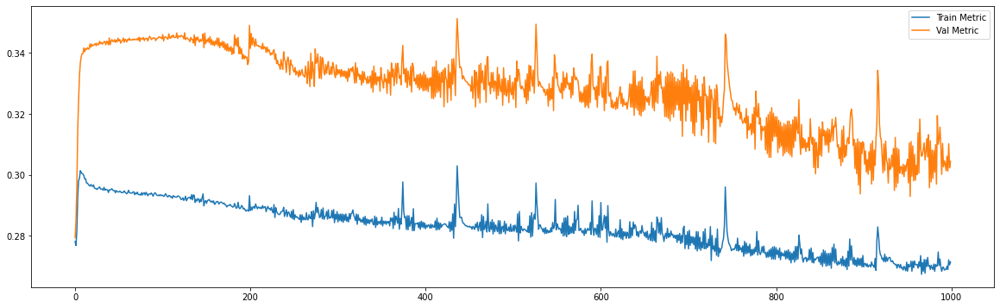

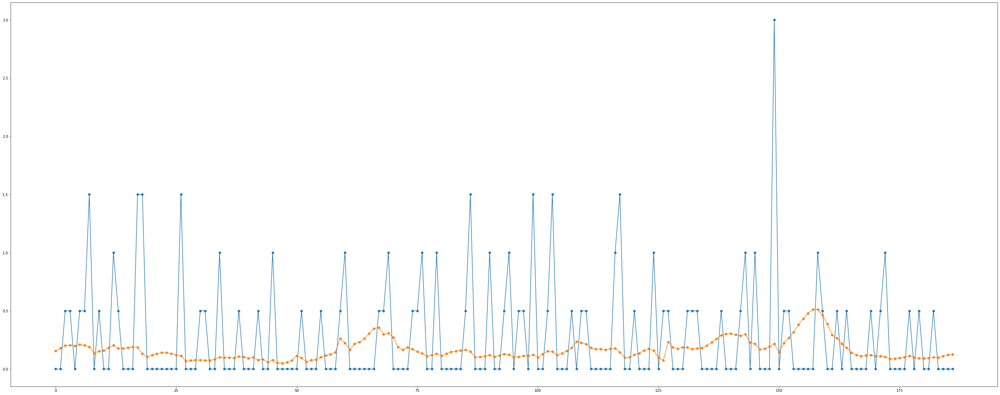

============================model:32===========================


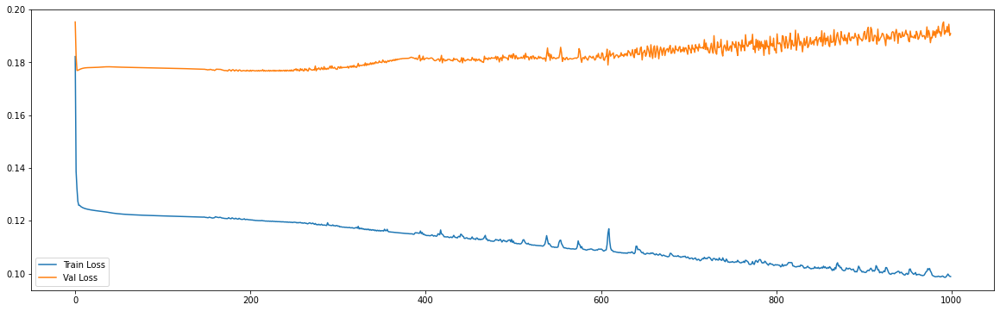

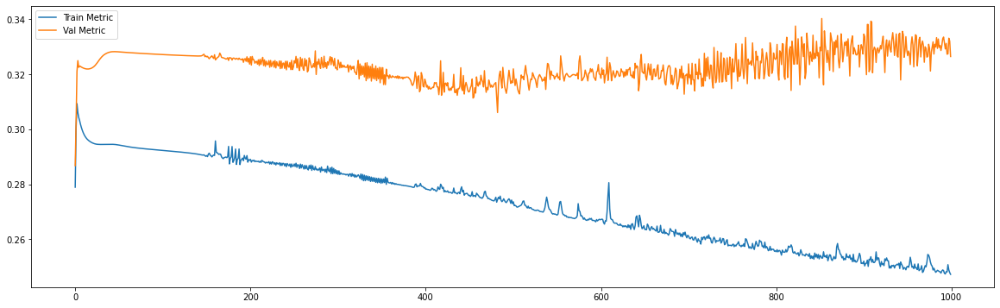

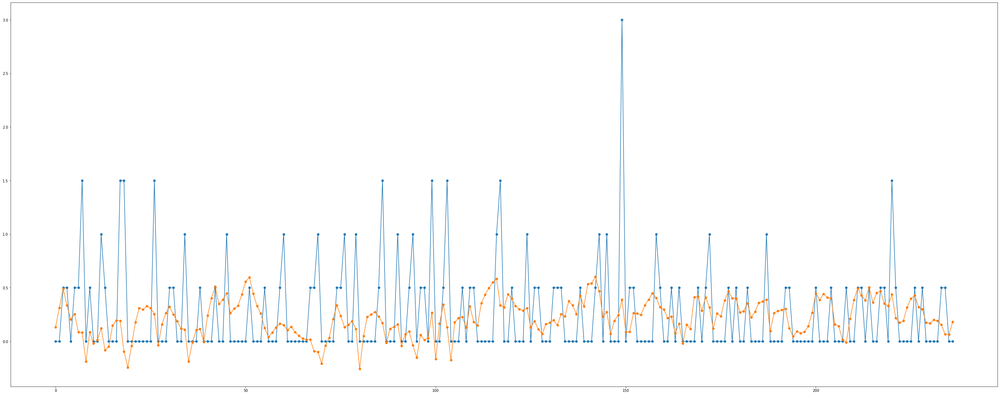

============================model:33===========================


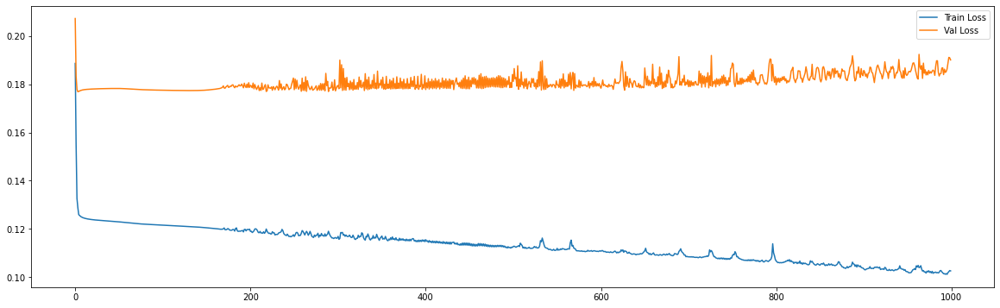

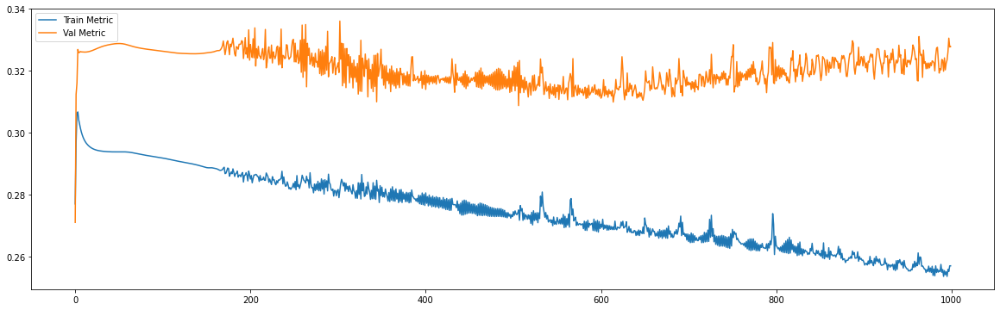

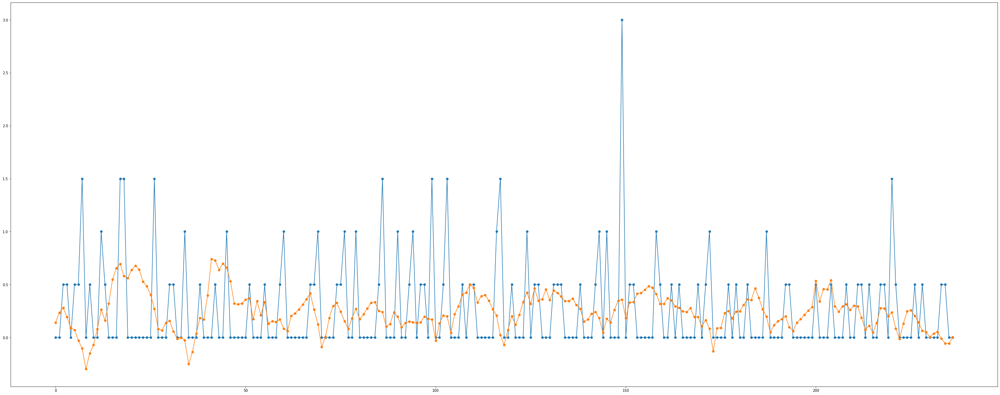

============================model:34===========================


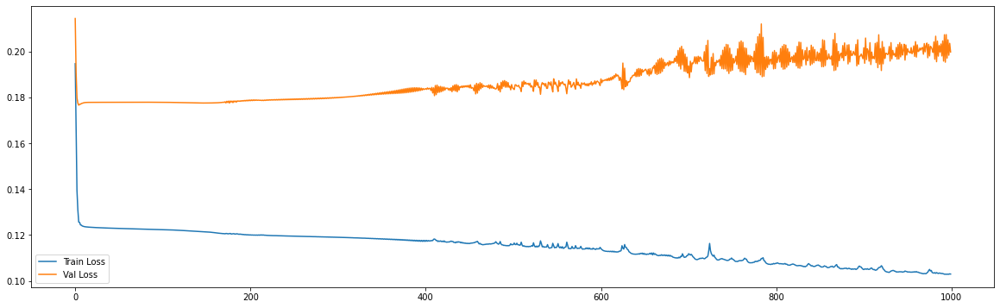

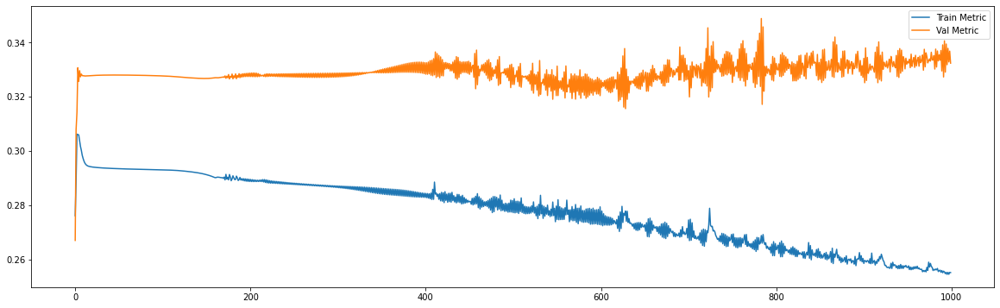

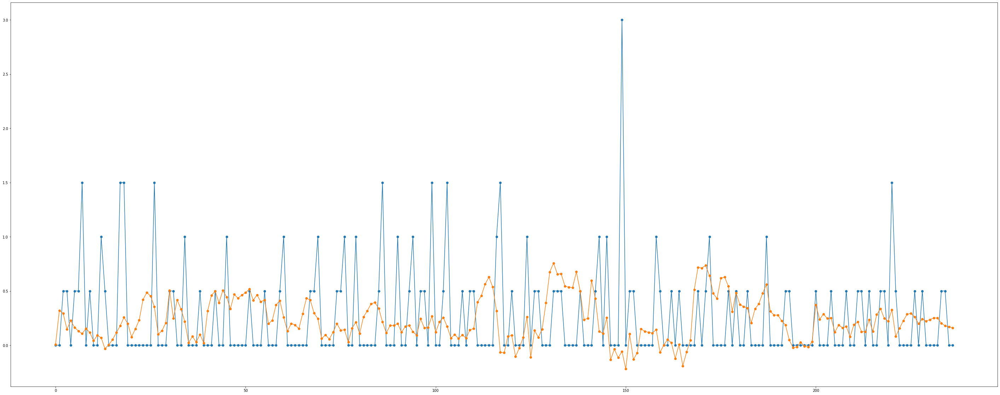

============================model:35===========================


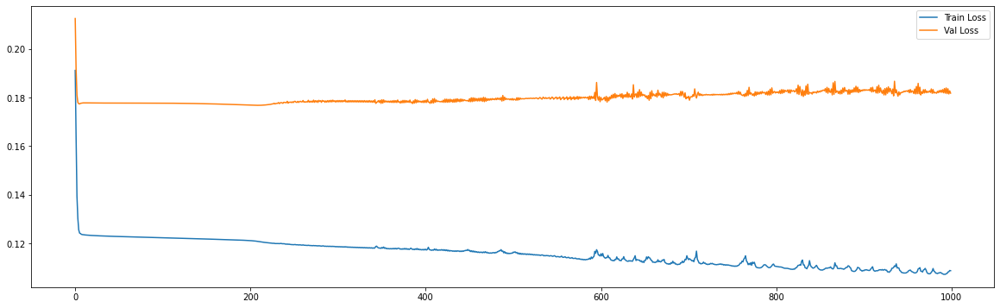

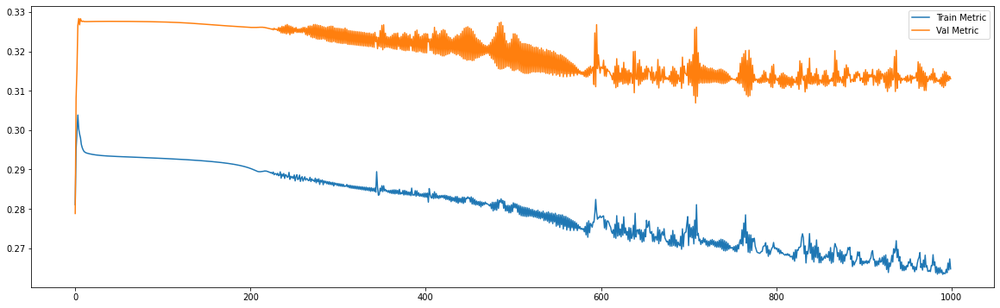

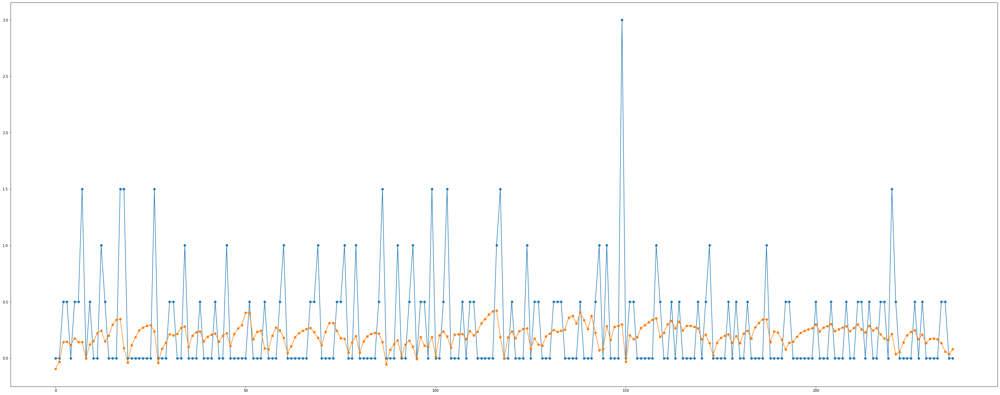

============================model:36===========================


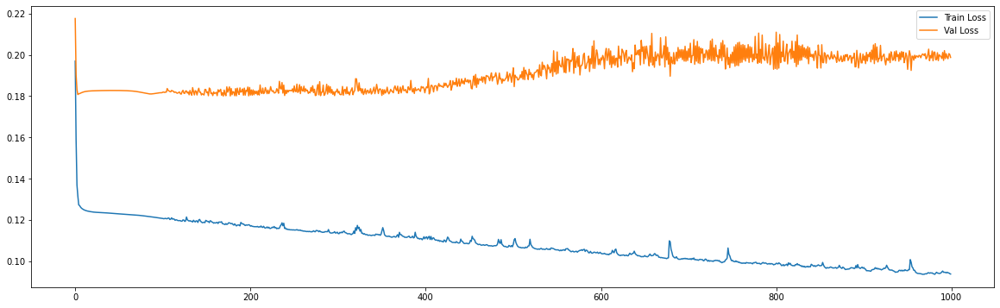

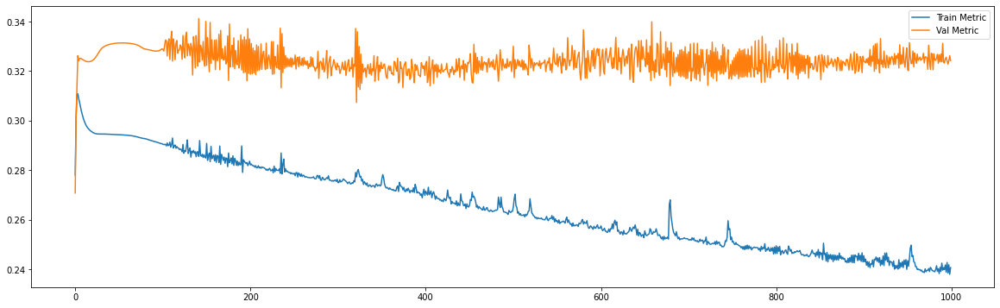

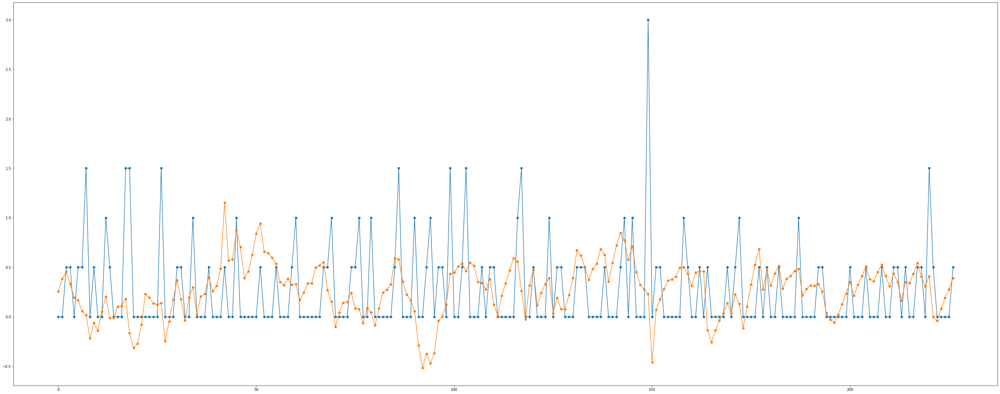

============================model:37===========================


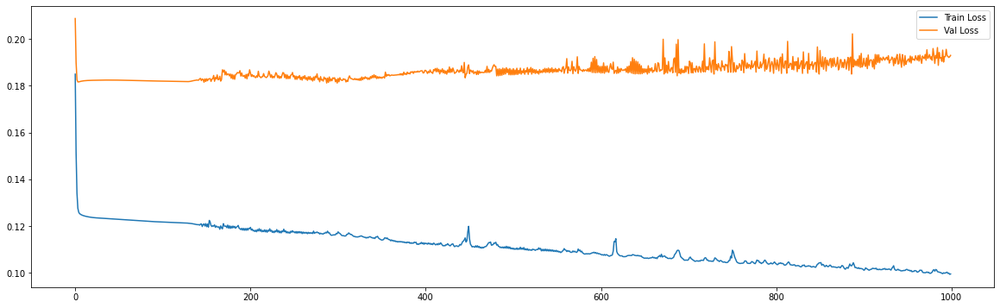

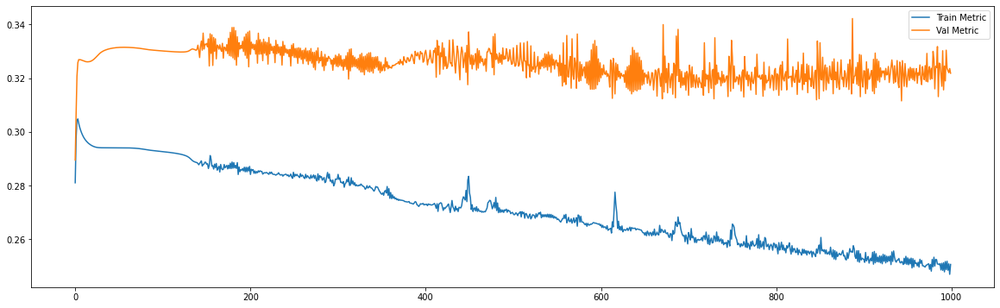

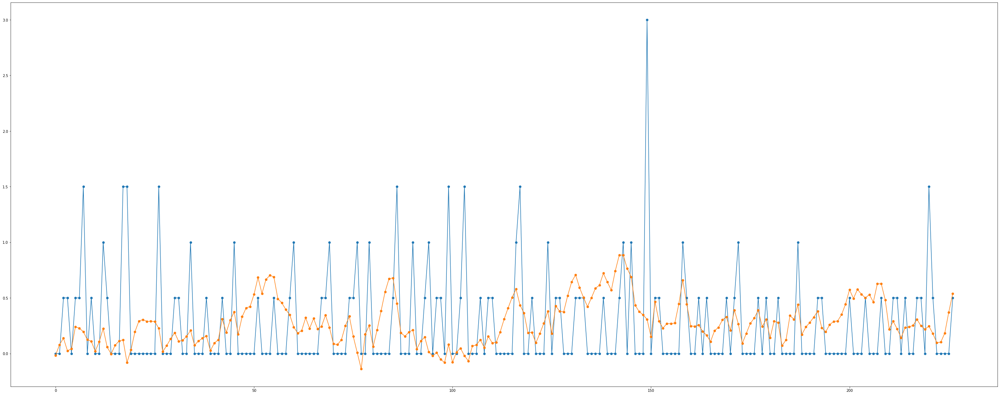

============================model:38===========================


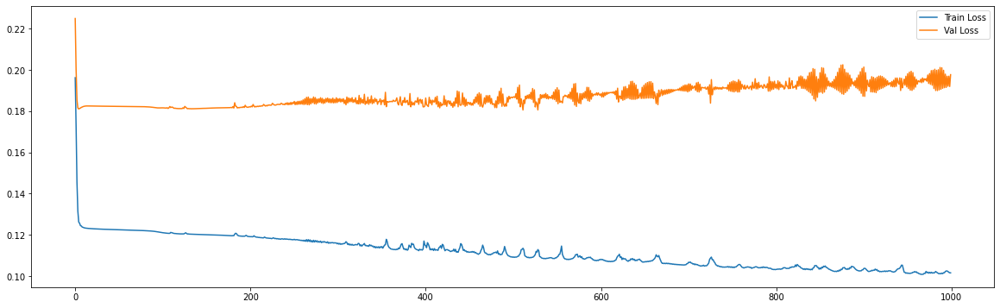

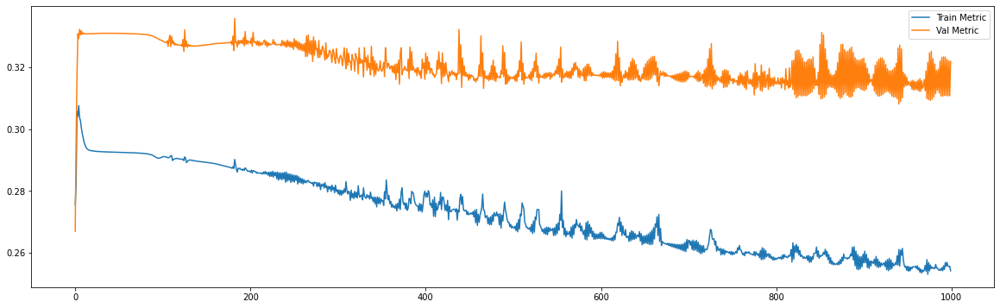

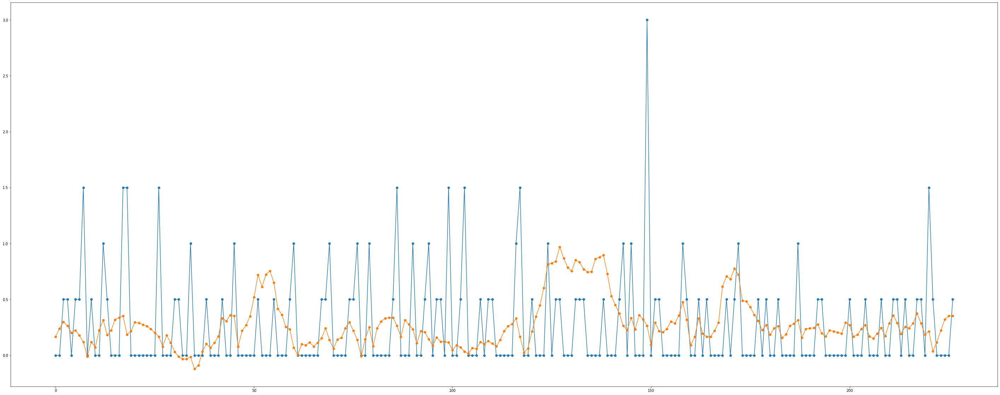

============================model:39===========================


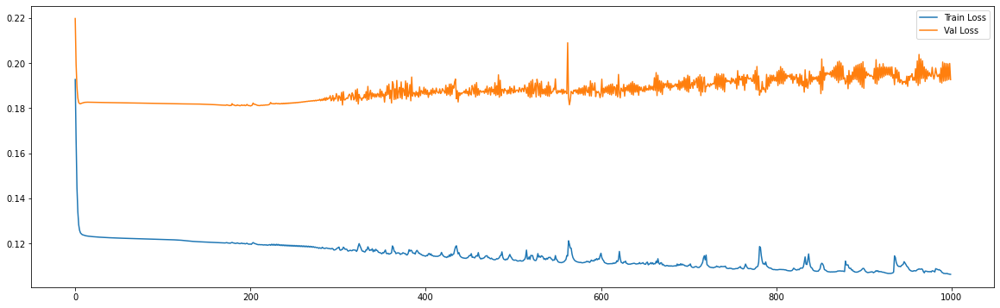

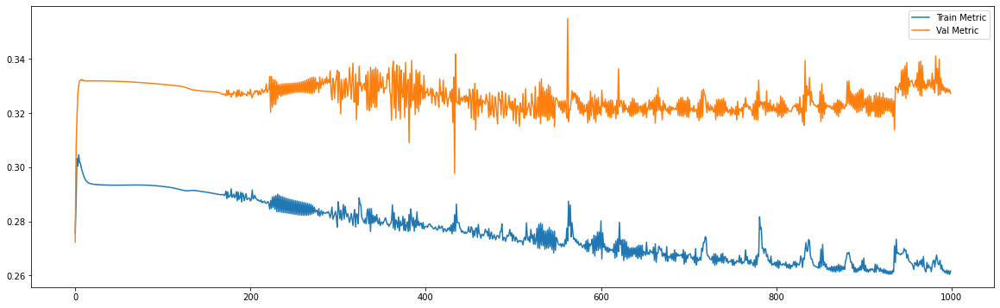

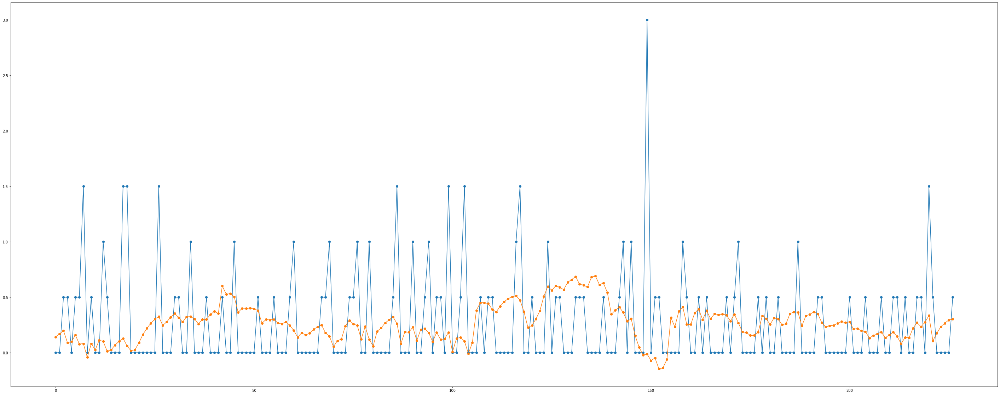

============================model:40===========================


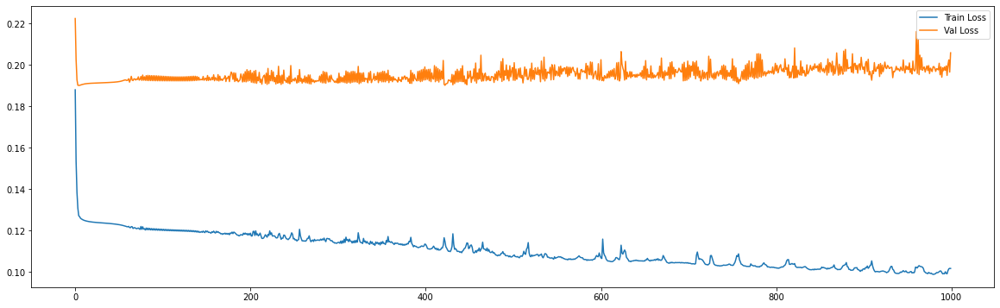

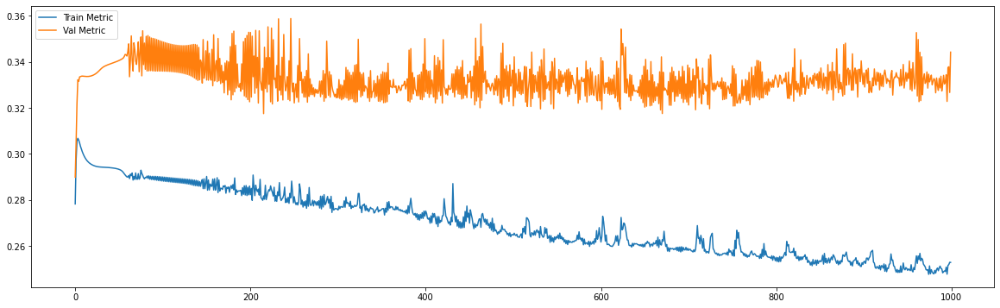

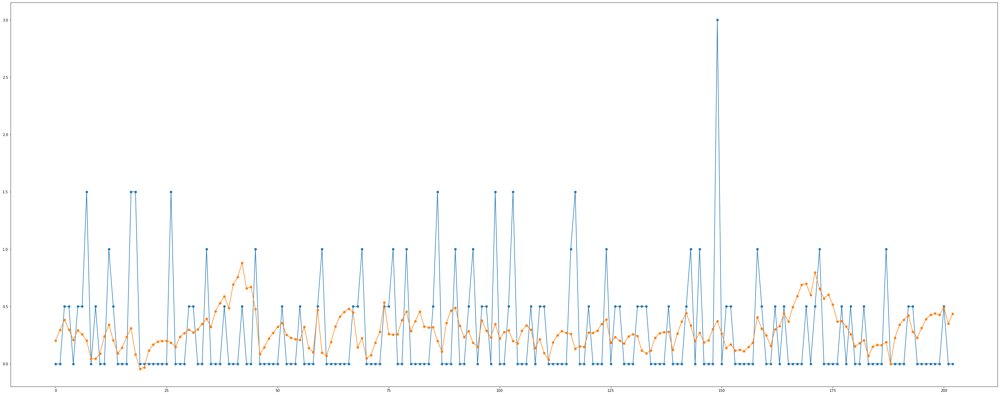

In [0]:
future_steps = 28
n_features = 1

neurons_list = [20,30,40,50]
dropout_list = [0.0,0.2]
time_steps_list = [50,60,84,100]
bach_list = [32,50,60,84,100]
models = {}
i=0
for neurons in neurons_list:
  for dropout in dropout_list:
    for time_steps in time_steps_list:
      for batch in bach_list:
        x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = time_steps,n_features = n_features,df_train = df_food_train,df_val = df_food_val,df_test = df_food_test)

        models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':batch}
        models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,batch,1)

        # The LSTM architecture
        models[i] = Sequential()
        models[i].add(LSTM(units=neurons, return_sequences=False,input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
        models[i].add(Dropout(dropout))
        models[i].add(Dense(units=28))

        #Compiling the LSTM
        adam = optimizers.Adam(lr = 0.001, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
        models[i].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

        #Fitting to traning set
        history = models[i].fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 1000, batch_size=batch, verbose = 0, shuffle= False)

        print('============================model:{}==========================='.format(i))

        
        print('loss and metric train data',models[i].evaluate(x_train,y_train))
        print('loss and metric val data',models[i].evaluate(x_val,y_val))
        print('loss and metric test data',models[i].evaluate(x_test,y_test))
        print('\n')

        print(models[i]['resumo'])
        print('\n')

        plt.figure(figsize=(20,6))
        plt.plot(history.history['loss'])
        plt.plot(history.history['val_loss'])
        plt.legend(['Train Loss', 'Val Loss'])

        plt.figure(figsize=(20,6))
        plt.plot(history.history['mae'])
        plt.plot(history.history['val_mae'])
        plt.legend(['Train Metric', 'Val Metric'])
        plt.show()

        y_val_pred = models[i].predict(x_val)
        plt.figure(figsize=(50,20))
        plt.plot(y_val[:,0],marker='o')
        plt.plot(y_val_pred[:,0],marker='o')
        plt.show()
        i+=1


        models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':batch}
        models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,batch,2)

        # The LSTM architecture
        models[i] = Sequential()
        models[i].add(LSTM(units=neurons, return_sequences=True,input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
        models[i].add(Dropout(dropout))
        models[i].add(LSTM(units=neurons, return_sequences=False))
        models[i].add(Dropout(dropout))
        models[i].add(Dense(units=28))

        #Compiling the LSTM
        adam = optimizers.Adam(lr = 0.001, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
        models[i].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

        #Fitting to traning set
        history = models[i].fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 1000, batch_size=batch, verbose = 0, shuffle= False)

        print('============================model:{}==========================='.format(i))

        
        print('loss and metric train data',models[i].evaluate(x_train,y_train))
        print('loss and metric val data',models[i].evaluate(x_val,y_val))
        print('loss and metric test data',models[i].evaluate(x_test,y_test))
        print('\n')

        print(models[i]['resumo'])
        print('\n')

        plt.figure(figsize=(20,6))
        plt.plot(history.history['loss'])
        plt.plot(history.history['val_loss'])
        plt.legend(['Train Loss', 'Val Loss'])

        plt.figure(figsize=(20,6))
        plt.plot(history.history['mae'])
        plt.plot(history.history['val_mae'])
        plt.legend(['Train Metric', 'Val Metric'])
        plt.show()

        y_val_pred = models[i].predict(x_val)
        plt.figure(figsize=(50,20))
        plt.plot(y_val[:,0],marker='o')
        plt.plot(y_val_pred[:,0],marker='o')
        plt.show()

        i+=1

# Adding more Features

---

The performance of the models not good enhough, so let's try to use the informations of the calendar.csv and sell_prices.csv as nwe features for te models

In [0]:
# Contains information about the dates the products are sold.
df_calendar = pd.read_csv('/content/drive/My Drive/Specialization/Projects/Recurrent Neural Networks/M5 - Data/calendar.csv')

# Contains information about the price of the products sold per store and date.
df_price = pd.read_csv('/content/drive/My Drive/Specialization/Projects/Recurrent Neural Networks/M5 - Data/sell_prices.csv')

#Contains the historical daily unit sales data per product and store.
df_sales = pd.read_csv('/content/drive/My Drive/Specialization/Projects/Recurrent Neural Networks/M5 - Data/sales_train_validation.csv')

## Join DataFrames informations

In [4]:
# Take de first food product from WI
group = df_sales.groupby(['state_id','cat_id']).first()
df_food =  group.loc[('WI','FOODS'),:]
df_food =  pd.DataFrame(group.loc[('WI','FOODS'),'d_1':].reset_index().values,columns= ['d','WI_FOODS'])
df_food.set_index('d',inplace = True)

# Taking the respective price
df_food_price = df_price[(df_price['store_id'] == 'WI_1') & (df_price['item_id'] == 'FOODS_1_001')].reset_index(drop = True)

# Join the price with the calendar. So now i have the price, events and snap
df_calendar_food = df_calendar.set_index('wm_yr_wk').join(df_food_price.set_index('wm_yr_wk')).reset_index()
df_calendar_food['event_name_1'].fillna(0,inplace = True)
df_calendar_food.loc[df_calendar_food['event_name_1'][df_calendar_food['event_name_1'] != 0].index,'event_name_1'] = 1
df_calendar_food['event_name_2'].fillna(0,inplace = True)
df_calendar_food.loc[df_calendar_food['event_name_2'][df_calendar_food['event_name_2'] != 0].index,'event_name_2'] = 1
df_calendar_food = df_calendar_food[['d','event_name_1','event_name_2','snap_WI','sell_price']]
df_calendar_food.set_index('d',inplace = True)

# Join with the df_food. So now I have the 5 variables.
df_final = df_calendar_food.join(df_food, on='d')
df_final.drop(df_final[df_final['WI_FOODS'].isna()].index,axis = 0,inplace = True)
df_final

,event_name_1,event_name_2,snap_WI,sell_price,WI_FOODS
d,,,,,
d_1,0,0,0,2.00,0
d_2,0,0,0,2.00,2
d_3,0,0,0,2.00,0
d_4,0,0,0,2.00,1
d_5,0,0,1,2.00,0
...,...,...,...,...,...
d_1909,0,0,0,2.24,0
d_1910,0,0,0,2.24,0
d_1911,0,0,0,2.24,0


## Spliting Data

In [0]:
df_final = df_final.values

train_limit = int(round((df_final.shape[0])*0.7,0))
val_limit = int(round((df_final.shape[0])*0.85,0))

df_train = df_final[:train_limit]
df_val = df_final[train_limit:val_limit]
df_test = df_final[val_limit:]

## Improving Regressor method

---

The previously developed method doesn't support more than one feature, so some changes are required


In [0]:
def Regressor(future_steps,time_steps,n_features,df_train,df_val,df_test):
  # future_steps: how many days in the furure to predict 
  # time_steps: number of samples the LSTM model will use for predict 28 days in the future
  # n_features: number of features (LSTM input) 

  #################### TRAIN #################################################
  # Defining the number of samples for the train data
  n_samples = df_train.shape[0]
  x_train = []
  y_train = []

  # shaping data to have the number of time_steps in the x_train ans the 28 future values in the y_train 
  for i in range(time_steps,n_samples - time_steps): 
    x_train.append(df_train[i - time_steps : i, :]) #the change is heare, now it's possible to use it for any quantity of features
    y_train.append(df_train[i : i+future_steps,-1]) #the change is heare, now it's possible to use it for any quantity of features

  x_train,y_train = np.array(x_train),np.array(y_train) # transforming in array
  # LSTM need 3D tensor as input 
  x_train = np.reshape(x_train,(x_train.shape[0],x_train.shape[1],n_features))  

  ##################### VALIDATION ###############################################

  # to predict the first 28 values of the validation data, LSTM need time_steps values. 
  # to make this possible I'm using the last 60 values that came before the validation data.
  df_val = np.concatenate((df_train[-time_steps:],df_val))

  n_samples = df_val.shape[0]
  x_val = []
  y_val = []

  for i in range(time_steps,n_samples - time_steps):
    x_val.append(df_val[i - time_steps : i, :]) #the change is heare, now it's possible to use it for any quantity of features
    y_val.append(df_val[i : i+future_steps,-1]) #the change is heare, now it's possible to use it for any quantity of features

  x_val,y_val = np.array(x_val),np.array(y_val)
  x_val = np.reshape(x_val,(x_val.shape[0],x_val.shape[1],n_features))

  ####################### TEST ################################################
  # the same methodologie implemented in training and validation data are here in the test data

  df_test = np.concatenate((df_val[-time_steps:],df_test))
  n_samples = df_test.shape[0]
  x_test = []
  y_test = []

  for i in range(time_steps,n_samples - time_steps):
    x_test.append(df_test[i - time_steps : i, :]) #the change is heare, now it's possible to use it for any quantity of features
    y_test.append(df_test[i : i+future_steps,-1]) #the change is heare, now it's possible to use it for any quantity of features

  x_test,y_test = np.array(x_test),np.array(y_test)
  x_test = np.reshape(x_test,(x_test.shape[0],x_test.shape[1],n_features))

  x_train = x_train.astype(np.float32)
  y_train = y_train.astype(np.float32)

  x_val = x_val.astype(np.float32)
  y_val = y_val.astype(np.float32)

  x_test = x_test.astype(np.float32)
  y_test = y_test.astype(np.float32)
  
  return x_train,x_test,x_val,y_train,y_val,y_test

## Normalizing

In [0]:
# scaler_food = MinMaxScaler(feature_range=(0,1))
# df_train = scaler_food.fit_transform(df_train)
# df_val = scaler_food.transform(df_val)
# df_test = scaler_food.transform(df_test)

data_list = [df_train.copy(),df_val.copy(),df_test.copy()]

min_list = df_train.min(axis=0)
max_list = df_train.max(axis=0)
for j in range(3):
  for i in range(df_train.shape[1]):
    data_list[j][:,i] = (data_list[j][:,i]-min_list[i])/abs((min_list[i]-max_list[i]))

df_train_norm = data_list[0].copy()
df_val_norm = data_list[1].copy()
df_test_norm = data_list[2].copy()


In [8]:
print(df_train_norm.max(axis=0))
print(df_train_norm.min(axis=0))
print('\n')

print(df_val_norm.max(axis=0))
print(df_val_norm.min(axis=0))
print('\n')

print(df_test_norm.max(axis=0))
print(df_test_norm.min(axis=0))
print('\n')

[1.0 1.0 1.0 1.0 1.0]
[0.0 0.0 0.0 0.0 0.0]


[1.0 0.0 1.0 1.0 0.8571428571428571]
[0.0 0.0 0.0 1.0 0.0]


[1.0 0.0 1.0 1.0 1.1428571428571428]
[0.0 0.0 0.0 1.0 0.0]




## LSTM

In [9]:
future_steps = 28
n_features = 5
time_steps = 60

x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = time_steps,n_features = n_features,
                                                      df_train = df_train_norm,df_val = df_val_norm,df_test = df_test_norm)

print('Train data shape = {}'.format(x_train.shape))
print('Val data shape = {}'.format(x_val.shape))
print('Test data shape = {}'.format(x_test.shape))

Train data shape = (1219, 60, 5)
Val data shape = (227, 60, 5)
Test data shape = (227, 60, 5)


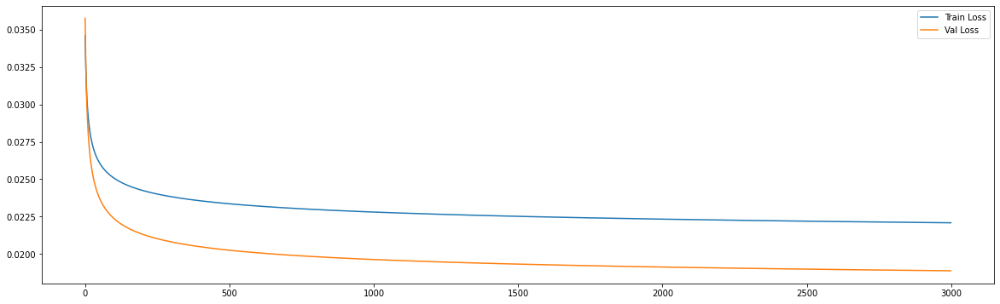

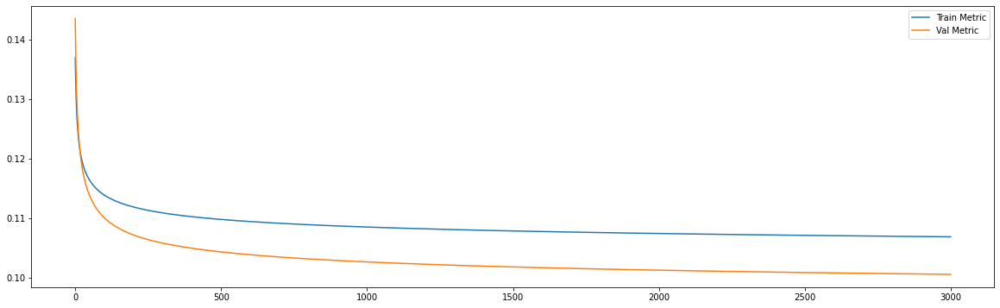



39/39 [==============================] - 0s 5ms/step - loss: 0.0221 - mae: 0.1068
loss and metric train data [0.022087300196290016, 0.1068272739648819]
8/8 [==============================] - 0s 4ms/step - loss: 0.0189 - mae: 0.1005
loss and metric val data [0.01887843757867813, 0.10052245110273361]
8/8 [==============================] - 0s 5ms/step - loss: 0.0145 - mae: 0.0934
loss and metric test data [0.014536827802658081, 0.09344016760587692]


In [10]:
regressor = Sequential()
regressor.add(LSTM(units=20, return_sequences=False, input_shape=(time_steps, n_features))) # return_sequences=False next layer is not LSTM
regressor.add(Dense(units=future_steps))

#Compiling the LSTM
mom = optimizers.SGD(lr=0.001, decay=1e-02, momentum=0.9,nesterov=True)
# adam = optimizers.Adam(lr = 0.001, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
# sgd = optimizers.SGD(lr=0.001, decay=1e-02, momentum=0.9,nesterov=True)
regressor.compile(optimizer = mom, loss = 'mse', metrics=['mae'])

#Fitting to traning set
history = regressor.fit(x_train, y_train, validation_data=(x_val,y_val), 
                        epochs = 3000, batch_size=60, verbose = 0, shuffle= False)

plt.figure(figsize=(20,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['Train Loss', 'Val Loss'])

plt.figure(figsize=(20,6))
plt.plot(history.history['mae'])
plt.plot(history.history['val_mae'])
plt.legend(['Train Metric', 'Val Metric'])
plt.show()

print('\n')
print('loss and metric train data',regressor.evaluate(x_train,y_train))
print('loss and metric val data',regressor.evaluate(x_val,y_val))
print('loss and metric test data',regressor.evaluate(x_test,y_test))

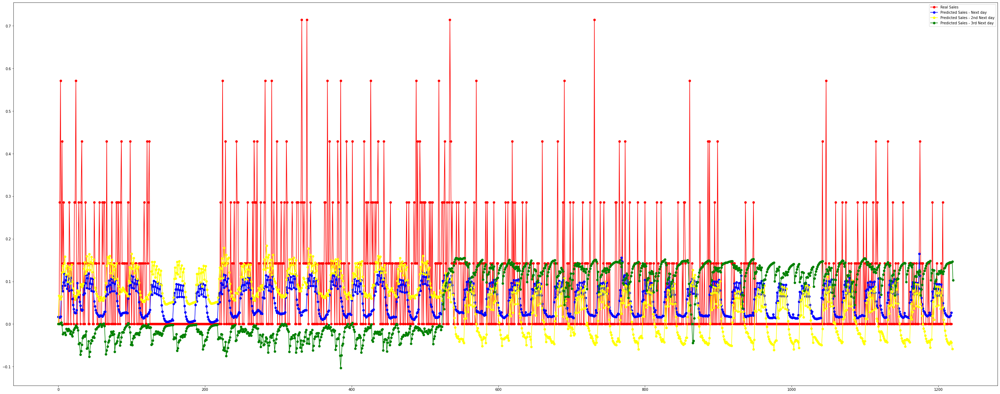

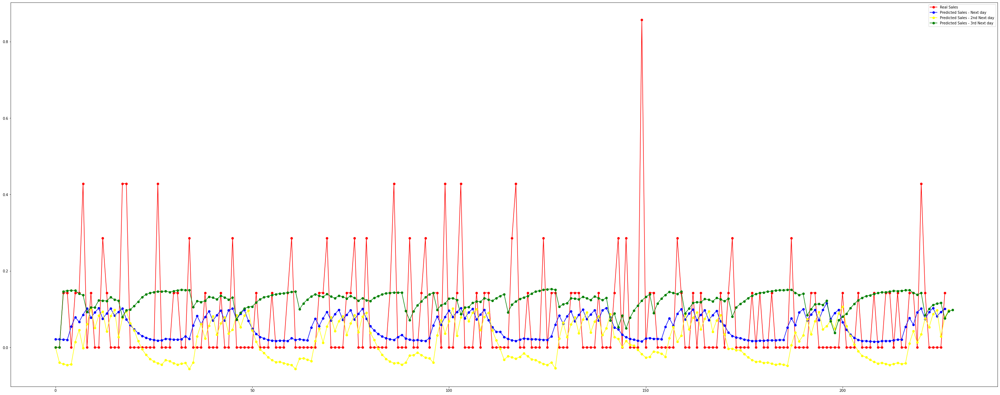

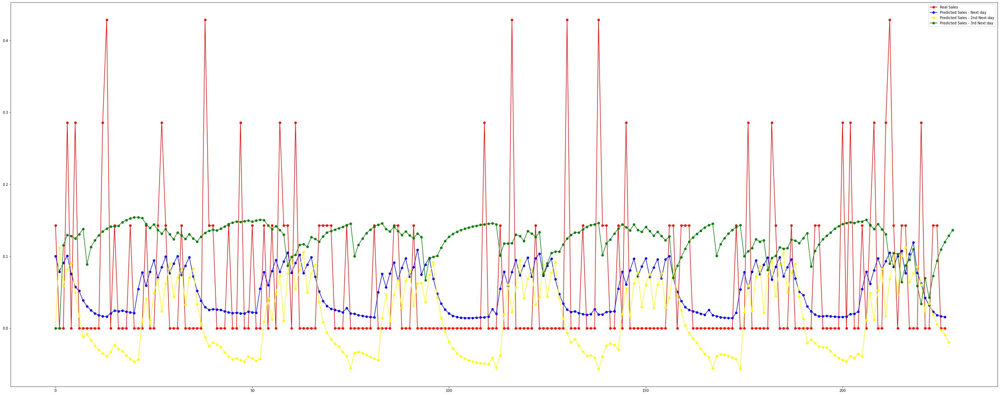

In [11]:
y_train_pred = regressor.predict(x_train)
y_val_pred = regressor.predict(x_val)
y_test_pred = regressor.predict(x_test)

plt.figure(figsize=(50,20))
plt.plot(y_train[:,0],marker='o',color='red',label='Real Sales')
plt.plot(y_train_pred[:, 0],marker='o', color='blue',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([0],y_train_pred[:, 1])),marker='o', color='yellow',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([0,0],y_train_pred[:, 2])),marker='o', color='green',label='Predicted Sales - 3rd Next day')
plt.legend()
plt.show()

plt.figure(figsize=(50,20))
plt.plot(y_val[:,0],marker='o',color='red',label='Real Sales')
plt.plot(y_val_pred[:, 0],marker='o', color='blue',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([0],y_val_pred[:, 1])),marker='o', color='yellow',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([0,0],y_val_pred[:, 2])),marker='o', color='green',label='Predicted Sales - 3rd Next day')
plt.legend()
plt.show()

plt.figure(figsize=(50,20))
plt.plot(y_test[:,0],marker='o',color='red',label='Real Sales')
plt.plot(y_test_pred[:, 0],marker='o', color='blue',label='Predicted Sales - Next day')
plt.plot(np.concatenate(([0],y_test_pred[:, 1])),marker='o', color='yellow',label='Predicted Sales - 2nd Next day')
plt.plot(np.concatenate(([0,0],y_test_pred[:, 2])),marker='o', color='green',label='Predicted Sales - 3rd Next day')
plt.legend()
plt.show()

In [12]:
x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = time_steps,n_features = n_features,df_train = df_train,
                                                      df_val = df_val,df_test = df_test)

print('loss and metric train data',regressor.evaluate(x_train,y_train))
print('loss and metric val data',regressor.evaluate(x_val,y_val))
print('loss and metric test data',regressor.evaluate(x_test,y_test))

39/39 [==============================] - 0s 5ms/step - loss: 1.0537 - mae: 0.6419
loss and metric train data [1.053654432296753, 0.6418548822402954]
8/8 [==============================] - 0s 4ms/step - loss: 0.8915 - mae: 0.5710
loss and metric val data [0.891457200050354, 0.5709859728813171]
8/8 [==============================] - 0s 5ms/step - loss: 0.6271 - mae: 0.4902
loss and metric test data [0.627142071723938, 0.4902130663394928]


In [0]:
# future_steps = 28
# n_features = 5

# neurons_list = [20,30,40,50]
# dropout_list = [0.2,0.4]
# time_steps_list = [50,60,84,100]
# bach_list = [32,50,60,84,100]
# lr_list = [0.001,0.0001]
# models = {}
# i=0
# for neurons in neurons_list:
#   for dropout in dropout_list:
#     for time_steps in time_steps_list:
#       for batch in bach_list:
#         for lr in lr_list:
#           x_train,x_test,x_val,y_train,y_val,y_test = Regressor(future_steps = future_steps,time_steps = time_steps,n_features = n_features,df_train = df_train,df_val = df_val,df_test = df_test)

#           models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':batch, 'learning_rate':lr}
#           models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'learning_rate':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,batch,lr,1)

#           # The LSTM architecture
#           models[i]['model'] = Sequential()
#           models[i]['model'].add(LSTM(units=neurons, return_sequences=False,input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
#           models[i]['model'].add(Dropout(dropout))
#           models[i]['model'].add(Dense(units=28))

#           #Compiling the LSTM
#           adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
#           models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

#           #Fitting to traning set
#           history = models[i]['model'].fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 500, batch_size=batch, verbose = 0, shuffle= False)

#           print('============================model:{}==========================='.format(i))

          
#           print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
#           print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
#           print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
#           print('\n')

#           print(models[i]['resumo'])
#           print('\n')

#           plt.figure(figsize=(20,6))
#           plt.plot(history.history['loss'])
#           plt.plot(history.history['val_loss'])
#           plt.legend(['Train Loss', 'Val Loss'])

#           plt.figure(figsize=(20,6))
#           plt.plot(history.history['mae'])
#           plt.plot(history.history['val_mae'])
#           plt.legend(['Train Metric', 'Val Metric'])
#           plt.show()

#           y_val_pred = models[i]['model'].predict(x_val)
#           plt.figure(figsize=(50,20))
#           plt.plot(y_val[:,0],marker='o')
#           plt.plot(y_val_pred[:,0],marker='o')
#           plt.show()
#           i+=1


#           models[i] = {'neurons':neurons,'dropout':dropout,'time_steps': time_steps, 'batch_size':batch}
#           models[i]['resumo'] = "'neurons': {}, 'dropout': {}, 'time_steps': {}, 'batch_size':{}, 'hidden_layers':{}".format(neurons,dropout,time_steps,batch,2)

#           # The LSTM architecture
#           models[i]['model'] = Sequential()
#           models[i]['model'].add(LSTM(units=neurons, return_sequences=True,input_shape=(time_steps, n_features))) # return_sequences=True next layer is LSTM
#           models[i]['model'].add(Dropout(dropout))
#           models[i]['model'].add(LSTM(units=neurons, return_sequences=False))
#           models[i]['model'].add(Dropout(dropout))
#           models[i]['model'].add(Dense(units=28))

#           #Compiling the LSTM
#           adam = optimizers.Adam(lr = lr, beta_1 = 0.9, beta_2 = 0.999, decay = 0.0)
#           models[i]['model'].compile(optimizer = adam, loss = 'mse', metrics=['mae'])

#           #Fitting to traning set
#           history = models[i]['model'].fit(x_train, y_train, validation_data=(x_val,y_val), epochs = 500, batch_size=batch, verbose = 0, shuffle= False)

#           print('============================model:{}==========================='.format(i))

          
#           print('loss and metric train data',models[i]['model'].evaluate(x_train,y_train))
#           print('loss and metric val data',models[i]['model'].evaluate(x_val,y_val))
#           print('loss and metric test data',models[i]['model'].evaluate(x_test,y_test))
#           print('\n')

#           print(models[i]['resumo'])
#           print('\n')

#           plt.figure(figsize=(20,6))
#           plt.plot(history.history['loss'])
#           plt.plot(history.history['val_loss'])
#           plt.legend(['Train Loss', 'Val Loss'])

#           plt.figure(figsize=(20,6))
#           plt.plot(history.history['mae'])
#           plt.plot(history.history['val_mae'])
#           plt.legend(['Train Metric', 'Val Metric'])
#           plt.show()

#           y_val_pred = models[i]['model'].predict(x_val)
#           plt.figure(figsize=(50,20))
#           plt.plot(y_val[:,0],marker='o')
#           plt.plot(y_val_pred[:,0],marker='o')
#           plt.show()

#           i+=1